# Analysis & Visualization

In [1]:
# Import Packages

%load_ext autoreload
%autoreload 2

import os
import warnings 
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
from skimage.filters import threshold_otsu, gaussian
from skimage.morphology import remove_small_objects
from matplotlib.colors import ListedColormap
from anndata import AnnData, concat
from statannot import add_stat_annotation

# Customized packages
from starmap.utilities import *
from starmap.sequencing import *
from starmap.obj import STARMapDataset, load_data
# import starmap.analyze as anz
# import starmap.viz as viz
import starmap.sc_util as su

# test()

In [2]:
from statannotations.Annotator import Annotator

In [3]:
# Get functions 

import colorsys
from random import shuffle

def intervals(parts, start_point, end_point):
    duration = end_point - start_point
    part_duration = duration / parts
    return [((i * part_duration + (i + 1) * part_duration)/2) + start_point for i in range(parts)]

In [4]:
def change_width(ax, new_value) :
    for patch in ax.patches :
        current_width = patch.get_width()
        diff = current_width - new_value

        # we change the bar width
        patch.set_width(new_value)

        # we recenter the bar
        patch.set_x(patch.get_x() + diff * .5)

## IO

In [5]:
# Set path
base_path = 'Z:/Data/Analyzed/2022-01-03-Hu-AD/'
out_path = os.path.join(base_path, 'output')
fig_path = os.path.join(base_path, 'figures')

out_path = os.path.join(base_path, 'output')
if not os.path.exists(out_path):
    os.mkdir(out_path)
    
fig_path = os.path.join(base_path, 'figures')
if not os.path.exists(fig_path):
    os.mkdir(fig_path)

In [6]:
sc.settings.figdir = fig_path
sc.set_figure_params(format='tif', dpi=150)

In [7]:
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

## Input

In [8]:
# Load new data
adata = sc.read_h5ad(os.path.join(out_path, '2022-04-06-Hu-AD-stardist-scaled.h5ad'))
adata

AnnData object with n_obs × n_vars = 72165 × 2766
    obs: 'orig_index', 'sample', 'area', 'x', 'y', 'tau', 'group', 'time', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'top_level', 'cell_type', 'seg_label', 'region', 'region_merged', 'time-group', 'replicate', 'type-replicate'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'max_counts', 'detected', 'highly_variable', 'n_cells', 'mean', 'std'
    uns: 'ADmouse_11346_morph', 'ADmouse_11351_morph', 'ADmouse_9494_morph', 'ADmouse_9498_morph', 'ADmouse_9707_morph', 'ADmouse_9723_2_morph', 'ADmouse_9723_morph', 'ADmouse_9735_morph', 'cell_type_hex_dict', 'cell_type_order', 'cell_type_rgb_dict', 'top_level_hex_dict', 'top_level_order', 'top_level_rgb_dict'
    layers: 'corrected', 'norm', 'raw', 'scaled'

In [ ]:
# combine time and group label
adata.obs['time-group'] = adata.obs['time'].astype(str) + '-' + adata.obs['group'].astype(str)
adata.obs['time-group'] = adata.obs['time-group'].astype('category')
adata.obs['time-group'] = adata.obs['time-group'].cat.reorder_categories(['8months-disease', '8months-control', '13months-disease', '13months-control'])

adata.obs['replicate'] = adata.obs['batch'].values
adata.obs['replicate'] = adata.obs['replicate'].replace({'batch_1': 'replicate_1', 'batch_2': 'replicate_1', 'batch_3': 'replicate_2', 'batch_4': 'replicate_2'})
adata.obs['replicate'] = adata.obs['replicate'].astype('category')
adata.obs['replicate'] = adata.obs['replicate'].cat.reorder_categories(['replicate_1', 'replicate_2'])

adata.obs['type-replicate'] = adata.obs['cell_type'].astype(str) + '-' + adata.obs['replicate'].astype(str)
adata.obs['type-replicate'] = adata.obs['type-replicate'].astype('category')

In [ ]:
# create region_merged
for i, sample in enumerate(adata.obs['sample'].cat.categories):
    current_region_img = adata.uns[f'{sample}_morph']['region'].copy()
    current_region_img[current_region_img == 4] = 3
    adata.uns[f'{sample}_morph']['region_merged'] = current_region_img

## Top-level

In [ ]:
# load saved top-level embedding
top_umap = np.genfromtxt(os.path.join(fig_path, 'embedding_top_level_umap.csv'), delimiter=',')
top_umap.shape

In [ ]:
# Run PCA
sc.tl.pca(adata, svd_solver='arpack', use_highly_variable=True)

# Plot explained variance 
sc.pl.pca_variance_ratio(adata, log=False)

### Embedding

In [ ]:
%%time
# Computing the neighborhood graph
n_neighbors = 50
n_pcs = 30 ## 30
min_dist = 0.05

sc.pp.neighbors(adata, n_neighbors=n_neighbors, n_pcs=n_pcs)

# Run UMAP
sc.tl.umap(adata, min_dist=min_dist)

In [ ]:
# Plot single meta UMAP
sc.pl.umap(adata, color='sample')
sc.pl.umap(adata, color='total_counts')
sc.pl.umap(adata, color='n_genes')

In [ ]:
# save embeddings
np.savetxt(f'{fig_path}/embedding_top_level_umap.csv', adata.obsm['X_umap'], delimiter=",")

In [ ]:
# Check color legend
top_cpl = []
for i in adata.uns['top_level_order']:
    top_cpl.append(adata.uns['top_level_rgb_dict'][i])

top_cpl = sns.color_palette(top_cpl)
top_cmap = ListedColormap(top_cpl.as_hex())
sns.palplot(top_cpl, size=3)
plt.xticks(range(len(adata.uns['top_level_order'])), adata.uns['top_level_order'], size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'{fig_path}/color_legend_top.tif')
plt.show()

In [ ]:
# Plot UMAP with cluster labels w/ new color
sc.pl.umap(adata, color='top_level', frameon=False, 
           palette=top_cpl, save=False)

# Plot UMAP with cluster labels w/ new color
sc.pl.umap(adata, color='top_level', legend_loc='on data',
           legend_fontsize=8, legend_fontoutline=2, frameon=False, 
           palette=top_cpl, save=False)

# # Plot sample wise UMAP with top-level labels 
# for sample in sorted(adata.obs['sample'].unique()):
#     print(sample)
#     ax = sc.pl.umap(adata, show=False, size=(120000 / adata.n_obs))
#     sc.pl.umap(adata[adata.obs["sample"] == sample], color='top_level', frameon=False, ax=ax, size=(120000 / adata.n_obs), title=f"{sample}", legend_loc=None,
#                palette=top_cpl, save=False)

# # Plot group wise UMAP with top-level labels 
# for group in sorted(adata.obs['group'].unique()):
#     print(group)
#     ax = sc.pl.umap(adata, show=False, size=(120000 / adata.n_obs))
#     sc.pl.umap(adata[adata.obs["group"] == group], color='top_level', frameon=False, ax=ax, size=(120000 / adata.n_obs), title=f"{group}",
#                palette=top_cpl, save=False)

In [ ]:
fig, axs = plt.subplots(nrows=2, ncols=4, figsize=(20, 7))
axs = axs.flatten()
for i, sample in enumerate(adata.obs['sample'].cat.categories):
    ax = sc.pl.umap(adata, show=False, size=(120000 / adata.n_obs), ax=axs[i])
    sc.pl.umap(adata[adata.obs["sample"] == sample], color='top_level', frameon=False, ax=ax, size=(120000 / adata.n_obs), title=f"{sample}", legend_loc=None,
               palette=top_cpl, save=False, show=False)
    
plt.show()

In [ ]:
fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(30, 5))
fig.subplots_adjust(hspace=0, wspace=0.1)
axs = axs.flatten()
for i, sample in enumerate(adata.obs['time-group'].cat.categories):
    ax = sc.pl.umap(adata, show=False, size=(120000 / adata.n_obs), ax=axs[i])
    sc.pl.umap(adata[adata.obs["time-group"] == sample], color='top_level', frameon=True, ax=ax, size=(120000 / adata.n_obs), title=f"{sample}", legend_loc=None,
               palette=top_cpl, save=False, show=False)
    
plt.show()

In [ ]:
# Plot time-group UMAP
scale_factor = 900000
alpha = .7
for sample in sorted(adata.obs['time-group'].unique()):
    print(sample)
    fig, ax = plt.subplots(figsize=(10,7))
    sc.pl.umap(adata, show=False, size=(scale_factor / adata.n_obs), color=None, alpha=alpha, ax=ax, title='')
    sc.pl.umap(adata[adata.obs["time-group"] == sample], color='top_level', frameon=False, ax=ax, size=(scale_factor / adata.n_obs), legend_loc=None, alpha=alpha,
               title='', palette=top_cpl, save=f'_{sample}')

In [ ]:
# Plot time-group UMAP
scale_factor = 900000
alpha = .7
for group in sorted(adata.obs['group'].unique()):
    print(group)
    fig, ax = plt.subplots(figsize=(10,7))
    sc.pl.umap(adata, show=False, size=(scale_factor / adata.n_obs), color=None, alpha=alpha, ax=ax, title='')
    sc.pl.umap(adata[adata.obs["group"] == group], color='top_level', frameon=False, ax=ax, size=(scale_factor / adata.n_obs), legend_loc=None, alpha=alpha,
               title='', palette=top_cpl, save=f'_{group}')

In [ ]:
# Plot time-group UMAP
scale_factor = 900000
alpha = .7
for time in sorted(adata.obs['time'].unique()):
    print(time)
    fig, ax = plt.subplots(figsize=(10,7))
    sc.pl.umap(adata, show=False, size=(scale_factor / adata.n_obs), color=None, alpha=alpha, ax=ax, title='')
    sc.pl.umap(adata[adata.obs["time"] == time], color='top_level', frameon=False, ax=ax, size=(scale_factor / adata.n_obs), legend_loc=None, alpha=alpha,
               title='', palette=top_cpl, save=f'_{time}')

In [ ]:
# Plot UMAP with cluster labels w/ new color
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.umap(adata, show=False, size=(scale_factor / adata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.umap(adata, color='top_level', frameon=False, ax=ax, title='', size=(scale_factor / adata.n_obs),
           legend_loc=False, palette=top_cpl, save='_all')

In [ ]:
# Plot UMAP with cluster labels w/ new color
scale_factor = 3000000
alpha = .2

fig, ax = plt.subplots(figsize=(10,7))
sc.pl.umap(adata, show=False, size=(scale_factor / adata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.umap(adata, color='top_level', frameon=False, ax=ax, title='', size=(scale_factor / adata.n_obs), alpha=alpha,
           legend_loc=False, palette=top_cpl, save='_all_alpha')

In [ ]:
gene_list = ['Snap25', 'Slc6a1', 'Gad1', 'Nrgn', 'Cst3', 'Slc1a3', 'Gfap', 'Bsg', 'Ctss', 'Plp1', 'Mobp', 'Pdgfra', 'Dcn', 'Vim', 'Tac2']

fig, axs = plt.subplots(nrows=3, ncols=5, figsize=(25, 12))
axs = axs.flatten()
for i, gene in enumerate(gene_list):
    ax = sc.pl.umap(adata, color=gene, title=gene, ax=axs[i], show=False)
    
plt.show()

### Dendrogram

In [ ]:
sc.tl.dendrogram(adata, 'cell_type', use_rep='X_pca', optimal_ordering=True)
fig, ax = plt.subplots(figsize=(1,10))
sc.set_figure_params(format='pdf', dpi=150)
sc.pl.dendrogram(adata, 'cell_type', orientation='left', ax=ax, save='_cell_type')

### Gene markers

In [ ]:
# Add log layer
adata.layers['log_raw'] = np.log1p(adata.layers['raw'])
sc.pp.normalize_total(adata, layer='log_raw')

# Find gene markers for each cluster
sc.tl.rank_genes_groups(adata, 'top_level', method='wilcoxon', layer='log_raw', pts=True, use_raw=False, n_genes=adata.shape[1])

# Filter markers
sc.tl.filter_rank_genes_groups(adata, min_fold_change=1)

In [ ]:
current_top_level = 'Inh'

current_df = sc.get.rank_genes_groups_df(adata, group=current_top_level, key='rank_genes_groups')
current_df# .loc[df['names'] == 'Gfap', :]

In [ ]:
temp = pd.DataFrame(adata.uns['rank_genes_groups_filtered']['names']).head(10)
temp_genes = []
for i in range(temp.shape[1]):
    current_genes = temp.iloc[:, i].to_list()
    current_genes = [x for x in current_genes if str(x) != 'nan']
    current_genes = current_genes[:5]
    # print(current_genes)

    for j in current_genes:
        print(j)
    

In [ ]:
# Dot plot logfoldchanges
sc.pl.rank_genes_groups_dotplot(adata, key='rank_genes_groups', n_genes=5, values_to_plot='logfoldchanges', min_logfoldchange=1, vmax=5, vmin=-5, cmap='bwr', dendrogram=False)

In [ ]:
# Dot plot mean expression (##)
sc.settings.figdir = fig_path
sc.set_figure_params(format='pdf', dpi=150)
sc.pl.rank_genes_groups_dotplot(adata, key='rank_genes_groups_filtered', n_genes=5, dendrogram=False, save='top_level')

In [ ]:
# Dot plot mean expression (##)
sc.pl.rank_genes_groups_heatmap(adata, key='rank_genes_groups_filtered', n_genes=15, dendrogram=False, swap_axes=True, use_raw=False,
                               show_gene_labels=False, vmin=-5, vmax=5, cmap='bwr', figsize=(30, 15),)

In [ ]:
# Other type of plots
# Plot z-score heatmap big
sc.pl.rank_genes_groups_heatmap(adata, n_genes=15, groupby='top_level', min_logfoldchange=1, use_raw=False, swap_axes=True, 
                                vmin=-5, vmax=5, cmap='bwr', show_gene_labels=False,
                                dendrogram=False, figsize=(30, 15), save=False)

# Plot expression violin plot
sc.pl.rank_genes_groups_stacked_violin(adata, n_genes=5, groupby='top_level', min_logfoldchange=1, 
                                       cmap='viridis_r', dendrogram=False, save=False)

### Spatial map

In [ ]:
# Restore convex hull and top-level info
top_level_sct_path = os.path.join(fig_path, 'top-level-sct')
if not os.path.exists(top_level_sct_path):
    os.mkdir(top_level_sct_path)

for sample in sorted(adata.obs['sample'].unique()):
    print(sample)
    
    current_key = f"{sample}_morph"
    adata.uns[current_key]['qhulls'], adata.uns[current_key]['coords'], adata.uns[current_key]['centroids'] = su.get_qhulls(adata.uns[current_key]['label_img'])
    
    current_index = adata.obs['sample'] == sample
    adata.uns[current_key]['good_cells'] = adata.obs.loc[current_index, 'orig_index'].astype(int).values
    adata.uns[current_key]['colors'] = adata.obs.loc[current_index, 'top_level'].cat.codes.values
       

In [ ]:
# Spatial cell type map
top_level_sct_path = os.path.join(fig_path, 'top-level-sct-05')
if not os.path.exists(top_level_sct_path):
    os.mkdir(top_level_sct_path)

for sample in sorted(adata.obs['sample'].unique()):
    print(sample)
    su.plot_poly_cells_cluster_by_sample(adata, sample, top_cmap, show_plaque=True, show_tau=True, 
                                         save_as_real_size=True, linewidth=0.5,
                                        figscale=3, width=10, height=10, save=True, show=False, output_dir=top_level_sct_path)

In [ ]:
# Spatial cell type map
top_level_sct_path = os.path.join(fig_path, 'top-level-sct-pdf')
if not os.path.exists(top_level_sct_path):
    os.mkdir(top_level_sct_path)

for sample in sorted(adata.obs['sample'].unique()):
    print(sample)
    su.plot_poly_cells_cluster_by_sample(adata, sample, top_cmap, show_plaque=True, show_tau=True, 
                                         save_as_real_size=False, linewidth=0.5,
                                        figscale=3, width=10, height=10, save=True, show=False, output_dir=top_level_sct_path)

## Cell-type

### single type

In [ ]:
# Embedding parameters
emb_dict = {
    'Micro': {'n_neighbors': 30, 'n_pcs': 3, 'min_dist': .1, 'cluster_resolution': .1},
    'Astro': {'n_neighbors': 30, 'n_pcs': 4, 'min_dist': .1, 'cluster_resolution': .4},
    'Endo': {'n_neighbors': 20, 'n_pcs': 5, 'min_dist': .1, 'cluster_resolution': .1},
    'CTX-Ex': {'n_neighbors': 30, 'n_pcs': 6, 'min_dist': .1, 'cluster_resolution': .3},
    'Inh': {'n_neighbors': 20, 'n_pcs': 16, 'min_dist': 1, 'cluster_resolution': .5},
           }

save_embedding = True

In [9]:
# Subset
sub_id = 'Micro'
curr_cells = adata.obs['top_level'] == sub_id
sdata = adata[curr_cells, :]
sdata

View of AnnData object with n_obs × n_vars = 3732 × 2766
    obs: 'orig_index', 'sample', 'area', 'x', 'y', 'tau', 'group', 'time', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'top_level', 'cell_type', 'seg_label', 'region', 'region_merged', 'time-group', 'replicate', 'type-replicate'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'max_counts', 'detected', 'highly_variable', 'n_cells', 'mean', 'std'
    uns: 'ADmouse_11346_morph', 'ADmouse_11351_morph', 'ADmouse_9494_morph', 'ADmouse_9498_morph', 'ADmouse_9707_morph', 'ADmouse_9723_2_morph', 'ADmouse_9723_morph', 'ADmouse_9735_morph', 'cell_type_hex_dict', 'cell_type_order', 'cell_type_rgb_dict', 'top_level_hex_dict', 'top_level_order', 'top_level_rgb_dict'
    layers: 'corrected', 'norm', 'raw', 'scaled'

In [ ]:
sub_level_fig_path = os.path.join(fig_path, sub_id)
if not os.path.exists(sub_level_fig_path):
    os.mkdir(sub_level_fig_path)

In [ ]:
sc.settings.figdir = sub_level_fig_path
sc.set_figure_params(format='tif', dpi=150)

#### Embedding

In [ ]:
# Run PCA
sc.tl.pca(sdata, svd_solver='arpack', use_highly_variable=True, n_comps=50)

# Plot explained variance 
sc.pl.pca_variance_ratio(sdata, log=False)

# Plot PCA
sc.pl.pca(sdata, color='sample')

In [ ]:
%%time
# Computing the neighborhood graph
n_neighbors = emb_dict[sub_id]['n_neighbors']
n_pcs = emb_dict[sub_id]['n_pcs']
min_dist = emb_dict[sub_id]['min_dist']

sc.pp.neighbors(sdata, n_neighbors=n_neighbors, n_pcs=n_pcs)

# Run UMAP
sc.tl.umap(sdata, min_dist=min_dist)
sc.tl.diffmap(sdata, n_comps=n_pcs)

In [ ]:
%%time
# Run leiden cluster
cluster_resolution = emb_dict[sub_id]['cluster_resolution']
sc.tl.leiden(sdata, resolution = cluster_resolution)

# Plot UMAP with cluster labels 
sc.pl.umap(sdata, color='leiden')
sc.pl.diffmap(sdata, color='leiden')
n_clusters = sdata.obs['leiden'].unique().shape[0]

if save_embedding:
    # Save log
    with open(f'{fig_path}/log_{sub_id}.txt', 'w') as f:
        f.write(f"""Number of neighbor: {n_neighbors}
    Number of PC: {n_pcs}
    Resolution: {cluster_resolution}
    Min-distance: {min_dist}
    Number of clusters: {n_clusters}""")

    # save embeddings
    np.savetxt(f'{fig_path}/embedding_{sub_id}_umap.csv', sdata.obsm['X_umap'], delimiter=",")
    np.savetxt(f'{fig_path}/embedding_{sub_id}_diffmap.csv', sdata.obsm['X_diffmap'], delimiter=",")

In [ ]:
# Check color legend
current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in sdata.obs['cell_type'].unique()]
sub_cpl = []
for i in current_cell_type_order:
    sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

sub_cpl = sns.color_palette(sub_cpl)
sub_cmap = ListedColormap(sub_cpl.as_hex())
sns.palplot(sub_cpl, size=3)
plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'./figures/color_legend_top.png')
plt.show()

In [ ]:
# Save plots
# Plot UMAP with cluster labels w/ new color
sc.pl.umap(sdata, color='cell_type', legend_loc='on data',
           legend_fontsize=12, legend_fontoutline=2, frameon=False, 
           title=f'UMAP', palette=sub_cpl, save=False)

sc.pl.diffmap(sdata, color='cell_type', legend_loc='on data',
           legend_fontsize=12, legend_fontoutline=2, frameon=False, 
           title=f'Diffusion Map', palette=sub_cpl, save=False)

# sc.tl.rank_genes_groups(sdata, 'cell_type', method='wilcoxon')

# # Plot logFC heatmap
# sc.pl.rank_genes_groups_heatmap(sdata, n_genes=5, groupby='cell_type', min_logfoldchange=.5, use_raw=False, swap_axes=True, 
#                                 vmin=-5, vmax=5, cmap='bwr', show_gene_labels=True, values_to_plot='logfoldchanges',
#                                 dendrogram=False, figsize=(30, 15), save='_logFC')

# # Plot z-score heatmap
# sc.pl.rank_genes_groups_heatmap(sdata, n_genes=10, groupby='cell_type', min_logfoldchange=.5, use_raw=False, swap_axes=True, 
#                                 vmin=-5, vmax=5, cmap='bwr', show_gene_labels=True,
#                                 dendrogram=False, figsize=(30, 15), save=False)

# # Plot logFC dotplot
# sc.pl.rank_genes_groups_dotplot(sdata, groupby='cell_type', n_genes=5, values_to_plot='logfoldchanges', min_logfoldchange=.5, 
#                                 vmax=5, vmin=-5, cmap='bwr', save='logFC')

# # Print markers 
# markers = []
# temp = pd.DataFrame(sdata.uns['rank_genes_groups']['names']).head(5)
# for i in range(temp.shape[1]):
#     curr_col = temp.iloc[:, i].to_list()
#     markers = markers + curr_col
#     print(i, curr_col)

In [ ]:
fig, axs = plt.subplots(nrows=2, ncols=4, figsize=(20, 7))
axs = axs.flatten()
for i, sample in enumerate(sdata.obs['sample'].cat.categories):
    current_data = sdata[sdata.obs["sample"] == sample, :]
    ax = sc.pl.umap(sdata, show=False, size=(120000 / sdata.n_obs), ax=axs[i])
    sc.pl.umap(current_data, color='cell_type', frameon=False, ax=ax, size=(120000 / sdata.n_obs), title=f"{sample}", legend_loc=None,
               palette=sub_cpl, save=False, show=False)
    
plt.show()

In [ ]:
fig, axs = plt.subplots(nrows=2, ncols=4, figsize=(20, 7))
axs = axs.flatten()
for i, sample in enumerate(sdata.obs['sample'].cat.categories):
    current_data = sdata[sdata.obs["sample"] == sample, :]
    ax = sc.pl.diffmap(sdata, show=False, size=(120000 / sdata.n_obs), ax=axs[i])
    sc.pl.diffmap(current_data, color='cell_type', frameon=False, ax=ax, size=(120000 / sdata.n_obs), title=f"{sample}", legend_loc=None,
               palette=sub_cpl, save=False, show=False)
    
plt.show()

In [ ]:
fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(30, 5))
fig.subplots_adjust(hspace=0, wspace=0.1)
axs = axs.flatten()
for i, sample in enumerate(sdata.obs['time-group'].cat.categories):
    ax = sc.pl.umap(sdata, show=False, size=(120000 / sdata.n_obs), ax=axs[i], na_color='#ededed')
    sc.pl.umap(sdata[sdata.obs["time-group"] == sample], color='cell_type', frameon=True, ax=ax, size=(120000 / sdata.n_obs), title=f"{sample}", legend_loc=None, # 120000
               palette=sub_cpl, save=False, show=False)
    
plt.show()

In [ ]:
fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(30, 5))
fig.subplots_adjust(hspace=0, wspace=0.1)
axs = axs.flatten()
for i, sample in enumerate(sdata.obs['time-group'].cat.categories):
    ax = sc.pl.diffmap(sdata, show=False, size=(120000 / sdata.n_obs), ax=axs[i], na_color='#ededed')
    sc.pl.diffmap(sdata[sdata.obs["time-group"] == sample], color='cell_type', frameon=True, ax=ax, size=(120000 / sdata.n_obs), title=f"{sample}", legend_loc=None, # 120000
               palette=sub_cpl, save=False, show=False)
    
plt.show()

In [ ]:
# Plot time-group UMAP
scale_factor = 4000000
alpha = .3
for sample in sorted(sdata.obs['time-group'].unique()):
    print(sample)
    fig, ax = plt.subplots(figsize=(10,7))
    sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='', palette=sns.color_palette(['#fafafa']))
    sc.pl.diffmap(sdata[sdata.obs["time-group"] == sample], color='cell_type', frameon=False, ax=ax, size=(scale_factor / sdata.n_obs), legend_loc=None, alpha=alpha,
               title='', palette=sub_cpl, save=f'_{sample}')

In [ ]:
# Plot UMAP with cluster labels w/ new color
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.diffmap(sdata, color='cell_type', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha,
           legend_loc=False, palette=sub_cpl, save='_all')

In [ ]:
# Plot UMAP with cluster labels w/ new color
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.umap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.umap(sdata, color='cell_type', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha,
           legend_loc=False, palette=sub_cpl, save='_all')

In [ ]:
# Plot time-group UMAP
scale_factor = 4000000
alpha = .3
# plot_genes = ['Cst7', 'Ctsb', 'Trem2', 'P2ry12']
plot_genes = ['Gfap', 'Cst3', 'Vim', 'Aqp4']
for gene in plot_genes:
    print(gene)
    fig, ax = plt.subplots(figsize=(10,7))
    sc.pl.diffmap(sdata, color=gene, frameon=False, ax=ax, size=(scale_factor / sdata.n_obs), legend_loc=None, alpha=alpha,
               title='', cmap='viridis', save=f'_{gene}')

#### Gene markers

In [ ]:
# Add log layer
sdata.layers['log_raw'] = np.log1p(sdata.layers['raw'])
sc.pp.normalize_total(sdata, layer='log_raw')

# Find gene markers for each cluster
sc.tl.rank_genes_groups(sdata, 'cell_type', method='wilcoxon', layer='log_raw', pts=True, use_raw=False, n_genes=adata.shape[1])

# Filter markers
sc.tl.filter_rank_genes_groups(sdata, min_fold_change=.1, min_in_group_fraction=0.15, max_out_group_fraction=0.85)

In [ ]:
current_cell_type = 'disease'

current_df = sc.get.rank_genes_groups_df(sdata, group=current_cell_type, key='rank_genes_groups')
current_df.head(20)

##### dotplot

In [ ]:
# Dot plot logfoldchanges
sc.pl.rank_genes_groups_dotplot(sdata, key='rank_genes_groups', n_genes=5, values_to_plot='logfoldchanges', min_logfoldchange=1, vmax=5, vmin=-5, cmap='bwr', dendrogram=False)

In [ ]:
# Dot plot mean expression (##)
sc.pl.rank_genes_groups_dotplot(sdata, key='rank_genes_groups_filtered', n_genes=5, dendrogram=False)

In [ ]:
marker_genes_dict = {}

# Add other markers
if sub_id == 'Micro':
    common_markers = ['Cst3', 'Ctss']
    marker_genes_dict[sub_id] = common_markers
elif sub_id == 'Astro':
    common_markers = ['Slc1a3', 'Aldoc']
    marker_genes_dict[sub_id] = common_markers
elif sub_id == 'CTX-Ex':
    common_markers = ['Snap25', 'Vsnl1']
    marker_genes_dict[sub_id] = common_markers
elif sub_id == 'Inh':
    common_markers = []
    marker_genes_dict[sub_id] = common_markers
    
temp = pd.DataFrame(sdata.uns['rank_genes_groups_filtered']['names']).head(5)
temp_genes = []
for i in range(temp.shape[1]):
    current_genes = temp.iloc[:, i].to_list()
    current_genes = [x for x in current_genes if str(x) != 'nan']
    current_genes = [x for x in current_genes if x not in temp_genes]
    
    for j in current_genes:
        temp_genes.append(j)
        
    current_key = temp.columns[i]
    marker_genes_dict[current_key] = current_genes

marker_genes_dict

In [ ]:
# astro
marker_genes_dict['Astro1'] = ['Gpr37l1', 'Gjb6']

In [ ]:
# ctx-ex
marker_genes_dict = {'CTX-Ex': ['Snap25', 'Vsnl1'],
 'CTX-Ex1': ['C1ql3', 'Cacna1b', 'Rgs6', 'Dgkz'],
 'CTX-Ex2': ['Atp1a3', 'Tspan7', 'Cplx2'],
 'CTX-Ex3': ['Cplx1', 'Hcn1', 'Etv1'],
 'CTX-Ex4': ['Pde1a', 'Tbr1', ]}

In [ ]:
# inh
marker_genes_dict = {'Inh': ['Gad1'],
 'Cnr1': ['Cnr1', 'Cxcl14', 'Kctd12',],
 'Lamp5': ['Slc6a1', 'Gad2', 'Lamp5'],
 'Pvalb': ['Pvalb', 'Gabra1'],
 'Pvalb_Nog': ['Nog'],
 'Sst': ['Sst', 'Reln'],
 'Vip': ['Vip',  'Hap1']}


##### matrix plot

In [ ]:
sc.pl.rank_genes_groups_matrixplot(sdata, n_genes=5, use_raw=False, vmin=-5, vmax=5, cmap='bwr', layer='scaled', key='rank_genes_groups_filtered', dendrogram=False)

In [ ]:
# Customized matrixplot
# sample_order = ['ADmouse_9735', 'ADmouse_9707', 'ADmouse_9723', 'ADmouse_9723_2', 'ADmouse_9498', 'ADmouse_11351', 'ADmouse_9494', 'ADmouse_11346']
sample_order = ['ADmouse_9735', 'ADmouse_9707', 'ADmouse_9498', 'ADmouse_11351', 'ADmouse_9723', 'ADmouse_9723_2', 'ADmouse_9494', 'ADmouse_11346']
sdata.obs['sample'] = sdata.obs['sample'].cat.reorder_categories(sample_order)
sc.pl.matrixplot(sdata, marker_genes_dict, 'sample', dendrogram=False, cmap='bwr', layer='scaled', vmin=-5, vmax=5) 

In [ ]:
# Customized plot
sc.pl.matrixplot(sdata, marker_genes_dict, 'type-replicate', dendrogram=False, cmap='Reds') 
sc.pl.matrixplot(sdata, marker_genes_dict, 'type-replicate', dendrogram=False, cmap='bwr', standard_scale='var', swap_axes=True, vmin=-0.5, vmax=1.5) 
sc.pl.matrixplot(sdata, marker_genes_dict, 'type-replicate', dendrogram=False, cmap='Reds', standard_scale='var', swap_axes=True) 
sc.pl.matrixplot(sdata, marker_genes_dict, 'type-replicate', dendrogram=False, cmap='Reds', standard_scale='group', swap_axes=True) 

##### dot plot

In [ ]:
# Customized dot plot
sc.pl.dotplot(sdata, marker_genes_dict, 'type-replicate', dendrogram=False, cmap='Reds', swap_axes=True) 
sc.pl.dotplot(sdata, marker_genes_dict, 'type-replicate', dendrogram=False, cmap='Reds', standard_scale='var', swap_axes=True) 

sc.set_figure_params(format='pdf', dpi=150)
sc.pl.dotplot(sdata, marker_genes_dict, 'type-replicate', dendrogram=False, cmap='Reds', standard_scale='group', swap_axes=True, save=f'_{sub_id}') 

##### on embedding

In [ ]:
# gene_list
gene_list = [item for sublist in marker_genes_dict.values() for item in sublist]
print(len(gene_list))

nrows = 3
ncols = 5
figsize = (ncols * 5, nrows * 4)

In [ ]:
# grid umap & diffmap
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
axs = axs.flatten()
for i, gene in enumerate(gene_list):
    ax = sc.pl.diffmap(sdata, color=gene, title=gene, ax=axs[i], show=False)
    
plt.show()

#### Density

In [ ]:
# Subset of regions
sub_id = ['Micro']
# sub_id = ['CTX-Ex']
# sub_id = ['CA1', 'CA2', 'CA3', 'DG']

all_list = []

# region_list = ['Cortex', 'Corpus Callosum', 'Hippocampus']
region_list = ['Cortex', 'Hippocampus']
# region_list = ['Cortex']
# region_list = ['Hippocampus']
# region_list = region_list[0:1]

show_colormap = True

# Iterate region 
for r, current_region in enumerate(region_list):
    print(current_region)
    if current_region == 'Cortex':
        current_index = (adata.obs['region'] == current_region) & (~adata.obs['top_level'].isin(['CA1', 'CA2', 'CA3', 'DG', 'LHb']))
    elif current_region == 'Corpus Callosum':
        current_index = (adata.obs['region'] == current_region) & (~adata.obs['top_level'].isin(['CTX-Ex', 'Inh', 'CA1', 'CA2', 'CA3', 'DG', 'LHb']))
    elif current_region == 'Hippocampus':
        current_index = (adata.obs['region'] == current_region)#  & (~adata.obs['top_level'].isin(['CTX-Ex']))
    elif current_region == 'Subcortical':
        current_index = (adata.obs['region'].isin(['Corpus Callosum', 'Hippocampus'])) & (~adata.obs['top_level'].isin(['CTX-Ex']))
    
    current_index

    # cell type Subset
    rdata = adata[current_index, :]
    curr_cells = rdata.obs['top_level'].isin(sub_id)
    pdata = rdata[curr_cells, :]

    # Check color legend
    current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in pdata.obs['cell_type'].unique()]
    sub_cpl = []
    for i in current_cell_type_order:
        sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

    sub_cpl = sns.color_palette(sub_cpl)
    sub_cmap = ListedColormap(sub_cpl.as_hex())
    if show_colormap:
        sns.palplot(sub_cpl, size=3)
        plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
        plt.tight_layout()
        # plt.savefig(f'./figures/color_legend_top.png')
        plt.show()
    
    # normalized barplot
    region_dict = {'Cortex':1, 'Corpus Callosum':2, 'Hippocampus':3}

    n_cat = pdata.obs['cell_type'].cat.categories.shape[0]
    n_sample = pdata.obs['sample'].cat.categories.shape[0]
    count_df = pd.DataFrame(np.zeros([n_sample, n_cat]), columns=pdata.obs['cell_type'].cat.categories)
    count_df_index_list = []
    cell_dist_list = []
    for i, sample in enumerate(pdata.obs['sample'].cat.categories):
        if i >= 0:
            print(sample)
            curr_cells = (pdata.obs['sample'] == sample)
            temp = pdata[curr_cells, :]

            cell_dist = pd.DataFrame(temp.obs['cell_type'].value_counts())
            cell_dist['counts'] = cell_dist['cell_type']
            cell_dist['cell_type'] = cell_dist.index
            cell_dist['cell_type'] = cell_dist['cell_type'].astype(object)
            cell_dist = cell_dist.reset_index(drop=True)
            # cell_dist = cell_dist.loc[cell_dist['counts'] != 0, :]
            # cell_dist['cell_type'] = cell_dist['cell_type'].astype('category')

            for j in current_cell_type_order:
                if j not in cell_dist['cell_type'].unique():
                    cell_dist = cell_dist.append({'cell_type': j, 'counts': 0}, ignore_index=True)

            cell_dist['cell_type'] = cell_dist['cell_type'].astype('category')
            cell_dist['cell_type'] = cell_dist['cell_type'].cat.reorder_categories(current_cell_type_order)
            cell_dist['sample'] = pdata.obs.loc[pdata.obs['sample'] == sample, 'time-group'].unique()[0]

            region_areas = {}
            for k, region in enumerate(regionprops(pdata.uns[f'{sample}_morph']['region'])):
                # print(region.area)
                region_areas[region.label] = region.area

            current_area = 0
            if current_region == 'Subcortical':
                current_area = (region_areas[2] + region_areas[3]) * 0.315 * 0.315
            else:
                current_area = region_areas[region_dict[current_region]] * 0.315 * 0.315

            print(f"{current_region}, {sample}, {current_area}")
            # print(cell_dist)
            cell_dist['counts'] = cell_dist['counts'] / current_area * 1000000
            cell_dist['counts'] = cell_dist['counts'].round()
            cell_dist['counts'] = cell_dist['counts'].astype(int)
            cell_dist['region'] = current_region
            cell_dist = cell_dist.reset_index(drop=True)

            # print(cell_dist.shape)
            cell_dist_list.append(cell_dist)
            
            count_df_index_list.append(temp.obs['time-group'].cat.categories[0])
            for j in cell_dist['cell_type'].cat.categories:
                count_df.loc[i, j] = cell_dist.loc[cell_dist['cell_type'] == j, 'counts'].values
    
    count_df['group'] = count_df_index_list
    ave = count_df.groupby('group').mean()
    ave = ave.reindex(index = ['8months-control','8months-disease','13months-control','13months-disease'])
    error = count_df.groupby('group').std()
    error = error.reindex(index = ['8months-control','8months-disease','13months-control','13months-disease'])
    
    fig, ax = plt.subplots()
    ave.plot.bar(yerr=error, ax=ax, capsize=3, stacked=True, legend=False, cmap=sub_cmap, width=0.8)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.get_xaxis().set_visible(False)
    plt.locator_params(axis='y', nbins=4)
    # plt.savefig(f'./figures/{sub_id[0]}_{current_region}_composition.pdf')
    plt.show()

    fig, ax = plt.subplots()
    ave_n = ave.div(ave.max(axis=0), axis=1)
    sns.heatmap(ave_n, vmin=0, vmax=1, cmap='plasma', annot=ave, cbar=False, square=True, fmt=".1f")
    plt.show()
    
#     cell_dist_total = pd.concat(cell_dist_list)
#     cell_dist_total['sample'] = cell_dist_total['sample'].astype('category')
#     cell_dist_total['sample'] = cell_dist_total['sample'].cat.reorder_categories(pdata.obs['time-group'].cat.categories)
#     df = cell_dist_total.pivot(columns='cell_type', index='sample').fillna(0)
#     # print(df)
#     # plot it
#     fig, ax = plt.subplots()
#     df.plot(kind='bar', stacked=True, legend=False, cmap=sub_cmap, ax=ax, width=0.8)
#     #plt.setp(ax.patches, linewidth=1, edgecolor='black')
#     ax.spines['top'].set_visible(False)
#     ax.spines['right'].set_visible(False)
#     ax.get_xaxis().set_visible(False)
#     plt.locator_params(axis='y', nbins=4)
#     # plt.savefig(f'./figures/{sub_id[0]}_{current_region}_composition.pdf')
#     plt.show()
    
#     df['total'] = df['counts'].sum(axis=1)
#     df_out = df.loc[:, ['counts', 'total']]
    # df_out.to_csv(f'./figures/{sub_id[0]}_{current_region}_composition.csv')

#### Cluster frequencies

##### per region

Cortex


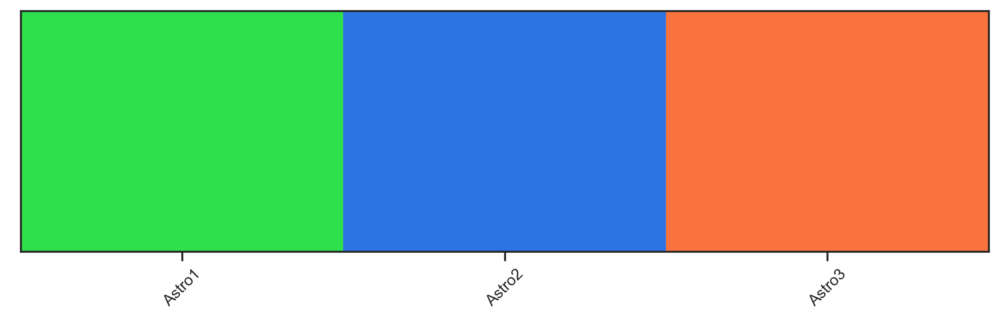

ADmouse_9723
Cortex, ADmouse_9723, 1935136.852425
ADmouse_9735
Cortex, ADmouse_9735, 1641609.060525
ADmouse_9494
Cortex, ADmouse_9494, 1466268.0669
ADmouse_9498
Cortex, ADmouse_9498, 1733180.3401499998
ADmouse_9723_2
Cortex, ADmouse_9723_2, 2296479.573675
ADmouse_9707
Cortex, ADmouse_9707, 2174473.9028249998
ADmouse_11346
Cortex, ADmouse_11346, 1774078.8014250002
ADmouse_11351
Cortex, ADmouse_11351, 2109801.032325
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Astro1-control v.s. Astro1-disease: t-test independent samples, P_val=9.674e-01 stat=2.253e+00
Astro2-control v.s. Astro2-disease: t-test independent samples, P_val=8.664e-03 stat=-3.256e+00
Astro3-control v.s. Astro3-disease: t-test independent samples, P_val=1.243e-03 stat=-4.986e+00


meta NOT subset; don't know how to subset; dropped


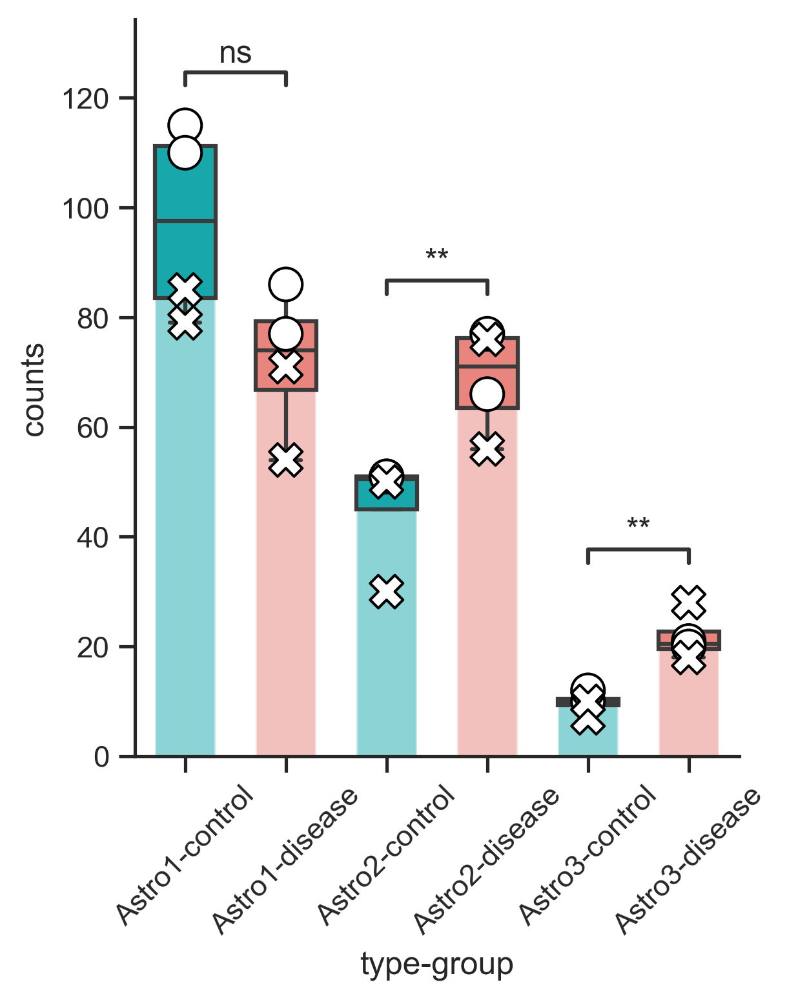

Corpus Callosum


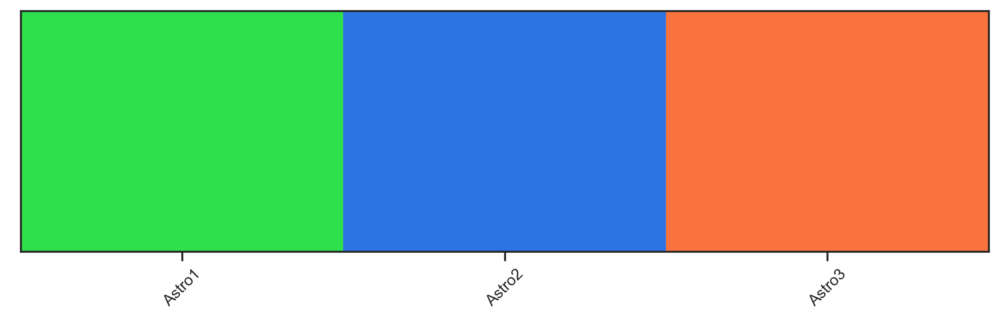

ADmouse_9723
Corpus Callosum, ADmouse_9723, 319855.260375
ADmouse_9735
Corpus Callosum, ADmouse_9735, 374779.5723
ADmouse_9494
Corpus Callosum, ADmouse_9494, 398250.2538
ADmouse_9498
Corpus Callosum, ADmouse_9498, 297507.40897499997
ADmouse_9723_2
Corpus Callosum, ADmouse_9723_2, 257129.08515000003
ADmouse_9707
Corpus Callosum, ADmouse_9707, 216047.05762500002
ADmouse_11346
Corpus Callosum, ADmouse_11346, 233061.46605000002
ADmouse_11351
Corpus Callosum, ADmouse_11351, 180859.09432499998
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Astro1-control v.s. Astro1-disease: t-test independent samples, P_val=9.791e-01 stat=2.578e+00
Astro2-control v.s. Astro2-disease: t-test independent samples, P_val=5.429e-01 stat=1.124e-01
Astro3-control v.s. Astro3-disease: t-test independent samples, P_val=8.394e-02 stat=-1.568e+00


meta NOT subset; don't know how to subset; dropped


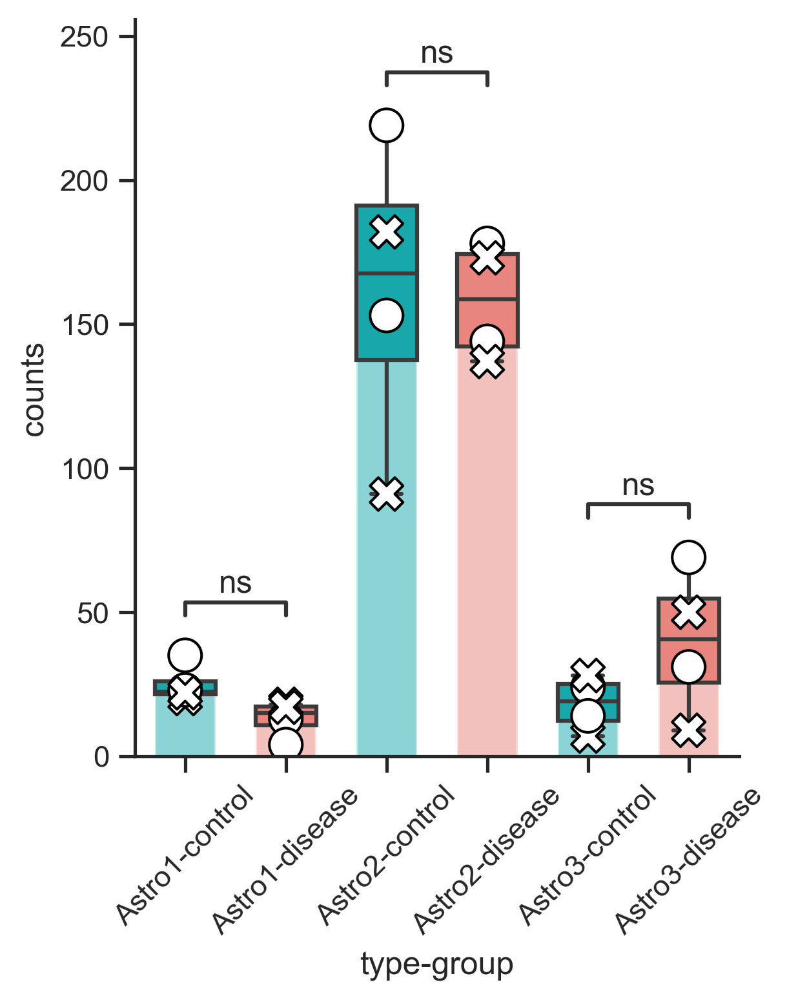

Hippocampus


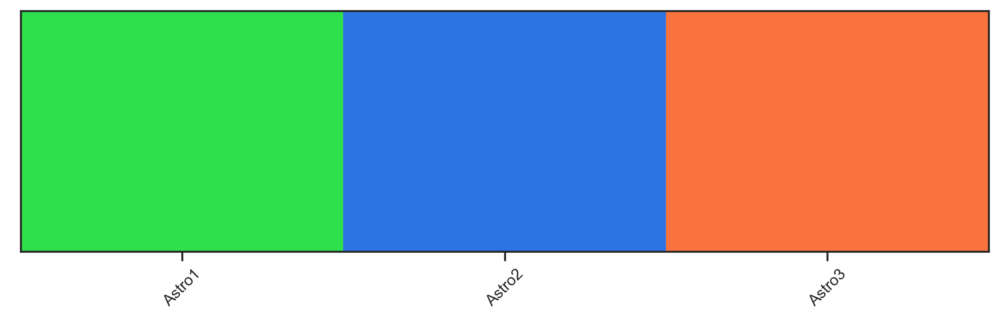

ADmouse_9723
Hippocampus, ADmouse_9723, 1637784.036
ADmouse_9735
Hippocampus, ADmouse_9735, 1917025.3131750003
ADmouse_9494
Hippocampus, ADmouse_9494, 2567077.460325
ADmouse_9498
Hippocampus, ADmouse_9498, 1753357.0493250003
ADmouse_9723_2
Hippocampus, ADmouse_9723_2, 1904689.661175
ADmouse_9707
Hippocampus, ADmouse_9707, 2067523.542
ADmouse_11346
Hippocampus, ADmouse_11346, 2522482.967025
ADmouse_11351
Hippocampus, ADmouse_11351, 2171744.52075
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Astro1-control v.s. Astro1-disease: t-test independent samples, P_val=9.877e-01 stat=2.983e+00
Astro2-control v.s. Astro2-disease: t-test independent samples, P_val=2.819e-01 stat=-6.109e-01
Astro3-control v.s. Astro3-disease: t-test independent samples, P_val=6.690e-02 stat=-1.733e+00


meta NOT subset; don't know how to subset; dropped


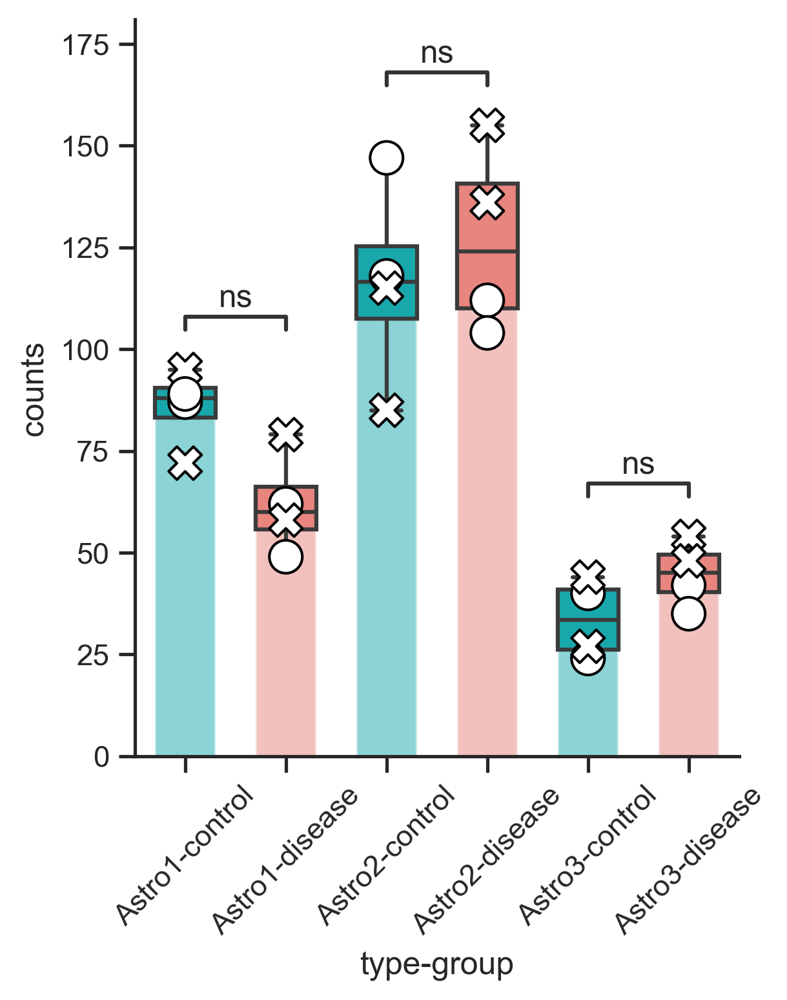

In [27]:
# Subset of regions
sub_id = ['Astro']
# sub_id = ['CTX-Ex']
# sub_id = ['CA1', 'CA2', 'CA3', 'DG']

# width 
width = .6

# stat alternative
alternative = 'less'

all_list = []

region_list = ['Cortex', 'Corpus Callosum', 'Hippocampus']
# region_list = ['Cortex', 'Hippocampus']
# region_list = ['Cortex']
# region_list = ['Hippocampus']
# region_list = region_list[0:1]

show_colormap = True

# Iterate region 
for r, current_region in enumerate(region_list):
    print(current_region)
    if current_region == 'Cortex':
        current_index = (adata.obs['region_merged'] == current_region) & (~adata.obs['top_level'].isin(['CA1', 'CA2', 'CA3', 'DG', 'LHb']))
    elif current_region == 'Corpus Callosum':
        current_index = (adata.obs['region_merged'] == current_region) & (~adata.obs['top_level'].isin(['CTX-Ex', 'Inh', 'CA1', 'CA2', 'CA3', 'DG', 'LHb']))
    elif current_region == 'Hippocampus':
        current_index = (adata.obs['region_merged'] == current_region)#  & (~adata.obs['top_level'].isin(['CTX-Ex']))
    elif current_region == 'Subcortical':
        current_index = (adata.obs['region_merged'].isin(['Corpus Callosum', 'Hippocampus'])) & (~adata.obs['top_level'].isin(['CTX-Ex']))
    
    # current_index

    # cell type Subset
    rdata = adata[current_index, :]
    curr_cells = rdata.obs['top_level'].isin(sub_id)
    pdata = rdata[curr_cells, :]

    # Check color legend
    current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in pdata.obs['cell_type'].unique()]
    sub_cpl = []
    for i in current_cell_type_order:
        sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

    sub_cpl = sns.color_palette(sub_cpl)
    sub_cmap = ListedColormap(sub_cpl.as_hex())
    if show_colormap:
        sns.palplot(sub_cpl, size=3)
        plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
        plt.tight_layout()
        # plt.savefig(f'./figures/color_legend_top.png')
        plt.show()
    
    # normalized barplot
    region_dict = {'Cortex':1, 'Corpus Callosum':2, 'Hippocampus':3}

    n_cat = pdata.obs['cell_type'].cat.categories.shape[0]
    n_sample = pdata.obs['sample'].cat.categories.shape[0]
    count_df = pd.DataFrame(np.zeros([n_sample, n_cat]), columns=pdata.obs['cell_type'].cat.categories)
    count_df_index_list = []
    cell_dist_list = []
    for i, sample in enumerate(pdata.obs['sample'].cat.categories):
        if i >= 0:
            print(sample)
            curr_cells = (pdata.obs['sample'] == sample)
            temp = pdata[curr_cells, :]

            cell_dist = pd.DataFrame(temp.obs['cell_type'].value_counts())
            cell_dist['counts'] = cell_dist['cell_type']
            cell_dist['cell_type'] = cell_dist.index
            cell_dist['cell_type'] = cell_dist['cell_type'].astype(object)
            cell_dist = cell_dist.reset_index(drop=True)
            # cell_dist = cell_dist.loc[cell_dist['counts'] != 0, :]
            # cell_dist['cell_type'] = cell_dist['cell_type'].astype('category')

            for j in current_cell_type_order:
                if j not in cell_dist['cell_type'].unique():
                    cell_dist = cell_dist.append({'cell_type': j, 'counts': 0}, ignore_index=True)

            cell_dist['cell_type'] = cell_dist['cell_type'].astype('category')
            cell_dist['cell_type'] = cell_dist['cell_type'].cat.reorder_categories(current_cell_type_order)
            cell_dist['sample'] = pdata.obs.loc[pdata.obs['sample'] == sample, 'group'].unique()[0]
            cell_dist['time'] = pdata.obs.loc[pdata.obs['sample'] == sample, 'time'].unique()[0]

            region_areas = {}
            for k, region in enumerate(regionprops(pdata.uns[f'{sample}_morph']['region_merged'])):
                # print(region.area)
                region_areas[region.label] = region.area

            current_area = 0
            if current_region == 'Subcortical':
                current_area = (region_areas[2] + region_areas[3]) * 0.315 * 0.315
            else:
                current_area = region_areas[region_dict[current_region]] * 0.315 * 0.315

            print(f"{current_region}, {sample}, {current_area}")
            # print(cell_dist)
            cell_dist['counts'] = cell_dist['counts'] / current_area * 1000000
            cell_dist['counts'] = cell_dist['counts'].round()
            cell_dist['counts'] = cell_dist['counts'].astype(int)
            cell_dist['region'] = current_region
            cell_dist = cell_dist.reset_index(drop=True)

            # print(cell_dist.shape)
            cell_dist_list.append(cell_dist)
            
            count_df_index_list.append(temp.obs['group'].cat.categories[0])
            for j in cell_dist['cell_type'].cat.categories:
                count_df.loc[i, j] = cell_dist.loc[cell_dist['cell_type'] == j, 'counts'].values
    
    count_df['group'] = count_df_index_list
    
    
    test_df = pd.concat(cell_dist_list)
    test_df = test_df.reset_index(drop=True)
    test_df['type-group'] = test_df['cell_type'].astype(str) + '-' + test_df['sample'].astype(str)
    test_df['type-group'] = test_df['type-group'].astype('category')
    
    sns.set_theme(style="ticks")
    f, ax = plt.subplots(figsize=(4, 5))

    cf_pl = sns.color_palette(['#00bfc4', '#f8766d'])
    sns.barplot(y="counts", x="type-group", data=test_df, palette=cf_pl, ci=None, alpha=.5, ax=ax, zorder=0)
    change_width(ax, width)
    sns.boxplot(y="counts", x="type-group", data=test_df, width=width, palette=cf_pl, fliersize=0, ax=ax, zorder=1)
    sns.scatterplot(y="counts",x="type-group", data=test_df, facecolors='white', style="time", edgecolor='black', s=150, ax=ax, legend=False, zorder=2)
    sns.despine()

    add_stat_annotation(ax, data=test_df, x='type-group', y='counts',
                        box_pairs=[((test_df['type-group'].cat.categories[0]), (test_df['type-group'].cat.categories[1])),
                                  ((test_df['type-group'].cat.categories[2]), (test_df['type-group'].cat.categories[3])),
                                   ((test_df['type-group'].cat.categories[4]), (test_df['type-group'].cat.categories[5]))],
                        test='t-test_ind', text_format='star', verbose=2, comparisons_correction=None, stats_params={'alternative': alternative})


    plt.xticks(rotation=45)
    current_fig_out_path = os.path.join(fig_path, sub_id[0])
    if not os.path.exists(current_fig_out_path):
        os.mkdir(current_fig_out_path)
    plt.savefig(os.path.join(current_fig_out_path, f'cluster_density_{alternative}_{current_region}_large.pdf'))
    plt.show()

##### all region

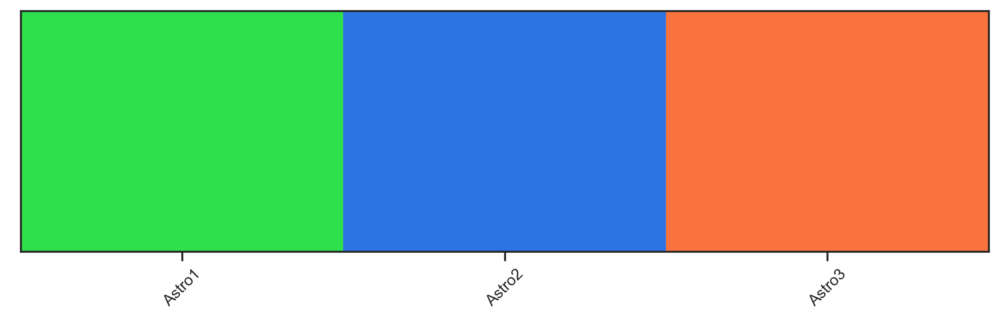

ADmouse_9723, 3892776.1488
ADmouse_9735, 3933413.946
ADmouse_9494, 4431595.781025
ADmouse_9498, 3784044.79845
ADmouse_9723_2, 4458298.32
ADmouse_9707, 4458044.5024500005
ADmouse_11346, 4529623.2345
ADmouse_11351, 4462404.6474
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Astro1-control v.s. Astro1-disease: t-test independent samples, P_val=3.748e-03 stat=3.955e+00
Astro2-control v.s. Astro2-disease: t-test independent samples, P_val=8.793e-01 stat=-1.300e+00
Astro3-control v.s. Astro3-disease: t-test independent samples, P_val=9.902e-01 stat=-3.160e+00


meta NOT subset; don't know how to subset; dropped


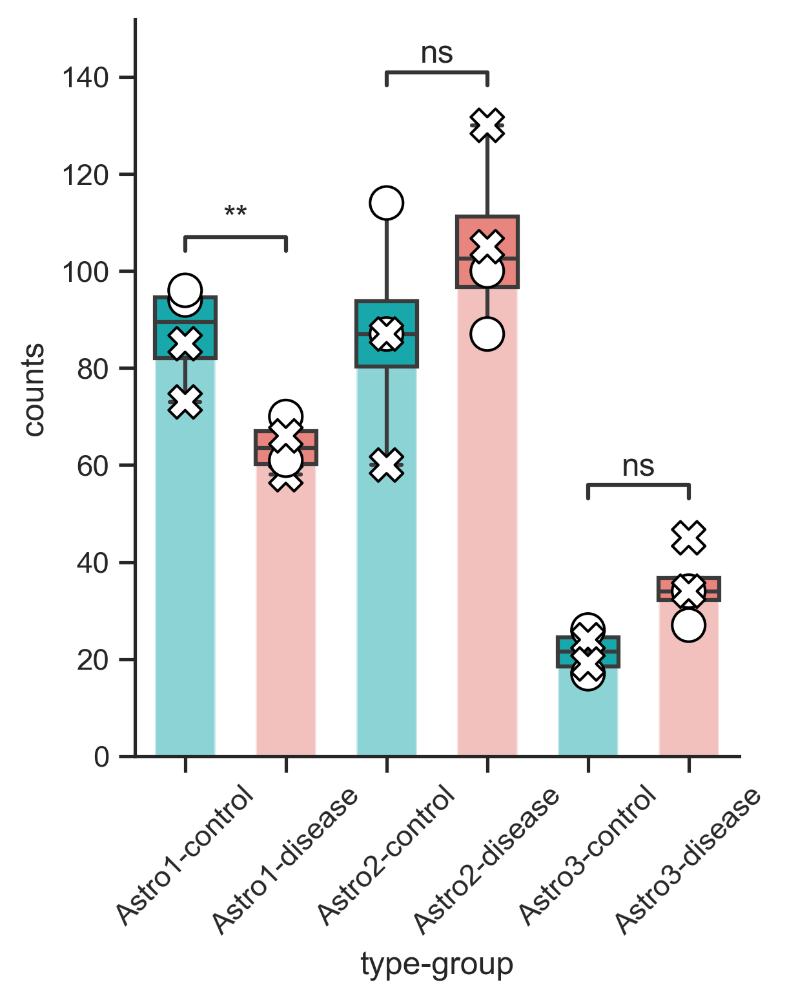

In [25]:
# Subset of regions
sub_id = ['Astro']
# sub_id = ['CTX-Ex']
# sub_id = ['CA1', 'CA2', 'CA3', 'DG']

# width 
width = .6

# stat alternative
alternative = 'greater'

all_list = []

show_colormap = True

# cell type Subset
curr_cells = adata.obs['top_level'].isin(sub_id)
pdata = adata[curr_cells, :]

# Check color legend
current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in pdata.obs['cell_type'].unique()]
sub_cpl = []
for i in current_cell_type_order:
    sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

sub_cpl = sns.color_palette(sub_cpl)
sub_cmap = ListedColormap(sub_cpl.as_hex())
if show_colormap:
    sns.palplot(sub_cpl, size=3)
    plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
    plt.tight_layout()
    plt.show()

# normalized barplot
n_cat = pdata.obs['cell_type'].cat.categories.shape[0]
n_sample = pdata.obs['sample'].cat.categories.shape[0]
count_df = pd.DataFrame(np.zeros([n_sample, n_cat]), columns=pdata.obs['cell_type'].cat.categories)
count_df_index_list = []
cell_dist_list = []
for i, sample in enumerate(pdata.obs['sample'].cat.categories):
    if i >= 0:
        # print(sample)
        curr_cells = (pdata.obs['sample'] == sample)
        temp = pdata[curr_cells, :]

        cell_dist = pd.DataFrame(temp.obs['cell_type'].value_counts())
        cell_dist['counts'] = cell_dist['cell_type']
        cell_dist['cell_type'] = cell_dist.index
        cell_dist['cell_type'] = cell_dist['cell_type'].astype(object)
        cell_dist = cell_dist.reset_index(drop=True)

        for j in current_cell_type_order:
            if j not in cell_dist['cell_type'].unique():
                cell_dist = cell_dist.append({'cell_type': j, 'counts': 0}, ignore_index=True)

        cell_dist['cell_type'] = cell_dist['cell_type'].astype('category')
        cell_dist['cell_type'] = cell_dist['cell_type'].cat.reorder_categories(current_cell_type_order)
        cell_dist['sample'] = pdata.obs.loc[pdata.obs['sample'] == sample, 'group'].unique()[0]
        cell_dist['time'] = pdata.obs.loc[pdata.obs['sample'] == sample, 'time'].unique()[0]

        # calculate area
        current_img = pdata.uns[f'{sample}_morph']['region_merged']
        current_area = current_img.shape[0] * current_img.shape[1] * 0.315 * 0.315
        print(f"{sample}, {current_area}")

        cell_dist['counts'] = cell_dist['counts'] / current_area * 1000000
        cell_dist['counts'] = cell_dist['counts'].round()
        cell_dist['counts'] = cell_dist['counts'].astype(int)
        cell_dist = cell_dist.reset_index(drop=True)

        # print(cell_dist.shape)
        cell_dist_list.append(cell_dist)

        count_df_index_list.append(temp.obs['group'].cat.categories[0])
        for j in cell_dist['cell_type'].cat.categories:
            count_df.loc[i, j] = cell_dist.loc[cell_dist['cell_type'] == j, 'counts'].values

count_df['group'] = count_df_index_list

test_df = pd.concat(cell_dist_list)
test_df = test_df.reset_index(drop=True)
test_df['type-group'] = test_df['cell_type'].astype(str) + '-' + test_df['sample'].astype(str)
test_df['type-group'] = test_df['type-group'].astype('category')

sns.set_theme(style="ticks")
f, ax = plt.subplots(figsize=(4, 5))

cf_pl = sns.color_palette(['#00bfc4', '#f8766d'])
sns.barplot(y="counts", x="type-group", data=test_df, palette=cf_pl, ci=None, alpha=.5, ax=ax, zorder=0)
change_width(ax, width)
sns.boxplot(y="counts", x="type-group", data=test_df, width=width, palette=cf_pl, fliersize=0, ax=ax, zorder=1)
sns.scatterplot(y="counts",x="type-group", data=test_df, facecolors='white', style="time", edgecolor='black', s=150, ax=ax, legend=False, zorder=2)
sns.despine()

add_stat_annotation(ax, data=test_df, x='type-group', y='counts',
                    box_pairs=[((test_df['type-group'].cat.categories[0]), (test_df['type-group'].cat.categories[1])),
                              ((test_df['type-group'].cat.categories[2]), (test_df['type-group'].cat.categories[3])),
                               ((test_df['type-group'].cat.categories[4]), (test_df['type-group'].cat.categories[5]))],
                    test='t-test_ind', text_format='star', verbose=2, comparisons_correction=None, stats_params={'alternative': alternative})


plt.xticks(rotation=45)
current_fig_out_path = os.path.join(fig_path, sub_id[0])
if not os.path.exists(current_fig_out_path):
    os.mkdir(current_fig_out_path)
plt.savefig(os.path.join(current_fig_out_path, f'cluster_density_{alternative}_overall_large.pdf'))
plt.show()

#### Spatial map

##### label

In [ ]:
# Restore convex hull and top-level info
for sample in sorted(sdata.obs['sample'].unique()):
    print(sample)
    
    current_key = f"{sample}_morph"

    current_index = sdata.obs['sample'] == sample
    sdata.uns[current_key]['good_cells'] = sdata.obs.loc[current_index, 'orig_index'].astype(int).values
    sdata.uns[current_key]['colors'] = sdata.obs.loc[current_index, 'cell_type'].cat.codes.values

In [ ]:
# Spatial cell type map

for sample in sorted(sdata.obs['sample'].unique()):
    print(sample)
    su.plot_poly_cells_cluster_by_sample(sdata, sample, sub_cmap, show_plaque=True, show_tau=True, 
                                         save_as_real_size=True, linewidth=0.5,
                                        figscale=3, width=10, height=10, save=True, show=False, output_dir=sub_level_fig_path)

In [ ]:
# Spatial cell type map
sub_level_fig_path = os.path.join(sub_level_fig_path, 'sct-05')
if not os.path.exists(sub_level_fig_path):
    os.mkdir(sub_level_fig_path)
    
for sample in sorted(sdata.obs['sample'].unique()):
    print(sample)
    su.plot_poly_cells_cluster_by_sample(sdata, sample, sub_cmap, show_plaque=True, show_tau=True, 
                                         save_as_real_size=True, linewidth=0.5,
                                        figscale=3, width=10, height=10, save=True, show=False, output_dir=sub_level_fig_path)

##### Spatial cell type map of neurons (Fig. 6)

In [ ]:
# Subset
# plot_sample = ['AD_mouse9735', 'AD_mouse9723', 'AD_mouse9498', 'AD_mouse9494']
# sub_id = ['CTX-Ex', 'CA1', 'CA2', 'CA3', 'DG']
sub_id = ['Inh']
curr_cells = adata.obs['top_level'].isin(sub_id)
sdata = adata[curr_cells, :]

In [ ]:
# Check color legend
current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in sdata.obs['cell_type'].unique()]
sub_cpl = []
for i in current_cell_type_order:
    sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

sub_cpl = sns.color_palette(sub_cpl)
sub_cmap = ListedColormap(sub_cpl.as_hex())
sns.palplot(sub_cpl, size=3)
plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'./figures/color_legend_top.png')
plt.show()

In [ ]:
# Spatial cell type 
sub_level_fig_path = os.path.join(fig_path, sub_id[0])
if not os.path.exists(sub_level_fig_path):
    os.mkdir(sub_level_fig_path)
    
for sample in sorted(sdata.obs['sample'].unique()):
    current_key = f"{sample}_morph"
    current_index = sdata.obs['sample'] == sample
    # change to new color 
    sdata.uns[current_key]['colors'] = sdata.obs.loc[current_index, 'cell_type'].cat.codes.values
    sdata.uns[current_key]['good_cells'] = sdata.obs.loc[current_index, 'orig_index'].astype(int).values
    

    su.plot_poly_cells_cluster_by_sample(sdata, sample, sub_cmap, show_plaque=True, show_tau=True,
                                         save_as_real_size=True, linewidth=0.5,
                                        figscale=3, width=10, height=10, save=True, show=False, output_dir=sub_level_fig_path)


##### gene

In [ ]:
print(current_data.obs['x'].max(), current_data.obs['y'].max())

In [ ]:
grid_x, grid_y = np.mgrid[0:current_data.obs['x'].max():2000j, 0:current_data.obs['y'].max():2000j]
points = current_data.obs.loc[:, ['x', 'y']].to_numpy()
points.shape

In [ ]:
from scipy.interpolate import griddata
grid_z0 = griddata(points, current_expr, (grid_x, grid_y), method='nearest')
grid_z1 = griddata(points, current_expr, (grid_x, grid_y), method='linear')
grid_z2 = griddata(points, current_expr, (grid_x, grid_y), method='cubic')

In [ ]:
fig, ax = plt.subplots(figsize=(10,10))
sns.heatmap(grid_z1)

In [ ]:

fig, ax = plt.subplots(figsize=(10,10))
sns.kdeplot(data=current_data.obs, x="x", y="y", fill=True, gridsize=2000)

In [ ]:
gene = 'Cst7'
sample = 'ADmouse_9494'
current_data = adata[adata.obs['sample'] == sample, :]
fig, ax = plt.subplots(figsize=(10,10))
current_expr = np.array(current_data[:, gene].X.flatten())
bg = np.zeros(adata.uns[f"{sample}_morph"]['label_img'].shape)
ax.imshow(bg, cmap='Greys_r')
ax.scatter(x=current_data.obs['x'] * 0.3, y=current_data.obs['y'] * 0.3, c=current_expr, cmap=plt.cm.viridis, s=5, alpha=0.5)
ax.axis('off')
# ax.set_facecolor('k')
# sns.scatterplot(x='x', y='y', data=current_data.obs, hue=current_expr, palette='viridis', s=15)
plt.show()

### multiple types

In [12]:
# Subset (Oligo & OPC)
curr_cells = (adata.obs['top_level'] == 'Oligo') | (adata.obs['top_level'] == 'OPC')
sdata = adata[curr_cells, :]
sdata

View of AnnData object with n_obs × n_vars = 12534 × 2766
    obs: 'orig_index', 'sample', 'area', 'x', 'y', 'tau', 'group', 'time', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'top_level', 'cell_type', 'seg_label', 'region', 'region_merged', 'time-group', 'replicate', 'type-replicate'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'max_counts', 'detected', 'highly_variable', 'n_cells', 'mean', 'std'
    uns: 'ADmouse_11346_morph', 'ADmouse_11351_morph', 'ADmouse_9494_morph', 'ADmouse_9498_morph', 'ADmouse_9707_morph', 'ADmouse_9723_2_morph', 'ADmouse_9723_morph', 'ADmouse_9735_morph', 'cell_type_hex_dict', 'cell_type_order', 'cell_type_rgb_dict', 'top_level_hex_dict', 'top_level_order', 'top_level_rgb_dict'
    layers: 'corrected', 'norm', 'raw', 'scaled'

In [13]:
sub_level_fig_path = os.path.join(fig_path, 'Oligo_OPC')
if not os.path.exists(sub_level_fig_path):
    os.mkdir(sub_level_fig_path)

In [14]:
sc.settings.figdir = sub_level_fig_path
sc.set_figure_params(format='tif', dpi=150)

#### Embedding

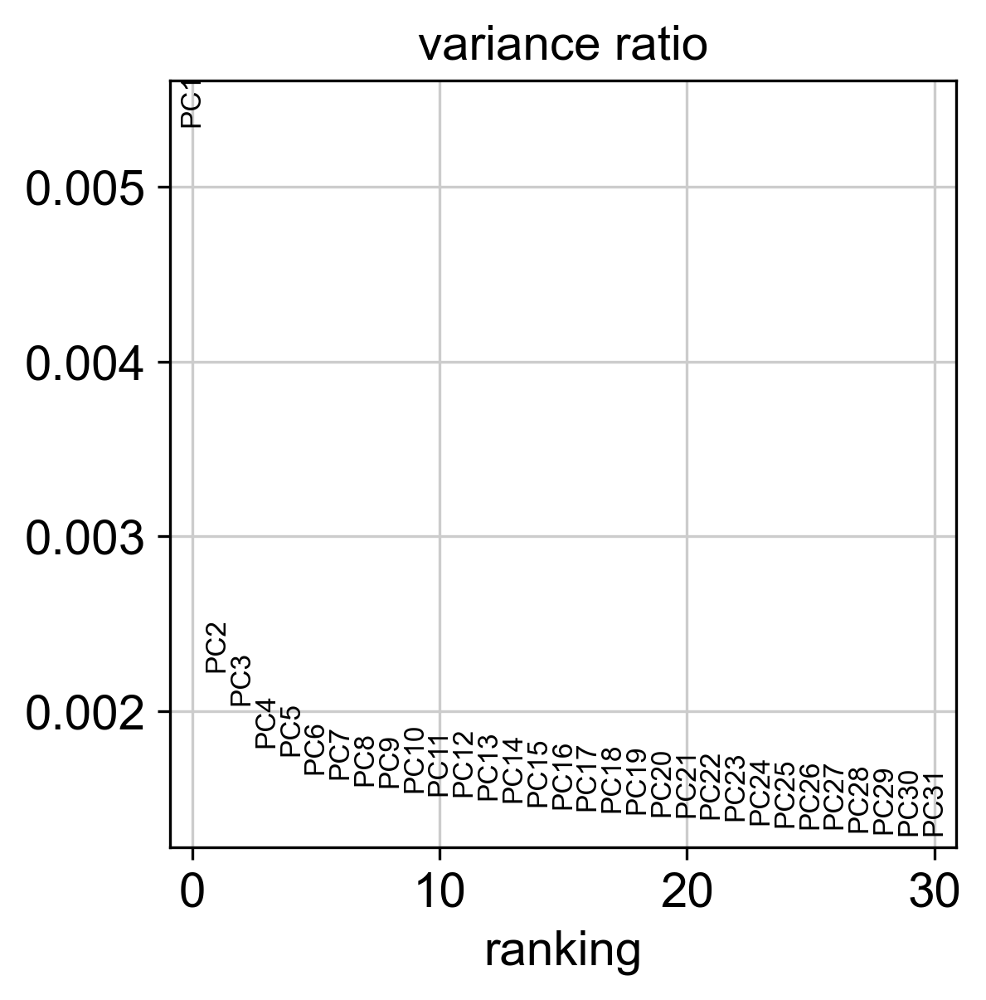

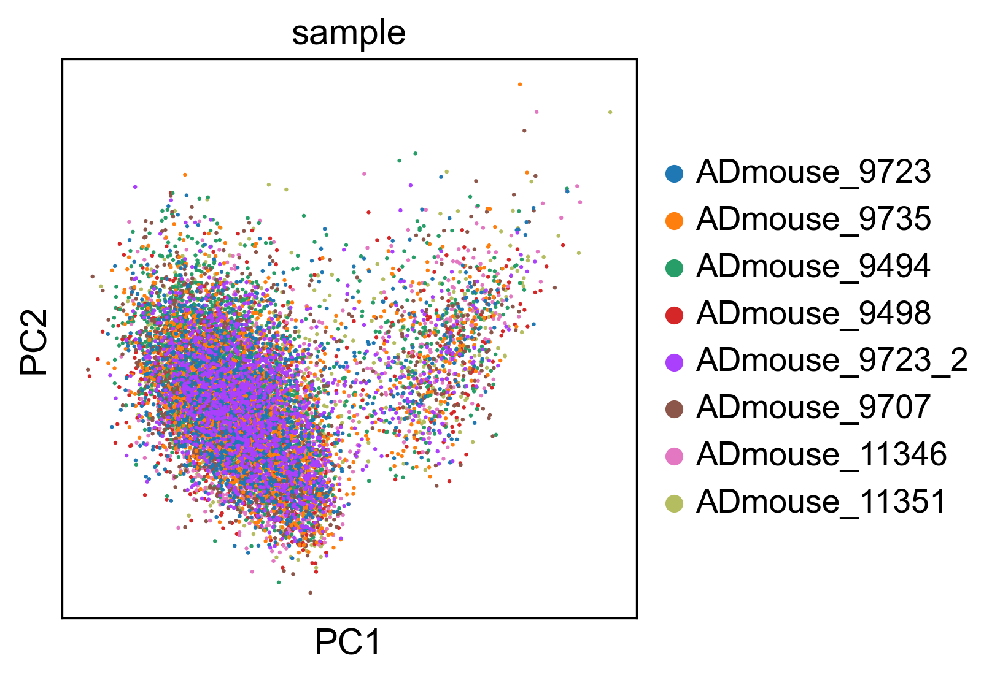

In [15]:
# Run PCA
sc.tl.pca(sdata, svd_solver='arpack', use_highly_variable=True)

# Plot explained variance 
sc.pl.pca_variance_ratio(sdata, log=False)

# Plot PCA
sc.pl.pca(sdata, color='sample')

In [ ]:
%%time
# Computing the neighborhood graph
n_neighbors = 30
n_pcs = 5
min_dist = 0.1

sc.pp.neighbors(sdata, n_neighbors=n_neighbors, n_pcs=n_pcs)

# Run UMAP
sc.tl.umap(sdata, min_dist=min_dist)
sc.tl.diffmap(sdata, n_comps=n_pcs)

In [ ]:
%%time
# Run leiden cluster
cluster_resolution = 0.3
sc.tl.leiden(sdata, resolution = cluster_resolution)

# Plot UMAP with cluster labels 
sc.pl.umap(sdata, color='leiden')
sc.pl.diffmap(sdata, color='leiden')
n_clusters = sdata.obs['leiden'].unique().shape[0]

if save_embedding:
    # Save log
    with open(f'{fig_path}/log_{sub_id}.txt', 'w') as f:
        f.write(f"""Number of neighbor: {n_neighbors}
    Number of PC: {n_pcs}
    Resolution: {cluster_resolution}
    Min-distance: {min_dist}
    Number of clusters: {n_clusters}""")

    # save embeddings
    np.savetxt(f'{fig_path}/embedding_Oligo_OPC_umap.csv', sdata.obsm['X_umap'], delimiter=",")
    np.savetxt(f'{fig_path}/embedding_Oligo_OPC_diffmap.csv', sdata.obsm['X_diffmap'], delimiter=",")

In [ ]:
# Check color legend
current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in sdata.obs['cell_type'].unique()]
sub_cpl = []
for i in current_cell_type_order:
    sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

sub_cpl = sns.color_palette(sub_cpl)
sub_cmap = ListedColormap(sub_cpl.as_hex())
sns.palplot(sub_cpl, size=3)
plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'./figures/color_legend_top.png')
plt.show()

In [ ]:
# Save plots
# Plot UMAP with cluster labels w/ new color
sc.pl.umap(sdata, color='cell_type', legend_loc='on data',
           legend_fontsize=12, legend_fontoutline=2, frameon=False, 
           title=f'UMAP', palette=sub_cpl, save=False)

sc.pl.diffmap(sdata, color='cell_type', legend_loc='on data',
           legend_fontsize=12, legend_fontoutline=2, frameon=False, 
           title=f'Diffusion Map', palette=sub_cpl, save=False)

# sc.tl.rank_genes_groups(sdata, 'cell_type', method='wilcoxon')

# # Plot logFC heatmap
# sc.pl.rank_genes_groups_heatmap(sdata, n_genes=5, groupby='cell_type', min_logfoldchange=.5, use_raw=False, swap_axes=True, 
#                                 vmin=-5, vmax=5, cmap='bwr', show_gene_labels=True, values_to_plot='logfoldchanges',
#                                 dendrogram=False, figsize=(30, 15), save='_logFC')

# # Plot z-score heatmap
# sc.pl.rank_genes_groups_heatmap(sdata, n_genes=10, groupby='cell_type', min_logfoldchange=.5, use_raw=False, swap_axes=True, 
#                                 vmin=-5, vmax=5, cmap='bwr', show_gene_labels=True,
#                                 dendrogram=False, figsize=(30, 15), save=False)

# # Plot logFC dotplot
# sc.pl.rank_genes_groups_dotplot(sdata, groupby='cell_type', n_genes=5, values_to_plot='logfoldchanges', min_logfoldchange=.5, 
#                                 vmax=5, vmin=-5, cmap='bwr', save='logFC')

# # Print markers 
# markers = []
# temp = pd.DataFrame(sdata.uns['rank_genes_groups']['names']).head(5)
# for i in range(temp.shape[1]):
#     curr_col = temp.iloc[:, i].to_list()
#     markers = markers + curr_col
#     print(i, curr_col)

In [ ]:
fig, axs = plt.subplots(nrows=2, ncols=4, figsize=(20, 7))
axs = axs.flatten()
for i, sample in enumerate(sdata.obs['sample'].cat.categories):
    current_data = sdata[sdata.obs["sample"] == sample, :]
    ax = sc.pl.umap(sdata, show=False, size=(120000 / sdata.n_obs), ax=axs[i])
    sc.pl.umap(current_data, color='cell_type', frameon=False, ax=ax, size=(120000 / sdata.n_obs), title=f"{sample}", legend_loc=None,
               palette=sub_cpl, save=False, show=False)
    
plt.show()

In [ ]:
fig, axs = plt.subplots(nrows=2, ncols=4, figsize=(20, 7))
axs = axs.flatten()
for i, sample in enumerate(sdata.obs['sample'].cat.categories):
    current_data = sdata[sdata.obs["sample"] == sample, :]
    ax = sc.pl.diffmap(sdata, show=False, size=(120000 / sdata.n_obs), ax=axs[i])
    sc.pl.diffmap(current_data, color='cell_type', frameon=False, ax=ax, size=(120000 / sdata.n_obs), title=f"{sample}", legend_loc=None,
               palette=sub_cpl, save=False, show=False)
    
plt.show()

In [ ]:
fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(30, 5))
fig.subplots_adjust(hspace=0, wspace=0.1)
axs = axs.flatten()
for i, sample in enumerate(sdata.obs['time-group'].cat.categories):
    ax = sc.pl.umap(sdata, show=False, size=(120000 / sdata.n_obs), ax=axs[i], na_color='#ededed')
    sc.pl.umap(sdata[sdata.obs["time-group"] == sample], color='cell_type', frameon=True, ax=ax, size=(120000 / sdata.n_obs), title=f"{sample}", legend_loc=None, # 120000
               palette=sub_cpl, save=False, show=False)
    
plt.show()

In [ ]:
fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(30, 5))
fig.subplots_adjust(hspace=0, wspace=0.1)
axs = axs.flatten()
for i, sample in enumerate(sdata.obs['time-group'].cat.categories):
    ax = sc.pl.diffmap(sdata, show=False, size=(120000 / sdata.n_obs), ax=axs[i], na_color='#ededed')
    sc.pl.diffmap(sdata[sdata.obs["time-group"] == sample], color='cell_type', frameon=True, ax=ax, size=(120000 / sdata.n_obs), title=f"{sample}", legend_loc=None, # 120000
               palette=sub_cpl, save=False, show=False)
    
plt.show()

In [ ]:
# Plot time-group UMAP
scale_factor = 4000000
alpha = .3
for sample in sorted(sdata.obs['time-group'].unique()):
    print(sample)
    fig, ax = plt.subplots(figsize=(10,7))
    sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='', palette=sns.color_palette(['#fafafa']))
    sc.pl.diffmap(sdata[sdata.obs["time-group"] == sample], color='cell_type', frameon=False, ax=ax, size=(scale_factor / sdata.n_obs), legend_loc=None, alpha=alpha,
               title='', palette=sub_cpl, save=f'_{sample}')

In [ ]:
# Plot UMAP with cluster labels w/ new color
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.diffmap(sdata, color='cell_type', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha,
           legend_loc=False, palette=sub_cpl, save='_all')

In [ ]:
# Plot time-group UMAP
scale_factor = 4000000
alpha = .3
plot_genes = ['Plp1', 'Cldn11', 'C4b', 'Klk6']
for gene in plot_genes:
    print(gene)
    fig, ax = plt.subplots(figsize=(10,7))
    sc.pl.diffmap(sdata, color=gene, frameon=False, ax=ax, size=(scale_factor / sdata.n_obs), legend_loc=None, alpha=alpha,
               title='', cmap='viridis', save=f'_{gene}')

#### Gene markers

In [ ]:
# Add log layer
sdata.layers['log_raw'] = np.log1p(sdata.layers['raw'])
sc.pp.normalize_total(sdata, layer='log_raw')

# Find gene markers for each cluster
sc.tl.rank_genes_groups(sdata, 'cell_type', method='wilcoxon', layer='log_raw', pts=True, use_raw=False, n_genes=adata.shape[1])

# Filter markers
sc.tl.filter_rank_genes_groups(sdata, min_fold_change=.1, min_in_group_fraction=0.2, max_out_group_fraction=0.8)

In [ ]:
current_cell_type = 'Oligo1'

current_df = sc.get.rank_genes_groups_df(sdata, group=current_cell_type, key='rank_genes_groups')
current_df# .loc[df['names'] == 'Gfap', :]

##### dotplot

In [ ]:
# Dot plot logfoldchanges
sc.pl.rank_genes_groups_dotplot(sdata, key='rank_genes_groups', n_genes=5, values_to_plot='logfoldchanges', min_logfoldchange=1, vmax=5, vmin=-5, cmap='bwr', dendrogram=False)

In [ ]:
# Dot plot mean expression (##)
sc.pl.rank_genes_groups_dotplot(sdata, key='rank_genes_groups_filtered', n_genes=5, dendrogram=False)

In [ ]:
marker_genes_dict = {}
    
temp = pd.DataFrame(sdata.uns['rank_genes_groups_filtered']['names']).head(5)
temp_genes = []
for i in range(temp.shape[1]):
    current_genes = temp.iloc[:, i].to_list()
    current_genes = [x for x in current_genes if str(x) != 'nan']
    current_genes = [x for x in current_genes if x not in temp_genes]
    
    for j in current_genes:
        temp_genes.append(j)
        
    current_key = temp.columns[i]
    marker_genes_dict[current_key] = current_genes

marker_genes_dict

##### matrix plot

In [ ]:
sc.pl.rank_genes_groups_matrixplot(sdata, n_genes=5, use_raw=False, vmin=-5, vmax=5, cmap='bwr', layer='scaled', key='rank_genes_groups_filtered', dendrogram=False)

In [ ]:
# Customized matrixplot
# sample_order = ['ADmouse_9735', 'ADmouse_9707', 'ADmouse_9723', 'ADmouse_9723_2', 'ADmouse_9498', 'ADmouse_11351', 'ADmouse_9494', 'ADmouse_11346']
sample_order = ['ADmouse_9735', 'ADmouse_9707', 'ADmouse_9498', 'ADmouse_11351', 'ADmouse_9723', 'ADmouse_9723_2', 'ADmouse_9494', 'ADmouse_11346']
sdata.obs['sample'] = sdata.obs['sample'].cat.reorder_categories(sample_order)
sc.pl.matrixplot(sdata, marker_genes_dict, 'sample', dendrogram=False, cmap='bwr', layer='scaled', vmin=-5, vmax=5) 

In [ ]:
# Customized plot
sc.pl.matrixplot(sdata, marker_genes_dict, 'type-replicate', dendrogram=False, cmap='Reds') 
sc.pl.matrixplot(sdata, marker_genes_dict, 'type-replicate', dendrogram=False, cmap='bwr', standard_scale='var', swap_axes=True, vmin=-0.5, vmax=1.5) 
sc.pl.matrixplot(sdata, marker_genes_dict, 'type-replicate', dendrogram=False, cmap='Reds', standard_scale='var', swap_axes=True) 
sc.pl.matrixplot(sdata, marker_genes_dict, 'type-replicate', dendrogram=False, cmap='Reds', standard_scale='group', swap_axes=True) 

##### dot plot

In [ ]:
# Customized dot plot
sc.pl.dotplot(sdata, marker_genes_dict, 'type-replicate', dendrogram=False, cmap='Reds', swap_axes=True) 
sc.pl.dotplot(sdata, marker_genes_dict, 'type-replicate', dendrogram=False, cmap='Reds', standard_scale='var', swap_axes=True) 

sc.set_figure_params(format='pdf', dpi=150)
sc.pl.dotplot(sdata, marker_genes_dict, 'type-replicate', dendrogram=False, cmap='Reds', standard_scale='group', swap_axes=True, save=f'_{sub_id}') 

##### on embedding

In [ ]:
# gene_list
gene_list = [item for sublist in marker_genes_dict.values() for item in sublist]
print(len(gene_list))

nrows = 3
ncols = 6
figsize = (ncols * 5, nrows * 4)

In [ ]:
# grid umap & diffmap
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
axs = axs.flatten()
for i, gene in enumerate(gene_list):
    ax = sc.pl.diffmap(sdata, color=gene, title=gene, ax=axs[i], show=False)
    
plt.show()

#### Density

In [ ]:
# Subset of regions
# sub_id = ['CTX-Ex']
sub_id = ['Oligo', 'OPC']

all_list = []

region_list = ['Cortex', 'Corpus Callosum', 'Hippocampus']
# region_list = ['Cortex', 'Hippocampus']
# region_list = ['Hippocampus']
# region_list = region_list[0:1]

show_colormap = True

# Iterate region 
for r, current_region in enumerate(region_list):
    print(current_region)
    if current_region == 'Cortex':
        current_index = (adata.obs['region'] == current_region) & (~adata.obs['top_level'].isin(['CA1', 'CA2', 'CA3', 'DG', 'LHb']))
    elif current_region == 'Corpus Callosum':
        current_index = (adata.obs['region'] == current_region) & (~adata.obs['top_level'].isin(['CTX-Ex', 'Inh', 'CA1', 'CA2', 'CA3', 'DG', 'LHb']))
    elif current_region == 'Hippocampus':
        current_index = (adata.obs['region'] == current_region)#  & (~adata.obs['top_level'].isin(['CTX-Ex']))
    elif current_region == 'Subcortical':
        current_index = (adata.obs['region'].isin(['Corpus Callosum', 'Hippocampus'])) & (~adata.obs['top_level'].isin(['CTX-Ex']))
    
    current_index

    # cell type Subset
    rdata = adata[current_index, :]
    curr_cells = rdata.obs['top_level'].isin(sub_id)
    pdata = rdata[curr_cells, :]

    # Check color legend
    current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in pdata.obs['cell_type'].unique()]
    sub_cpl = []
    for i in current_cell_type_order:
        sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

    sub_cpl = sns.color_palette(sub_cpl)
    sub_cmap = ListedColormap(sub_cpl.as_hex())
    if show_colormap:
        sns.palplot(sub_cpl, size=3)
        plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
        plt.tight_layout()
        # plt.savefig(f'./figures/color_legend_top.png')
        plt.show()
    
    # normalized barplot
    region_dict = {'Cortex':1, 'Corpus Callosum':2, 'Hippocampus':3}

    n_cat = pdata.obs['cell_type'].cat.categories.shape[0]
    n_sample = pdata.obs['sample'].cat.categories.shape[0]
    count_df = pd.DataFrame(np.zeros([n_sample, n_cat]), columns=pdata.obs['cell_type'].cat.categories)
    count_df_index_list = []
    cell_dist_list = []
    for i, sample in enumerate(pdata.obs['sample'].cat.categories):
        if i >= 0:
            print(sample)
            curr_cells = (pdata.obs['sample'] == sample)
            temp = pdata[curr_cells, :]

            cell_dist = pd.DataFrame(temp.obs['cell_type'].value_counts())
            cell_dist['counts'] = cell_dist['cell_type']
            cell_dist['cell_type'] = cell_dist.index
            cell_dist['cell_type'] = cell_dist['cell_type'].astype(object)
            cell_dist = cell_dist.reset_index(drop=True)
            # cell_dist = cell_dist.loc[cell_dist['counts'] != 0, :]
            # cell_dist['cell_type'] = cell_dist['cell_type'].astype('category')

            for j in current_cell_type_order:
                if j not in cell_dist['cell_type'].unique():
                    cell_dist = cell_dist.append({'cell_type': j, 'counts': 0}, ignore_index=True)

            cell_dist['cell_type'] = cell_dist['cell_type'].astype('category')
            cell_dist['cell_type'] = cell_dist['cell_type'].cat.reorder_categories(current_cell_type_order)
            cell_dist['sample'] = pdata.obs.loc[pdata.obs['sample'] == sample, 'time-group'].unique()[0]

            region_areas = {}
            for k, region in enumerate(regionprops(pdata.uns[f'{sample}_morph']['region'])):
                # print(region.area)
                region_areas[region.label] = region.area

            current_area = 0
            if current_region == 'Subcortical':
                current_area = (region_areas[2] + region_areas[3]) * 0.315 * 0.315
            else:
                current_area = region_areas[region_dict[current_region]] * 0.315 * 0.315

            print(f"{current_region}, {sample}, {current_area}")
            # print(cell_dist)
            cell_dist['counts'] = cell_dist['counts'] / current_area * 1000000
            cell_dist['counts'] = cell_dist['counts'].round()
            cell_dist['counts'] = cell_dist['counts'].astype(int)
            cell_dist['region'] = current_region
            cell_dist = cell_dist.reset_index(drop=True)

            # print(cell_dist.shape)
            cell_dist_list.append(cell_dist)
            
            count_df_index_list.append(temp.obs['time-group'].cat.categories[0])
            for j in cell_dist['cell_type'].cat.categories:
                count_df.loc[i, j] = cell_dist.loc[cell_dist['cell_type'] == j, 'counts'].values
    
    count_df['group'] = count_df_index_list
    ave = count_df.groupby('group').mean()
    ave = ave.reindex(index = ['8months-control','8months-disease','13months-control','13months-disease'])
    error = count_df.groupby('group').std()
    error = error.reindex(index = ['8months-control','8months-disease','13months-control','13months-disease'])
    
    fig, ax = plt.subplots()

    ave.plot.bar(yerr=error, ax=ax, capsize=3, stacked=True, legend=False, cmap=sub_cmap, width=0.8)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.get_xaxis().set_visible(False)
    plt.locator_params(axis='y', nbins=4)
    # plt.savefig(f'./figures/{sub_id[0]}_{current_region}_composition.pdf')
    plt.show()
    
    fig, ax = plt.subplots()
    ave_n = ave.div(ave.max(axis=0), axis=1)
    sns.heatmap(ave_n, vmin=0, vmax=1, cmap='plasma', annot=ave, cbar=False, square=True, fmt=".1f")
    plt.show()


#     cell_dist_total = pd.concat(cell_dist_list)
#     cell_dist_total['sample'] = cell_dist_total['sample'].astype('category')
#     cell_dist_total['sample'] = cell_dist_total['sample'].cat.reorder_categories(pdata.obs['time-group'].cat.categories)
#     df = cell_dist_total.pivot(columns='cell_type', index='sample').fillna(0)
#     # print(df)
#     # plot it
#     fig, ax = plt.subplots()
#     df.plot(kind='bar', stacked=True, legend=False, cmap=sub_cmap, ax=ax, width=0.8)
#     #plt.setp(ax.patches, linewidth=1, edgecolor='black')
#     ax.spines['top'].set_visible(False)
#     ax.spines['right'].set_visible(False)
#     ax.get_xaxis().set_visible(False)
#     plt.locator_params(axis='y', nbins=4)
#     # plt.savefig(f'./figures/{sub_id[0]}_{current_region}_composition.pdf')
#     plt.show()
    
#     df['total'] = df['counts'].sum(axis=1)
#     df_out = df.loc[:, ['counts', 'total']]
    # df_out.to_csv(f'./figures/{sub_id[0]}_{current_region}_composition.csv')

#### Cluster frequencies

##### per region

Cortex


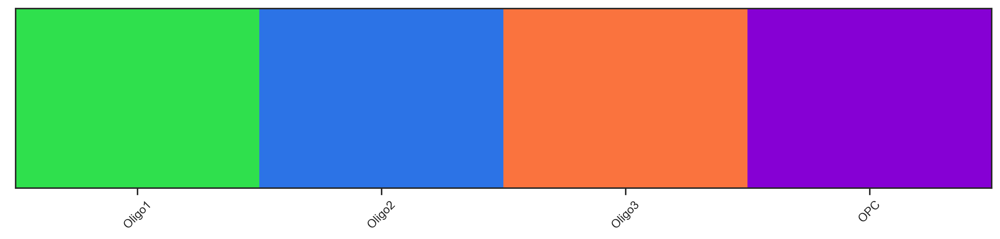

ADmouse_9723
Cortex, ADmouse_9723, 1935136.852425
ADmouse_9735
Cortex, ADmouse_9735, 1641609.060525
ADmouse_9494
Cortex, ADmouse_9494, 1466268.0669
ADmouse_9498
Cortex, ADmouse_9498, 1733180.3401499998
ADmouse_9723_2
Cortex, ADmouse_9723_2, 2296479.573675
ADmouse_9707
Cortex, ADmouse_9707, 2174473.9028249998
ADmouse_11346
Cortex, ADmouse_11346, 1774078.8014250002
ADmouse_11351
Cortex, ADmouse_11351, 2109801.032325
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

OPC-control v.s. OPC-disease: t-test independent samples, P_val=9.422e-01 stat=-1.838e+00
Oligo1-control v.s. Oligo1-disease: t-test independent samples, P_val=4.611e-01 stat=1.018e-01
Oligo2-control v.s. Oligo2-disease: t-test independent samples, P_val=8.818e-01 stat=-1.316e+00
Oligo3-control v.s. Oligo3-disease: t-test independent samples, P_val=7.720e-01 stat=-7.967e-01


meta NOT subset; don't know how to subset; dropped


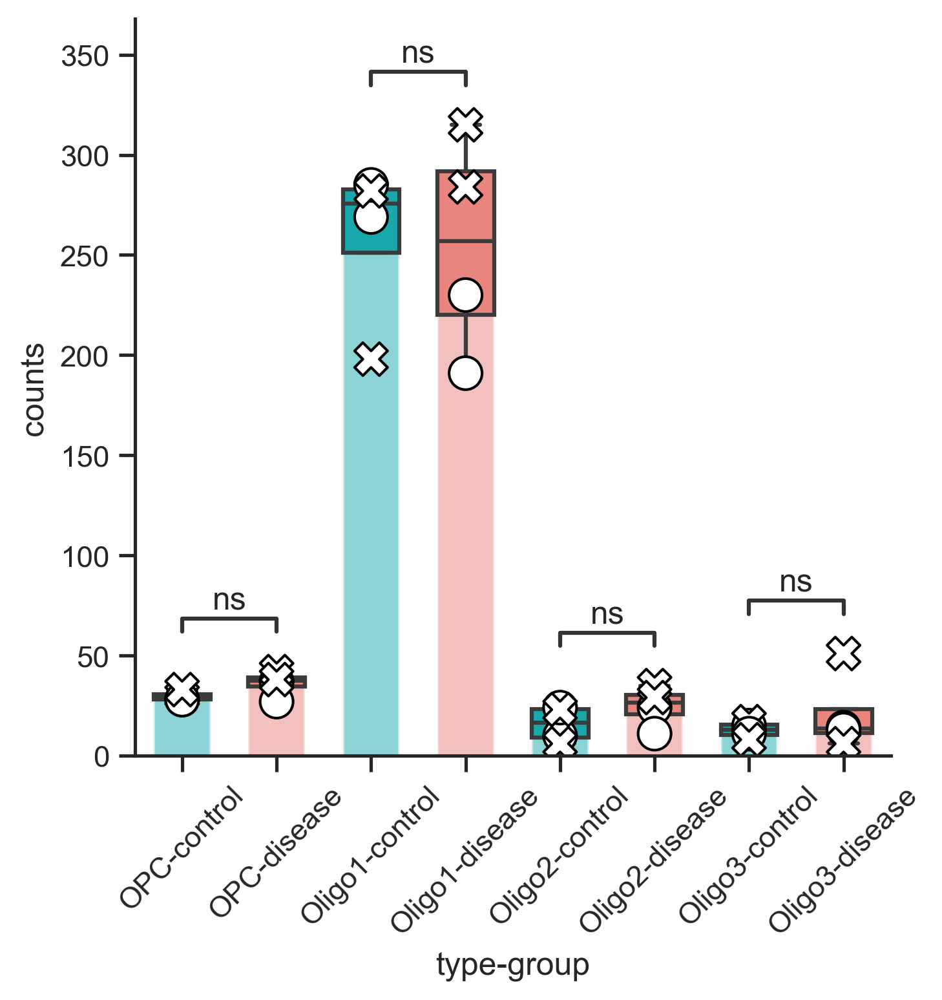

Corpus Callosum


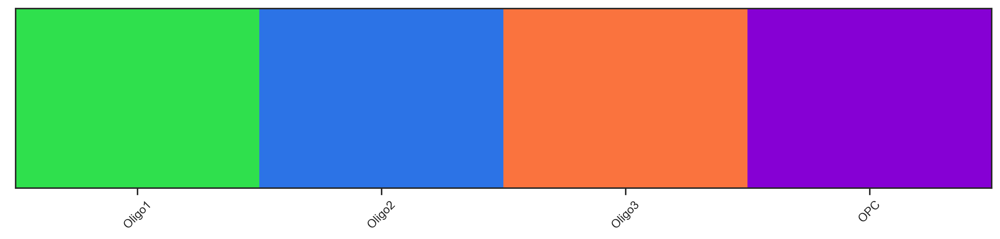

ADmouse_9723
Corpus Callosum, ADmouse_9723, 319855.260375
ADmouse_9735
Corpus Callosum, ADmouse_9735, 374779.5723
ADmouse_9494
Corpus Callosum, ADmouse_9494, 398250.2538
ADmouse_9498
Corpus Callosum, ADmouse_9498, 297507.40897499997
ADmouse_9723_2
Corpus Callosum, ADmouse_9723_2, 257129.08515000003
ADmouse_9707
Corpus Callosum, ADmouse_9707, 216047.05762500002
ADmouse_11346
Corpus Callosum, ADmouse_11346, 233061.46605000002
ADmouse_11351
Corpus Callosum, ADmouse_11351, 180859.09432499998
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

OPC-control v.s. OPC-disease: t-test independent samples, P_val=7.182e-01 stat=-6.112e-01
Oligo1-control v.s. Oligo1-disease: t-test independent samples, P_val=1.006e-01 stat=1.435e+00
Oligo2-control v.s. Oligo2-disease: t-test independent samples, P_val=9.711e-01 stat=-2.340e+00
Oligo3-control v.s. Oligo3-disease: t-test independent samples

meta NOT subset; don't know how to subset; dropped


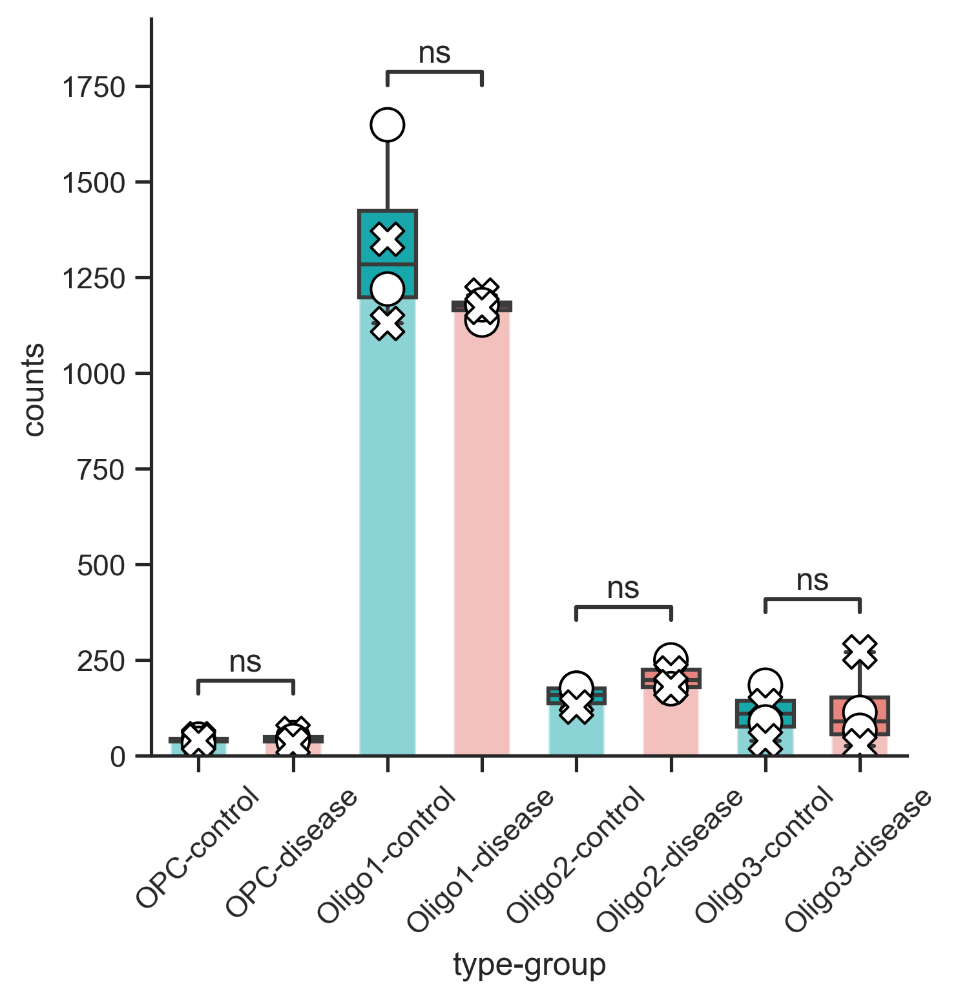

Hippocampus


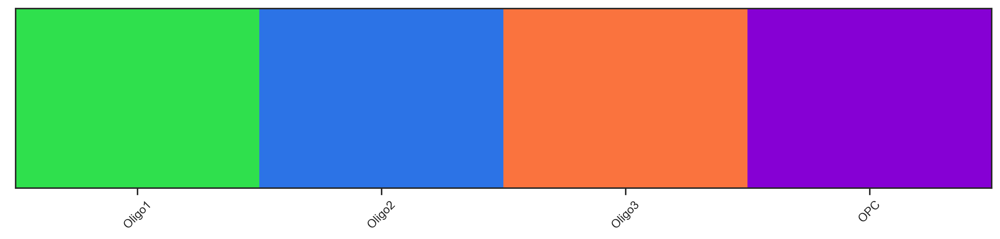

ADmouse_9723
Hippocampus, ADmouse_9723, 1637784.036
ADmouse_9735
Hippocampus, ADmouse_9735, 1917025.3131750003
ADmouse_9494
Hippocampus, ADmouse_9494, 2567077.460325
ADmouse_9498
Hippocampus, ADmouse_9498, 1753357.0493250003
ADmouse_9723_2
Hippocampus, ADmouse_9723_2, 1904689.661175
ADmouse_9707
Hippocampus, ADmouse_9707, 2067523.542
ADmouse_11346
Hippocampus, ADmouse_11346, 2522482.967025
ADmouse_11351
Hippocampus, ADmouse_11351, 2171744.52075
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

OPC-control v.s. OPC-disease: t-test independent samples, P_val=3.306e-01 stat=4.606e-01
Oligo1-control v.s. Oligo1-disease: t-test independent samples, P_val=8.107e-01 stat=-9.503e-01
Oligo2-control v.s. Oligo2-disease: t-test independent samples, P_val=9.950e-01 stat=-3.715e+00
Oligo3-control v.s. Oligo3-disease: t-test independent samples, P_val=8.356e-01 stat=-1.063e+00


meta NOT subset; don't know how to subset; dropped


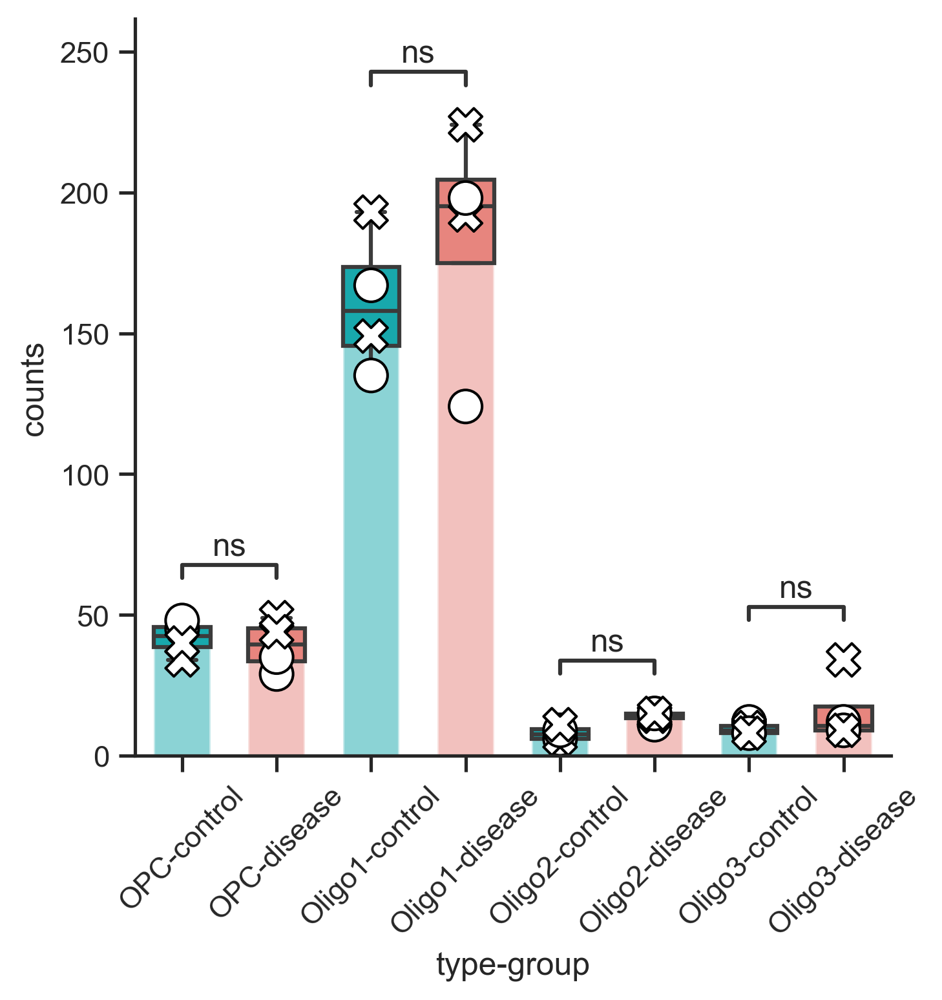

In [34]:
# Subset of regions
# sub_id = ['CTX-Ex']
sub_id = ['Oligo', 'OPC']

folder_name = 'Oligo_OPC'

width = .6

# stat alternative
alternative = 'greater'

all_list = []

region_list = ['Cortex', 'Corpus Callosum', 'Hippocampus']
# region_list = ['Cortex', 'Hippocampus']
# region_list = ['Hippocampus']
# region_list = region_list[0:1]

show_colormap = True

# Iterate region 
for r, current_region in enumerate(region_list):
    print(current_region)
    if current_region == 'Cortex':
        current_index = (adata.obs['region_merged'] == current_region) & (~adata.obs['top_level'].isin(['CA1', 'CA2', 'CA3', 'DG', 'LHb']))
    elif current_region == 'Corpus Callosum':
        current_index = (adata.obs['region_merged'] == current_region) & (~adata.obs['top_level'].isin(['CTX-Ex', 'Inh', 'CA1', 'CA2', 'CA3', 'DG', 'LHb']))
    elif current_region == 'Hippocampus':
        current_index = (adata.obs['region_merged'] == current_region)#  & (~adata.obs['top_level'].isin(['CTX-Ex']))
    elif current_region == 'Subcortical':
        current_index = (adata.obs['region_merged'].isin(['Corpus Callosum', 'Hippocampus'])) & (~adata.obs['top_level'].isin(['CTX-Ex']))
    
    current_index

    # cell type Subset
    rdata = adata[current_index, :]
    curr_cells = rdata.obs['top_level'].isin(sub_id)
    pdata = rdata[curr_cells, :]

    # Check color legend
    current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in pdata.obs['cell_type'].unique()]
    sub_cpl = []
    for i in current_cell_type_order:
        sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

    sub_cpl = sns.color_palette(sub_cpl)
    sub_cmap = ListedColormap(sub_cpl.as_hex())
    if show_colormap:
        sns.palplot(sub_cpl, size=3)
        plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
        plt.tight_layout()
        # plt.savefig(f'./figures/color_legend_top.png')
        plt.show()
    
    # normalized barplot
    region_dict = {'Cortex':1, 'Corpus Callosum':2, 'Hippocampus':3}

    n_cat = pdata.obs['cell_type'].cat.categories.shape[0]
    n_sample = pdata.obs['sample'].cat.categories.shape[0]
    count_df = pd.DataFrame(np.zeros([n_sample, n_cat]), columns=pdata.obs['cell_type'].cat.categories)
    count_df_index_list = []
    cell_dist_list = []
    for i, sample in enumerate(pdata.obs['sample'].cat.categories):
        if i >= 0:
            print(sample)
            curr_cells = (pdata.obs['sample'] == sample)
            temp = pdata[curr_cells, :]

            cell_dist = pd.DataFrame(temp.obs['cell_type'].value_counts())
            cell_dist['counts'] = cell_dist['cell_type']
            cell_dist['cell_type'] = cell_dist.index
            cell_dist['cell_type'] = cell_dist['cell_type'].astype(object)
            cell_dist = cell_dist.reset_index(drop=True)
            # cell_dist = cell_dist.loc[cell_dist['counts'] != 0, :]
            # cell_dist['cell_type'] = cell_dist['cell_type'].astype('category')

            for j in current_cell_type_order:
                if j not in cell_dist['cell_type'].unique():
                    cell_dist = cell_dist.append({'cell_type': j, 'counts': 0}, ignore_index=True)

            cell_dist['cell_type'] = cell_dist['cell_type'].astype('category')
            cell_dist['cell_type'] = cell_dist['cell_type'].cat.reorder_categories(current_cell_type_order)
            cell_dist['sample'] = pdata.obs.loc[pdata.obs['sample'] == sample, 'group'].unique()[0]
            cell_dist['time'] = pdata.obs.loc[pdata.obs['sample'] == sample, 'time'].unique()[0]

            region_areas = {}
            for k, region in enumerate(regionprops(pdata.uns[f'{sample}_morph']['region_merged'])):
                # print(region.area)
                region_areas[region.label] = region.area

            current_area = 0
            if current_region == 'Subcortical':
                current_area = (region_areas[2] + region_areas[3]) * 0.315 * 0.315
            else:
                current_area = region_areas[region_dict[current_region]] * 0.315 * 0.315

            print(f"{current_region}, {sample}, {current_area}")
            # print(cell_dist)
            cell_dist['counts'] = cell_dist['counts'] / current_area * 1000000
            cell_dist['counts'] = cell_dist['counts'].round()
            cell_dist['counts'] = cell_dist['counts'].astype(int)
            cell_dist['region'] = current_region
            cell_dist = cell_dist.reset_index(drop=True)

            # print(cell_dist.shape)
            cell_dist_list.append(cell_dist)
            
            count_df_index_list.append(temp.obs['group'].cat.categories[0])
            for j in cell_dist['cell_type'].cat.categories:
                count_df.loc[i, j] = cell_dist.loc[cell_dist['cell_type'] == j, 'counts'].values
    
    count_df['group'] = count_df_index_list
    
    test_df = pd.concat(cell_dist_list)
    test_df = test_df.reset_index(drop=True)
    test_df['type-group'] = test_df['cell_type'].astype(str) + '-' + test_df['sample'].astype(str)
    test_df['type-group'] = test_df['type-group'].astype('category')
    
    sns.set_theme(style="ticks")
    f, ax = plt.subplots(figsize=(5, 5))

    cf_pl = sns.color_palette(['#00bfc4', '#f8766d'])
    sns.barplot(y="counts", x="type-group", data=test_df, palette=cf_pl, ci=None, alpha=.5, ax=ax, zorder=0)
    change_width(ax, width)
    sns.boxplot(y="counts", x="type-group", data=test_df, width=width, palette=cf_pl, fliersize=0, ax=ax, zorder=1)
    sns.scatterplot(y="counts",x="type-group", data=test_df, facecolors='white', style="time", edgecolor='black', s=150, ax=ax, legend=False, zorder=2)
    sns.despine()

    add_stat_annotation(ax, data=test_df, x='type-group', y='counts',
                        box_pairs=[((test_df['type-group'].cat.categories[0]), (test_df['type-group'].cat.categories[1])),
                                  ((test_df['type-group'].cat.categories[2]), (test_df['type-group'].cat.categories[3])),
                                   ((test_df['type-group'].cat.categories[4]), (test_df['type-group'].cat.categories[5])),
                                   ((test_df['type-group'].cat.categories[6]), (test_df['type-group'].cat.categories[7]))],
                        test='t-test_ind', text_format='star', verbose=2, comparisons_correction=None, stats_params={'alternative': alternative})


    plt.xticks(rotation=45)
    current_fig_out_path = os.path.join(fig_path, folder_name)
    if not os.path.exists(current_fig_out_path):
        os.mkdir(current_fig_out_path)
        
    plt.savefig(os.path.join(current_fig_out_path, f'cluster_density_{alternative}_{current_region}_large.pdf'))
    plt.show()

##### all region

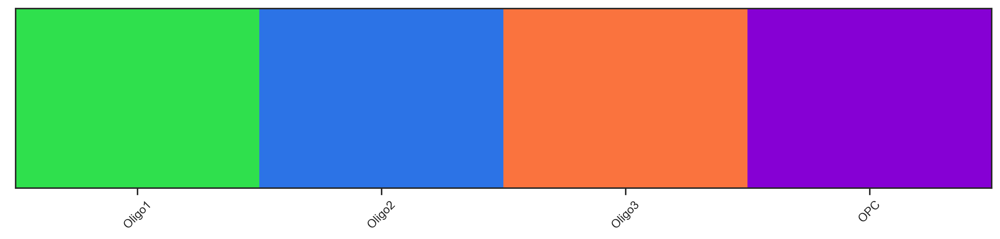

ADmouse_9723, 3892776.1488
ADmouse_9735, 3933413.946
ADmouse_9494, 4431595.781025
ADmouse_9498, 3784044.79845
ADmouse_9723_2, 4458298.32
ADmouse_9707, 4458044.5024500005
ADmouse_11346, 4529623.2345
ADmouse_11351, 4462404.6474
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

OPC-control v.s. OPC-disease: t-test independent samples, P_val=2.812e-01 stat=-6.128e-01
Oligo1-control v.s. Oligo1-disease: t-test independent samples, P_val=4.458e-01 stat=-1.421e-01
Oligo2-control v.s. Oligo2-disease: t-test independent samples, P_val=2.585e-02 stat=-2.422e+00
Oligo3-control v.s. Oligo3-disease: t-test independent samples, P_val=2.891e-01 stat=-5.875e-01


meta NOT subset; don't know how to subset; dropped


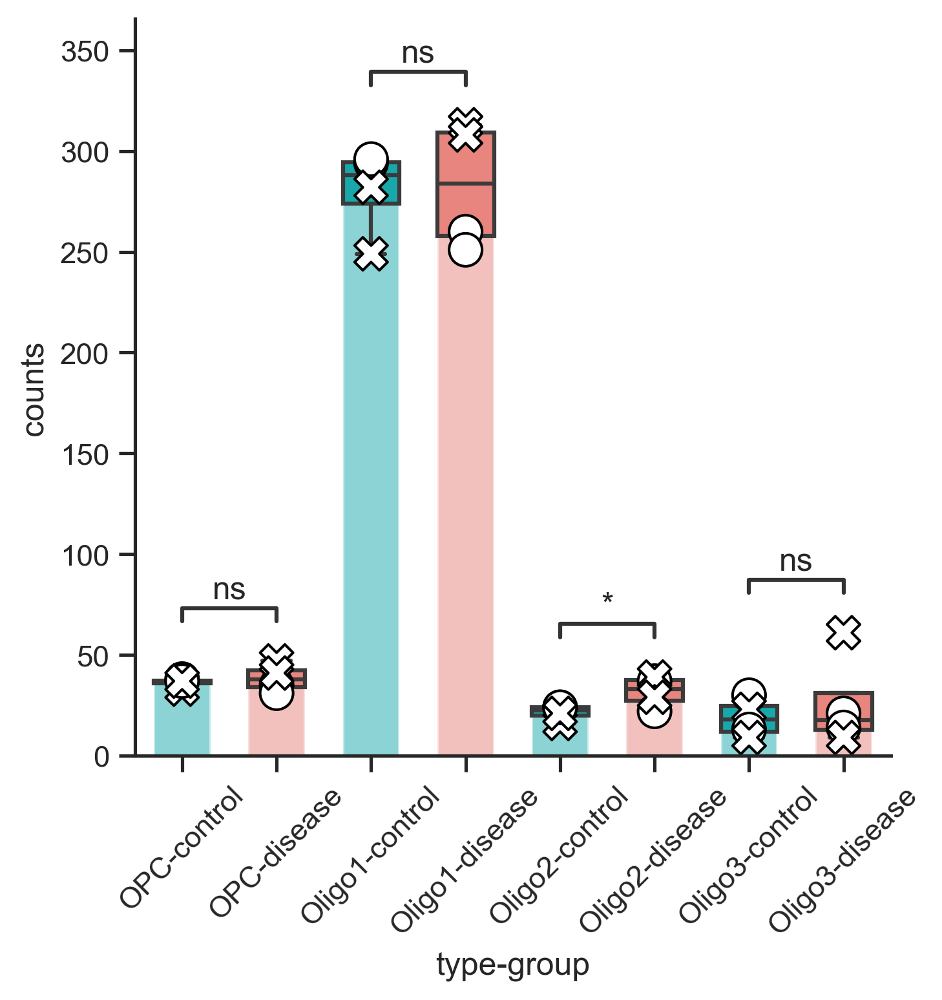

In [33]:
# Subset of regions
# sub_id = ['CTX-Ex']
sub_id = ['Oligo', 'OPC']

folder_name = 'Oligo_OPC'

width = .6

# stat alternative
alternative = 'less'

all_list = []

show_colormap = True

# cell type Subset
curr_cells = adata.obs['top_level'].isin(sub_id)
pdata = adata[curr_cells, :]

# Check color legend
current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in pdata.obs['cell_type'].unique()]
sub_cpl = []
for i in current_cell_type_order:
    sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

sub_cpl = sns.color_palette(sub_cpl)
sub_cmap = ListedColormap(sub_cpl.as_hex())
if show_colormap:
    sns.palplot(sub_cpl, size=3)
    plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
    plt.tight_layout()
    plt.show()

# normalized barplot
n_cat = pdata.obs['cell_type'].cat.categories.shape[0]
n_sample = pdata.obs['sample'].cat.categories.shape[0]
count_df = pd.DataFrame(np.zeros([n_sample, n_cat]), columns=pdata.obs['cell_type'].cat.categories)
count_df_index_list = []
cell_dist_list = []
for i, sample in enumerate(pdata.obs['sample'].cat.categories):
    if i >= 0:
        curr_cells = (pdata.obs['sample'] == sample)
        temp = pdata[curr_cells, :]

        cell_dist = pd.DataFrame(temp.obs['cell_type'].value_counts())
        cell_dist['counts'] = cell_dist['cell_type']
        cell_dist['cell_type'] = cell_dist.index
        cell_dist['cell_type'] = cell_dist['cell_type'].astype(object)
        cell_dist = cell_dist.reset_index(drop=True)
        
        for j in current_cell_type_order:
            if j not in cell_dist['cell_type'].unique():
                cell_dist = cell_dist.append({'cell_type': j, 'counts': 0}, ignore_index=True)

        cell_dist['cell_type'] = cell_dist['cell_type'].astype('category')
        cell_dist['cell_type'] = cell_dist['cell_type'].cat.reorder_categories(current_cell_type_order)
        cell_dist['sample'] = pdata.obs.loc[pdata.obs['sample'] == sample, 'group'].unique()[0]
        cell_dist['time'] = pdata.obs.loc[pdata.obs['sample'] == sample, 'time'].unique()[0]

        current_img = pdata.uns[f'{sample}_morph']['region_merged']
        current_area = current_img.shape[0] * current_img.shape[1] * 0.315 * 0.315

        print(f"{sample}, {current_area}")

        cell_dist['counts'] = cell_dist['counts'] / current_area * 1000000
        cell_dist['counts'] = cell_dist['counts'].round()
        cell_dist['counts'] = cell_dist['counts'].astype(int)

        cell_dist = cell_dist.reset_index(drop=True)

        cell_dist_list.append(cell_dist)

        count_df_index_list.append(temp.obs['group'].cat.categories[0])
        for j in cell_dist['cell_type'].cat.categories:
            count_df.loc[i, j] = cell_dist.loc[cell_dist['cell_type'] == j, 'counts'].values

count_df['group'] = count_df_index_list

test_df = pd.concat(cell_dist_list)
test_df = test_df.reset_index(drop=True)
test_df['type-group'] = test_df['cell_type'].astype(str) + '-' + test_df['sample'].astype(str)
test_df['type-group'] = test_df['type-group'].astype('category')

sns.set_theme(style="ticks")
f, ax = plt.subplots(figsize=(5, 5))

cf_pl = sns.color_palette(['#00bfc4', '#f8766d'])
sns.barplot(y="counts", x="type-group", data=test_df, palette=cf_pl, ci=None, alpha=.5, ax=ax, zorder=0)
change_width(ax, width)
sns.boxplot(y="counts", x="type-group", data=test_df, width=width, palette=cf_pl, fliersize=0, ax=ax, zorder=1)
sns.scatterplot(y="counts",x="type-group", data=test_df, facecolors='white', style="time", edgecolor='black', s=150, ax=ax, legend=False, zorder=2)
sns.despine()

add_stat_annotation(ax, data=test_df, x='type-group', y='counts',
                    box_pairs=[((test_df['type-group'].cat.categories[0]), (test_df['type-group'].cat.categories[1])),
                              ((test_df['type-group'].cat.categories[2]), (test_df['type-group'].cat.categories[3])),
                               ((test_df['type-group'].cat.categories[4]), (test_df['type-group'].cat.categories[5])),
                               ((test_df['type-group'].cat.categories[6]), (test_df['type-group'].cat.categories[7]))],
                    test='t-test_ind', text_format='star', verbose=2, comparisons_correction=None, stats_params={'alternative': alternative})


plt.xticks(rotation=45)
current_fig_out_path = os.path.join(fig_path, folder_name)
if not os.path.exists(current_fig_out_path):
    os.mkdir(current_fig_out_path)

plt.savefig(os.path.join(current_fig_out_path, f'cluster_density_{alternative}_overall_large.pdf'))
plt.show()

#### Spatial map

##### label

In [ ]:
# Restore convex hull and top-level info
for sample in sorted(sdata.obs['sample'].unique()):
    print(sample)
    
    current_key = f"{sample}_morph"

    current_index = sdata.obs['sample'] == sample
    sdata.uns[current_key]['good_cells'] = sdata.obs.loc[current_index, 'orig_index'].astype(int).values
    sdata.uns[current_key]['colors'] = sdata.obs.loc[current_index, 'cell_type'].cat.codes.values

In [ ]:
# Spatial cell type map

for sample in sorted(sdata.obs['sample'].unique()):
    print(sample)
    su.plot_poly_cells_cluster_by_sample(sdata, sample, sub_cmap, show_plaque=True, show_tau=True, 
                                         save_as_real_size=True, linewidth=0.5,
                                        figscale=3, width=10, height=10, save=True, show=False, output_dir=sub_level_fig_path)

In [ ]:
# Spatial cell type map
sub_level_fig_path = os.path.join(sub_level_fig_path, 'sct-05')
if not os.path.exists(sub_level_fig_path):
    os.mkdir(sub_level_fig_path)
    
for sample in sorted(sdata.obs['sample'].unique()):
    print(sample)
    su.plot_poly_cells_cluster_by_sample(sdata, sample, sub_cmap, show_plaque=True, show_tau=True, 
                                         save_as_real_size=True, linewidth=0.5,
                                        figscale=3, width=10, height=10, save=True, show=False, output_dir=sub_level_fig_path)

### Others

#### DG

In [ ]:
# Subset (DG & 13 mo)
curr_cells = (adata.obs['top_level'] == 'DG') & (adata.obs['time'] == '13months')
sdata = adata[curr_cells, :]
sdata

In [ ]:
sub_level_fig_path = os.path.join(fig_path, 'DG_13mo')
if not os.path.exists(sub_level_fig_path):
    os.mkdir(sub_level_fig_path)

In [ ]:
sc.settings.figdir = sub_level_fig_path
sc.set_figure_params(format='tif', dpi=150)

In [ ]:
# Embedding parameters
emb_dict = {
    'DG': {'n_neighbors': 15, 'n_pcs': 15, 'min_dist': 1, 'cluster_resolution': .2},
           }

save_embedding = False

In [ ]:
# Filter gene by max counts
n = 5

sdata.var['detected'] = sdata.var['max_counts'] > n
sdata.var['highly_variable'] = sdata.var['max_counts'] > n
print(sdata.var['detected'].sum())

In [ ]:
sdata.var.loc['Cemip', 'highly_variable'] = False
sdata.var.loc['Lrrtm4', 'highly_variable'] = False

In [ ]:
# load DEG
deg_df = pd.read_excel(os.path.join(base_path, 'gene-module', '2022-04-21-DG-DEG.xlsx'))
deg_df

In [ ]:
sdata.var.loc[:, 'highly_variable'] = False
sdata.var.loc[sdata.var.index.isin(deg_df['gene']), 'highly_variable'] = True

#### Embedding

In [ ]:
sdata.var['highly_variable'].value_counts()

In [ ]:
# Run PCA
sc.tl.pca(sdata, svd_solver='arpack', use_highly_variable=True, n_comps=50)

# Plot explained variance 
sc.pl.pca_variance_ratio(sdata, log=False)

# Plot PCA
sc.pl.pca(sdata, color='sample')

In [ ]:
%%time
# Computing the neighborhood graph
n_neighbors = 15
n_pcs = 5
min_dist = 1

sc.pp.neighbors(sdata, n_neighbors=n_neighbors, n_pcs=n_pcs, metric='cosine')

# Run UMAP
sc.tl.umap(sdata, min_dist=min_dist)
sc.tl.diffmap(sdata, n_comps=n_pcs)

In [ ]:
%%time
# Run leiden cluster
cluster_resolution = 0.3
sc.tl.leiden(sdata, resolution = cluster_resolution)

# Plot UMAP with cluster labels 
sc.pl.umap(sdata, color='leiden')
sc.pl.diffmap(sdata, color='leiden')
n_clusters = sdata.obs['leiden'].unique().shape[0]

if save_embedding:
    # Save log
    with open(f'{fig_path}/log_{sub_id}.txt', 'w') as f:
        f.write(f"""Number of neighbor: {n_neighbors}
    Number of PC: {n_pcs}
    Resolution: {cluster_resolution}
    Min-distance: {min_dist}
    Number of clusters: {n_clusters}""")

    # save embeddings
    np.savetxt(f'{fig_path}/embedding_DG_13mo_umap.csv', sdata.obsm['X_umap'], delimiter=",")
    np.savetxt(f'{fig_path}/embedding_DG_13mo_diffmap.csv', sdata.obsm['X_diffmap'], delimiter=",")

In [ ]:
sc.pl.umap(sdata, color='time-group')
sc.pl.diffmap(sdata, color='time-group')

In [ ]:
# Add log layer
sdata.layers['log_raw'] = np.log1p(sdata.layers['raw'])
sc.pp.normalize_total(sdata, layer='log_raw')

# Find gene markers for each cluster
sc.tl.rank_genes_groups(sdata, 'leiden', method='wilcoxon', layer='log_raw', pts=True, use_raw=False, n_genes=adata.shape[1])

# Filter markers
sc.tl.filter_rank_genes_groups(sdata, min_fold_change=.1, min_in_group_fraction=0.15, max_out_group_fraction=0.85)

In [ ]:
temp = pd.DataFrame(sdata.uns['rank_genes_groups_filtered']['names']).head(10)
temp_genes = []
for i in range(temp.shape[1]):
    current_genes = temp.iloc[:, i].to_list()
    current_genes = [x for x in current_genes if str(x) != 'nan']
    current_genes = current_genes[:5]
    print(i, current_genes)

    

In [ ]:
current_cell_type = '1'

current_df = sc.get.rank_genes_groups_df(sdata, group=current_cell_type, key='rank_genes_groups')
current_df.head(20)

In [ ]:
sc.pl.rank_genes_groups(sdata)

In [ ]:
### Get colormap 
cluster_pl = sns.color_palette('Set2', n_clusters)
sns.palplot(cluster_pl)
cluster_cmap = ListedColormap(cluster_pl)

for current_sample in sdata.obs['sample'].unique():
    current_data = sdata[sdata.obs['sample'] == current_sample, :]
    
    fig, ax = plt.subplots()
    # plt.scatter(x=, y=, c=, s=, )
    sns.scatterplot(x='x', y='y', hue='leiden', data=current_data.obs, palette=cluster_pl, s=1)
    plt.show()

#### Tau positive cell type composition

8months
13months
8months
13months


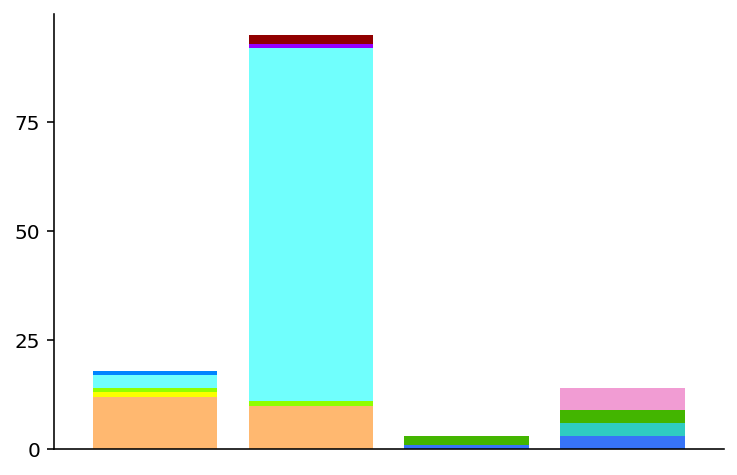

In [46]:
tau_threshold = 7

tau_df_total_list = []
for plot_group in ['CTX-Ex', 'Inh']:
    
    tau_df_list = []
    
    for time in ['8months', '13months']:
        print(time)
        current_tau_df = adata.obs.loc[(adata.obs['tau'] > tau_threshold) & (adata.obs['time'] == time), ]
        if plot_group == 'CTX-Ex':
            current_tau_df = current_tau_df.loc[current_tau_df['top_level'].isin(['CTX-Ex', 'CA1', 'CA2', 'CA3', 'DG']), ]
        elif plot_group == 'Inh':
            current_tau_df = current_tau_df.loc[current_tau_df['top_level'].isin(['Inh']), ]

        current_tau_df = pd.DataFrame(current_tau_df['cell_type'].value_counts())
        current_tau_df['time'] = time
        # current_tau_df = current_tau_df.loc[current_tau_df['cell_type_label'] != 0, ]
        tau_df_list.append(current_tau_df)

    tau_df_total = pd.concat(tau_df_list)
    tau_df_total['counts'] = tau_df_total['cell_type']

    if plot_group == 'CTX-Ex':
        current_order = ['CTX-Ex1', 'CTX-Ex2', 'CTX-Ex3', 'CTX-Ex4', 'CA1-Ex', 'CA2-Ex', 'CA3-Ex', 'DG']
        tau_df_total = tau_df_total.loc[current_order, ]
    elif plot_group == 'Inh':
        current_order = ['Cnr1', 'Lamp5', 'Pvalb', 'Pvalb_Nog', 'Sst', 'Vip']
        tau_df_total = tau_df_total.loc[current_order, ]

    tau_df_total['cell_type'] = tau_df_total.index
    tau_df_total['cell_type'] = tau_df_total['cell_type'].astype(object)
    tau_df_total['cell_type'] = tau_df_total['cell_type'].astype('category')
    tau_df_total['cell_type'] = tau_df_total['cell_type'].cat.reorder_categories(current_order)
    tau_df_total = tau_df_total.reset_index(drop=True)
    tau_df_total['time'] = tau_df_total['time'].astype('category')
    tau_df_total['time'] = tau_df_total['time'].cat.reorder_categories(['8months', '13months'])
    tau_df_total['plot_group'] = plot_group
    tau_df_total['tag'] = tau_df_total['plot_group'] + '_' + tau_df_total['time'].astype(str)
    tau_df_total_list.append(tau_df_total)

total_df = pd.concat(tau_df_total_list)
total_df['cell_type'] = total_df['cell_type'].astype('category')
total_df['cell_type'] = total_df['cell_type'].cat.reorder_categories(['CTX-Ex1', 'CTX-Ex2', 'CTX-Ex3', 'CTX-Ex4', 'CA1-Ex', 'CA2-Ex', 'CA3-Ex', 'DG',
                                                                                 'Cnr1', 'Lamp5', 'Pvalb', 'Pvalb_Nog', 'Sst', 'Vip'])

total_df['tag'] = total_df['tag'].astype('category')
total_df['tag'] = total_df['tag'].cat.reorder_categories(['CTX-Ex_8months', 'CTX-Ex_13months', 'Inh_8months', 'Inh_13months'])
total_df = total_df[['cell_type', 'tag', 'counts']]

df = total_df.pivot(columns='cell_type', index='tag').fillna(0)
sub_cmap = ListedColormap([adata.uns['cell_type_hex_dict'][c] for c in total_df['cell_type'].cat.categories])
# plot ita
fig, ax = plt.subplots()
df.plot(kind='bar', stacked=True, legend=False, cmap=sub_cmap, ax=ax, width=0.8)
#plt.setp(ax.patches, linewidth=1, edgecolor='black')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.get_xaxis().set_visible(False)
plt.locator_params(axis='y', nbins=4)
# plt.savefig(f'{fig_path}/tau_positive_composition_2766.pdf')
plt.show()

In [50]:
df.sum(axis=1)

tag
CTX-Ex_8months     18.0
CTX-Ex_13months    95.0
Inh_8months         3.0
Inh_13months       14.0
dtype: float64

#### Cluster frequencies (Fig 6 Ex)

Hippocampus


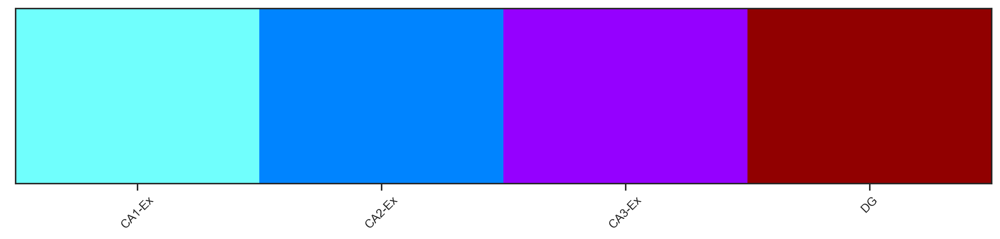

ADmouse_9723
Hippocampus, ADmouse_9723, 1637784.036
ADmouse_9735
Hippocampus, ADmouse_9735, 1917025.3131750003
ADmouse_9494
Hippocampus, ADmouse_9494, 2567077.460325
ADmouse_9498
Hippocampus, ADmouse_9498, 1753357.0493250003
ADmouse_9723_2
Hippocampus, ADmouse_9723_2, 1904689.661175
ADmouse_9707
Hippocampus, ADmouse_9707, 2067523.542
ADmouse_11346
Hippocampus, ADmouse_11346, 2522482.967025
ADmouse_11351
Hippocampus, ADmouse_11351, 2171744.52075
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

CA1-Ex-control v.s. CA1-Ex-disease: t-test independent samples, P_val=7.048e-01 stat=5.683e-01
CA2-Ex-control v.s. CA2-Ex-disease: t-test independent samples, P_val=7.179e-01 stat=6.101e-01
CA3-Ex-control v.s. CA3-Ex-disease: t-test independent samples, P_val=5.350e-01 stat=9.156e-02
DG-control v.s. DG-disease: t-test independent samples, P_val=8.270e-01 stat=1.023e+00


meta NOT subset; don't know how to subset; dropped


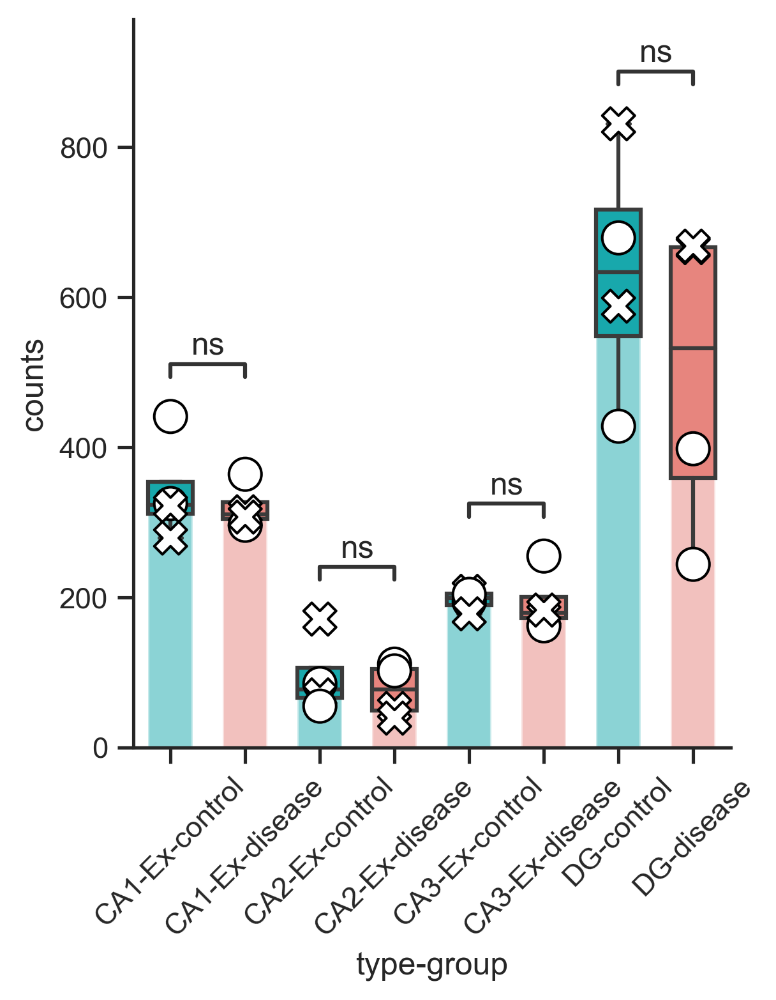

In [37]:
# Subset of regions
# sub_id = ['Inh']
# sub_id = ['CTX-Ex']
sub_id = ['CA1', 'CA2', 'CA3', 'DG']

# stat alternative
alternative = 'less'

width = .6

all_list = []

# region_list = ['Cortex', 'Corpus Callosum', 'Hippocampus']
# region_list = ['Cortex', 'Hippocampus']
# region_list = ['Cortex']
region_list = ['Hippocampus']
# region_list = region_list[0:1]

show_colormap = True

# Iterate region 
for r, current_region in enumerate(region_list):
    print(current_region)
    if current_region == 'Cortex':
        current_index = (adata.obs['region_merged'] == current_region) & (~adata.obs['top_level'].isin(['CA1', 'CA2', 'CA3', 'DG', 'LHb']))
    elif current_region == 'Corpus Callosum':
        current_index = (adata.obs['region_merged'] == current_region) & (~adata.obs['top_level'].isin(['CTX-Ex', 'Inh', 'CA1', 'CA2', 'CA3', 'DG', 'LHb']))
    elif current_region == 'Hippocampus':
        current_index = (adata.obs['region_merged'] == current_region)#  & (~adata.obs['top_level'].isin(['CTX-Ex']))
    elif current_region == 'Subcortical':
        current_index = (adata.obs['region_merged'].isin(['Corpus Callosum', 'Hippocampus'])) & (~adata.obs['top_level'].isin(['CTX-Ex']))
    
    # current_index

    # cell type Subset
    rdata = adata[current_index, :]
    curr_cells = rdata.obs['top_level'].isin(sub_id)
    pdata = rdata[curr_cells, :]

    # Check color legend
    current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in pdata.obs['cell_type'].unique()]
    sub_cpl = []
    for i in current_cell_type_order:
        sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

    sub_cpl = sns.color_palette(sub_cpl)
    sub_cmap = ListedColormap(sub_cpl.as_hex())
    if show_colormap:
        sns.palplot(sub_cpl, size=3)
        plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
        plt.tight_layout()
        # plt.savefig(f'./figures/color_legend_top.png')
        plt.show()
    
    # normalized barplot
    region_dict = {'Cortex':1, 'Corpus Callosum':2, 'Hippocampus':3}

    n_cat = pdata.obs['cell_type'].cat.categories.shape[0]
    n_sample = pdata.obs['sample'].cat.categories.shape[0]
    count_df = pd.DataFrame(np.zeros([n_sample, n_cat]), columns=pdata.obs['cell_type'].cat.categories)
    count_df_index_list = []
    cell_dist_list = []
    for i, sample in enumerate(pdata.obs['sample'].cat.categories):
        if i >= 0:
            print(sample)
            curr_cells = (pdata.obs['sample'] == sample)
            temp = pdata[curr_cells, :]

            cell_dist = pd.DataFrame(temp.obs['cell_type'].value_counts())
            cell_dist['counts'] = cell_dist['cell_type']
            cell_dist['cell_type'] = cell_dist.index
            cell_dist['cell_type'] = cell_dist['cell_type'].astype(object)
            cell_dist = cell_dist.reset_index(drop=True)
            # cell_dist = cell_dist.loc[cell_dist['counts'] != 0, :]
            # cell_dist['cell_type'] = cell_dist['cell_type'].astype('category')

            for j in current_cell_type_order:
                if j not in cell_dist['cell_type'].unique():
                    cell_dist = cell_dist.append({'cell_type': j, 'counts': 0}, ignore_index=True)

            cell_dist['cell_type'] = cell_dist['cell_type'].astype('category')
            cell_dist['cell_type'] = cell_dist['cell_type'].cat.reorder_categories(current_cell_type_order)
            cell_dist['sample'] = pdata.obs.loc[pdata.obs['sample'] == sample, 'group'].unique()[0]
            cell_dist['time'] = pdata.obs.loc[pdata.obs['sample'] == sample, 'time'].unique()[0]

            region_areas = {}
            for k, region in enumerate(regionprops(pdata.uns[f'{sample}_morph']['region_merged'])):
                # print(region.area)
                region_areas[region.label] = region.area

            current_area = 0
            if current_region == 'Subcortical':
                current_area = (region_areas[2] + region_areas[3]) * 0.315 * 0.315
            else:
                current_area = region_areas[region_dict[current_region]] * 0.315 * 0.315

            print(f"{current_region}, {sample}, {current_area}")
            # print(cell_dist)
            cell_dist['counts'] = cell_dist['counts'] / current_area * 1000000
            cell_dist['counts'] = cell_dist['counts'].round()
            cell_dist['counts'] = cell_dist['counts'].astype(int)
            cell_dist['region'] = current_region
            cell_dist = cell_dist.reset_index(drop=True)

            # print(cell_dist.shape)
            cell_dist_list.append(cell_dist)
            
            count_df_index_list.append(temp.obs['group'].cat.categories[0])
            for j in cell_dist['cell_type'].cat.categories:
                count_df.loc[i, j] = cell_dist.loc[cell_dist['cell_type'] == j, 'counts'].values
    
    count_df['group'] = count_df_index_list
    
    
    test_df = pd.concat(cell_dist_list)
    test_df = test_df.reset_index(drop=True)
    test_df['type-group'] = test_df['cell_type'].astype(str) + '-' + test_df['sample'].astype(str)
    test_df['type-group'] = test_df['type-group'].astype('category')
    
    sns.set_theme(style="ticks")
    f, ax = plt.subplots(figsize=(4, 5))

    cf_pl = sns.color_palette(['#00bfc4', '#f8766d'])
    sns.barplot(y="counts", x="type-group", data=test_df, palette=cf_pl, ci=None, alpha=.5, ax=ax, zorder=0)
    change_width(ax, width)
    sns.boxplot(y="counts", x="type-group", data=test_df, width=width, palette=cf_pl, fliersize=0, ax=ax, zorder=1)
    sns.scatterplot(y="counts",x="type-group", data=test_df, facecolors='white', style="time", edgecolor='black', s=150, ax=ax, legend=False, zorder=2)
    sns.despine()

    add_stat_annotation(ax, data=test_df, x='type-group', y='counts',
                        box_pairs=[((test_df['type-group'].cat.categories[0]), (test_df['type-group'].cat.categories[1])),
                                  ((test_df['type-group'].cat.categories[2]), (test_df['type-group'].cat.categories[3])),
                                   ((test_df['type-group'].cat.categories[4]), (test_df['type-group'].cat.categories[5])),
                                  ((test_df['type-group'].cat.categories[6]), (test_df['type-group'].cat.categories[7])),],
                        test='t-test_ind', text_format='star', verbose=2, comparisons_correction=None, stats_params={'alternative': alternative})


    plt.xticks(rotation=45)
    current_fig_out_path = os.path.join(fig_path, sub_id[0])
    if not os.path.exists(current_fig_out_path):
        os.mkdir(current_fig_out_path)
    plt.savefig(os.path.join(current_fig_out_path, f'cluster_density_{alternative}_{current_region}_large.pdf'))
    plt.show()

#### Cluster frequencies (Fig 6 Inh)

Cortex


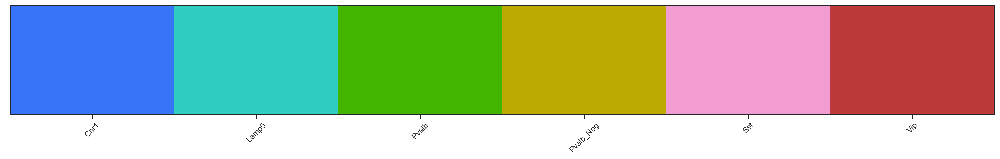

ADmouse_9723
Cortex, ADmouse_9723, 1935136.852425
ADmouse_9735
Cortex, ADmouse_9735, 1641609.060525
ADmouse_9494
Cortex, ADmouse_9494, 1466268.0669
ADmouse_9498
Cortex, ADmouse_9498, 1733180.3401499998
ADmouse_9723_2
Cortex, ADmouse_9723_2, 2296479.573675
ADmouse_9707
Cortex, ADmouse_9707, 2174473.9028249998
ADmouse_11346
Cortex, ADmouse_11346, 1774078.8014250002
ADmouse_11351
Cortex, ADmouse_11351, 2109801.032325
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Cnr1-control v.s. Cnr1-disease: t-test independent samples, P_val=1.141e-01 stat=1.342e+00
Lamp5-control v.s. Lamp5-disease: t-test independent samples, P_val=1.422e-01 stat=1.175e+00
Pvalb-control v.s. Pvalb-disease: t-test independent samples, P_val=1.091e-01 stat=1.375e+00
Pvalb_Nog-control v.s. Pvalb_Nog-disease: t-test independent samples, P_val=1.727e-01 stat=1.024e+00
Sst-control v.s. Sst-disease: t-test ind

meta NOT subset; don't know how to subset; dropped


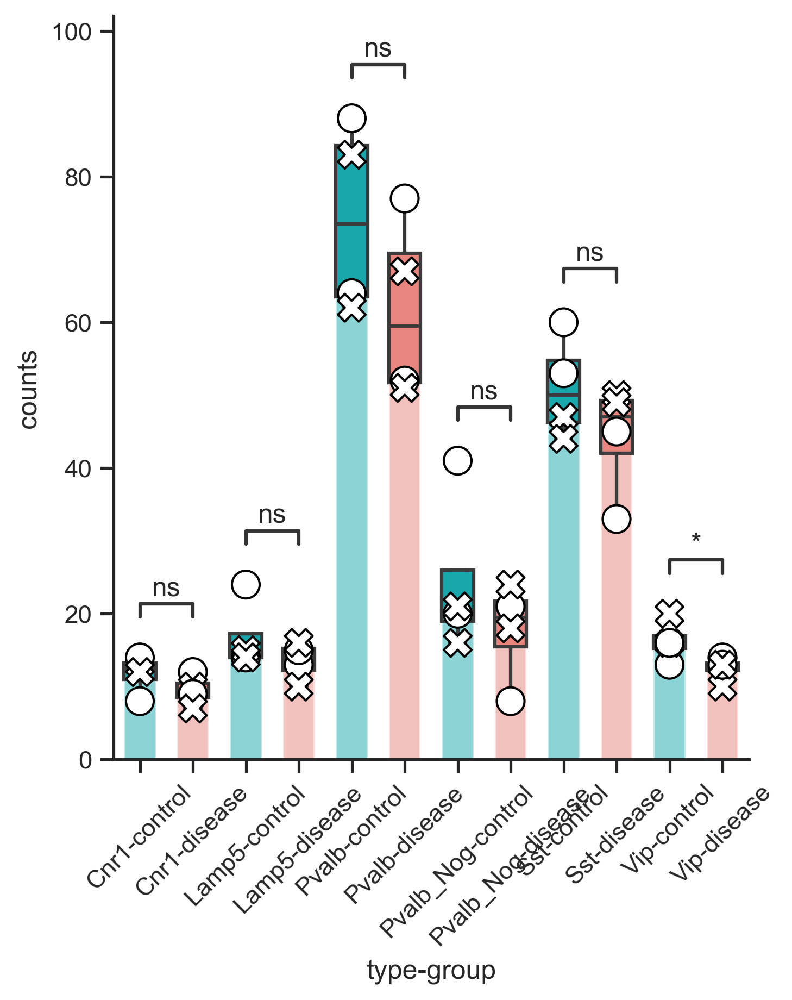

Hippocampus


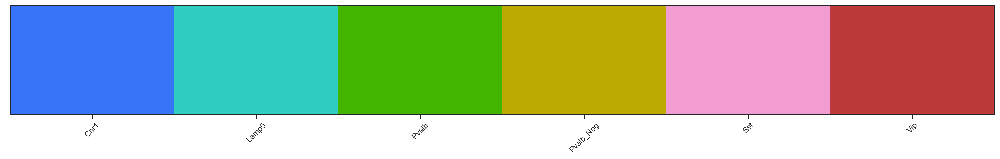

ADmouse_9723
Hippocampus, ADmouse_9723, 1637784.036
ADmouse_9735
Hippocampus, ADmouse_9735, 1917025.3131750003
ADmouse_9494
Hippocampus, ADmouse_9494, 2567077.460325
ADmouse_9498
Hippocampus, ADmouse_9498, 1753357.0493250003
ADmouse_9723_2
Hippocampus, ADmouse_9723_2, 1904689.661175
ADmouse_9707
Hippocampus, ADmouse_9707, 2067523.542
ADmouse_11346
Hippocampus, ADmouse_11346, 2522482.967025
ADmouse_11351
Hippocampus, ADmouse_11351, 2171744.52075
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Cnr1-control v.s. Cnr1-disease: t-test independent samples, P_val=1.934e-01 stat=9.333e-01
Lamp5-control v.s. Lamp5-disease: t-test independent samples, P_val=1.934e-01 stat=9.333e-01
Pvalb-control v.s. Pvalb-disease: t-test independent samples, P_val=9.188e-01 stat=-1.593e+00
Pvalb_Nog-control v.s. Pvalb_Nog-disease: t-test independent samples, P_val=1.192e-01 stat=1.309e+00
Sst-cont

meta NOT subset; don't know how to subset; dropped


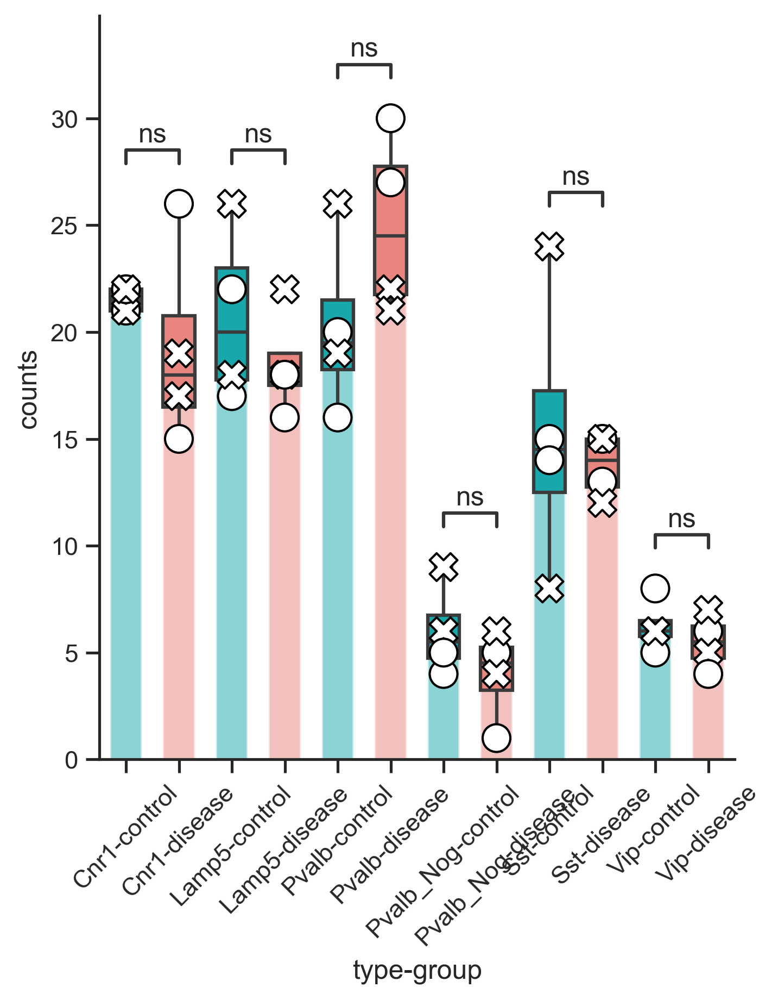

In [41]:
# Subset of regions
sub_id = ['Inh']

# stat alternative
alternative = 'greater'

width = .6

all_list = []

# region_list = ['Cortex', 'Corpus Callosum', 'Hippocampus']
region_list = ['Cortex', 'Hippocampus']
# region_list = ['Cortex']
# region_list = ['Hippocampus']
# region_list = region_list[0:1]

show_colormap = True

# Iterate region 
for r, current_region in enumerate(region_list):
    print(current_region)
    if current_region == 'Cortex':
        current_index = (adata.obs['region_merged'] == current_region) & (~adata.obs['top_level'].isin(['CA1', 'CA2', 'CA3', 'DG', 'LHb']))
    elif current_region == 'Corpus Callosum':
        current_index = (adata.obs['region_merged'] == current_region) & (~adata.obs['top_level'].isin(['CTX-Ex', 'Inh', 'CA1', 'CA2', 'CA3', 'DG', 'LHb']))
    elif current_region == 'Hippocampus':
        current_index = (adata.obs['region_merged'] == current_region)#  & (~adata.obs['top_level'].isin(['CTX-Ex']))
    elif current_region == 'Subcortical':
        current_index = (adata.obs['region_merged'].isin(['Corpus Callosum', 'Hippocampus'])) & (~adata.obs['top_level'].isin(['CTX-Ex']))
    
    # current_index

    # cell type Subset
    rdata = adata[current_index, :]
    curr_cells = rdata.obs['top_level'].isin(sub_id)
    pdata = rdata[curr_cells, :]

    # Check color legend
    current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in pdata.obs['cell_type'].unique()]
    sub_cpl = []
    for i in current_cell_type_order:
        sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

    sub_cpl = sns.color_palette(sub_cpl)
    sub_cmap = ListedColormap(sub_cpl.as_hex())
    if show_colormap:
        sns.palplot(sub_cpl, size=3)
        plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
        plt.tight_layout()
        # plt.savefig(f'./figures/color_legend_top.png')
        plt.show()
    
    # normalized barplot
    region_dict = {'Cortex':1, 'Corpus Callosum':2, 'Hippocampus':3}

    n_cat = pdata.obs['cell_type'].cat.categories.shape[0]
    n_sample = pdata.obs['sample'].cat.categories.shape[0]
    count_df = pd.DataFrame(np.zeros([n_sample, n_cat]), columns=pdata.obs['cell_type'].cat.categories)
    count_df_index_list = []
    cell_dist_list = []
    for i, sample in enumerate(pdata.obs['sample'].cat.categories):
        if i >= 0:
            print(sample)
            curr_cells = (pdata.obs['sample'] == sample)
            temp = pdata[curr_cells, :]

            cell_dist = pd.DataFrame(temp.obs['cell_type'].value_counts())
            cell_dist['counts'] = cell_dist['cell_type']
            cell_dist['cell_type'] = cell_dist.index
            cell_dist['cell_type'] = cell_dist['cell_type'].astype(object)
            cell_dist = cell_dist.reset_index(drop=True)
            # cell_dist = cell_dist.loc[cell_dist['counts'] != 0, :]
            # cell_dist['cell_type'] = cell_dist['cell_type'].astype('category')

            for j in current_cell_type_order:
                if j not in cell_dist['cell_type'].unique():
                    cell_dist = cell_dist.append({'cell_type': j, 'counts': 0}, ignore_index=True)

            cell_dist['cell_type'] = cell_dist['cell_type'].astype('category')
            cell_dist['cell_type'] = cell_dist['cell_type'].cat.reorder_categories(current_cell_type_order)
            cell_dist['sample'] = pdata.obs.loc[pdata.obs['sample'] == sample, 'group'].unique()[0]
            cell_dist['time'] = pdata.obs.loc[pdata.obs['sample'] == sample, 'time'].unique()[0]

            region_areas = {}
            for k, region in enumerate(regionprops(pdata.uns[f'{sample}_morph']['region_merged'])):
                # print(region.area)
                region_areas[region.label] = region.area

            current_area = 0
            if current_region == 'Subcortical':
                current_area = (region_areas[2] + region_areas[3]) * 0.315 * 0.315
            else:
                current_area = region_areas[region_dict[current_region]] * 0.315 * 0.315

            print(f"{current_region}, {sample}, {current_area}")
            # print(cell_dist)
            cell_dist['counts'] = cell_dist['counts'] / current_area * 1000000
            cell_dist['counts'] = cell_dist['counts'].round()
            cell_dist['counts'] = cell_dist['counts'].astype(int)
            cell_dist['region'] = current_region
            cell_dist = cell_dist.reset_index(drop=True)

            # print(cell_dist.shape)
            cell_dist_list.append(cell_dist)
            
            count_df_index_list.append(temp.obs['group'].cat.categories[0])
            for j in cell_dist['cell_type'].cat.categories:
                count_df.loc[i, j] = cell_dist.loc[cell_dist['cell_type'] == j, 'counts'].values
    
    count_df['group'] = count_df_index_list
    
    
    test_df = pd.concat(cell_dist_list)
    test_df = test_df.reset_index(drop=True)
    test_df['type-group'] = test_df['cell_type'].astype(str) + '-' + test_df['sample'].astype(str)
    test_df['type-group'] = test_df['type-group'].astype('category')
    
    sns.set_theme(style="ticks")
    f, ax = plt.subplots(figsize=(5, 6))

    cf_pl = sns.color_palette(['#00bfc4', '#f8766d'])
    sns.barplot(y="counts", x="type-group", data=test_df, palette=cf_pl, ci=None, alpha=.5, ax=ax, zorder=0)
    change_width(ax, width)
    sns.boxplot(y="counts", x="type-group", data=test_df, width=width, palette=cf_pl, fliersize=0, ax=ax, zorder=1)
    sns.scatterplot(y="counts",x="type-group", data=test_df, facecolors='white', style="time", edgecolor='black', s=150, ax=ax, legend=False, zorder=2)
    sns.despine()

    add_stat_annotation(ax, data=test_df, x='type-group', y='counts',
                        box_pairs=[((test_df['type-group'].cat.categories[0]), (test_df['type-group'].cat.categories[1])),
                                  ((test_df['type-group'].cat.categories[2]), (test_df['type-group'].cat.categories[3])),
                                   ((test_df['type-group'].cat.categories[4]), (test_df['type-group'].cat.categories[5])),
                                  ((test_df['type-group'].cat.categories[6]), (test_df['type-group'].cat.categories[7])),
                                  ((test_df['type-group'].cat.categories[8]), (test_df['type-group'].cat.categories[9])),
                                  ((test_df['type-group'].cat.categories[10]), (test_df['type-group'].cat.categories[11])),],
                        test='t-test_ind', text_format='star', verbose=2, comparisons_correction=None, stats_params={'alternative': alternative})


    plt.xticks(rotation=45)
    current_fig_out_path = os.path.join(fig_path, sub_id[0])
    if not os.path.exists(current_fig_out_path):
        os.mkdir(current_fig_out_path)
    plt.savefig(os.path.join(current_fig_out_path, f'cluster_density_{alternative}_{current_region}_large.pdf'))
    plt.show()

#### R1-4

In [ ]:
sc.settings.figdir = fig_path
sc.set_figure_params(format='tif', dpi=150)

# gene expression of Cst3
sc.pl.umap(adata, color='Cst3', save='_Cst3')

In [ ]:
sdata = adata[adata.obs['top_level'].isin(['Astro', 'Endo', 'Micro', 'Oligo', 'OPC', 'SMC']), ]

sc.set_figure_params(format='pdf', dpi=150)
genes = ['Slc1a3', 'Aldoc', 'Gfap', 'Aqp4', 'Aldh1l1', 'Bsg', 'Flt1', 'Tmem119', 'Sall1', 'Cx3cr1',
         'Plp1', 'Mbp', 'Pdgfra', 'C1ql1', 'Emid1', 'Neu4', 'Vtn', 'Acta2', 'Myh11', ]
sc.pl.matrixplot(sdata, genes, 'top_level', dendrogram=False, cmap='Reds', swap_axes=False, save=f'R1-4', standard_scale='var')

#### R1-5

In [ ]:
fig, ax = plt.subplots(figsize=(7,3))
ax = sns.violinplot(x="sample", y="n_counts", data=adata.obs, palette="tab10",
                     inner="box")
plt.xticks(rotation=45)
plt.savefig(os.path.join(fig_path, 'violin_ncounts_sample.pdf'))
plt.show()

In [ ]:
fig, ax = plt.subplots(figsize=(7,3))
ax = sns.violinplot(x="sample", y="n_genes", data=adata.obs, palette="tab10",
                     inner="box")
plt.xticks(rotation=45)
plt.savefig(os.path.join(fig_path, 'violin_ngenes_sample.pdf'))
plt.show()

In [ ]:
# Check color legend
top_cpl = []
for i in adata.uns['top_level_order']:
    top_cpl.append(adata.uns['top_level_rgb_dict'][i])

top_cpl = sns.color_palette(top_cpl)
top_cmap = ListedColormap(top_cpl.as_hex())
sns.palplot(top_cpl, size=3)
plt.xticks(range(len(adata.uns['top_level_order'])), adata.uns['top_level_order'], size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'{fig_path}/color_legend_top.tif')
plt.show()

In [ ]:
fig, ax = plt.subplots(figsize=(10,3))
ax = sns.violinplot(x="top_level", y="n_counts", data=adata.obs, palette=top_cpl,
                     inner="box")
plt.xticks(rotation=45)
plt.savefig(os.path.join(fig_path, 'violin_ncounts_top.pdf'))
plt.show()

In [ ]:
fig, ax = plt.subplots(figsize=(10,3))
ax = sns.violinplot(x="top_level", y="n_genes", data=adata.obs, palette=top_cpl,
                     inner="box")
plt.xticks(rotation=45)
plt.savefig(os.path.join(fig_path, 'violin_ngenes_top.pdf'))
plt.show()

In [ ]:
sc.settings.figdir = fig_path
sc.set_figure_params(format='eps', dpi=150)
sns.reset_orig()
fig, ax = plt.subplots(figsize=(10,5))
sc.pl.violin(adata, keys='n_counts', groupby='sample', rotation=90, ax=ax, size=.5, save='_ncounts_sample')

In [ ]:
sns.reset_orig()
fig, ax = plt.subplots(figsize=(10,5))
sc.pl.violin(adata, keys='n_genes', groupby='sample', rotation=90, ax=ax, size=.5, save='_ngenes_sample')

In [ ]:
sc.settings.figdir = fig_path
sc.set_figure_params(format='eps', dpi=150)

sns.reset_orig()
fig, ax = plt.subplots(figsize=(10,5))
sc.pl.violin(adata, keys='n_counts', groupby='top_level', rotation=90, ax=ax, size=.5, save='_ncounts')

In [ ]:
sns.reset_orig()
fig, ax = plt.subplots(figsize=(10,5))
sc.pl.violin(adata, keys='n_genes', groupby='top_level', rotation=90, ax=ax, size=.5, save='_ngenes')

In [ ]:
reads_per_cell = adata.obs['total_counts']
genes_per_cell = adata.obs['n_genes_by_counts']

fig, ax = plt.subplots(figsize=(5,5))
plt.title(
    'R=%f' % np.corrcoef(reads_per_cell.T, genes_per_cell)[0, 1])  # Pearson product-moment correlation coefficients
sns.scatterplot(data=adata.obs, x='total_counts', y='n_genes_by_counts', hue='sample', s=5)
plt.xlabel("Reads per cell")
plt.ylabel("Genes per cell")
plt.legend(loc='lower right')
plt.tight_layout()
plt.show()

Gfap related analysis in 2-9

#### R2-2

In [10]:
top_count_sample = pd.DataFrame(index=adata.obs['top_level'].cat.categories.to_list(), columns=adata.obs['sample'].cat.categories.to_list())

for sample in adata.obs['sample'].cat.categories:
    print(sample)
    current_obs = adata.obs.loc[adata.obs['sample'] == sample, :]
    current_count = current_obs['top_level'].value_counts()
    top_count_sample.loc[:, sample] = current_count
# adata.obs.groupby('sample').value_counts('top_level')

ADmouse_9723
ADmouse_9735
ADmouse_9494
ADmouse_9498
ADmouse_9723_2
ADmouse_9707
ADmouse_11346
ADmouse_11351


In [11]:
top_count_sample['top_level'] = top_count_sample.index.values
top_count_sample_melt = pd.melt(top_count_sample, id_vars=['top_level'], value_vars=adata.obs['sample'].cat.categories.to_list())
top_count_sample_melt.columns = ['top_level', 'sample', 'value']
top_count_sample_melt['time-group'] = top_count_sample_melt['sample'].values
time_group_dict = {
    'ADmouse_9723': '8months-disease', 'ADmouse_9735': '8months-control', 'ADmouse_9494': '13months-disease', 'ADmouse_9498': '13months-control', 
    'ADmouse_9723_2': '8months-disease', 'ADmouse_9707': '8months-control', 'ADmouse_11346': '13months-disease', 'ADmouse_11351': '13months-control', 
                  }
top_count_sample_melt['time-group'] = top_count_sample_melt['time-group'].map(time_group_dict)
top_count_sample_melt[['time', 'group']] = top_count_sample_melt['time-group'].str.split('-', 1, expand=True)
top_count_sample_melt['group'] = top_count_sample_melt['group'].astype('category')
top_count_sample_melt['type-group'] = top_count_sample_melt['top_level'].astype(str) + '-' + top_count_sample_melt['group'].astype(str)
top_count_sample_melt['type-group'] = top_count_sample_melt['type-group'].astype('category')

In [12]:
top_count_sample_melt['time-group'] = top_count_sample_melt['time-group'].astype('category')
top_count_sample_melt['time-group'] = top_count_sample_melt['time-group'].cat.reorder_categories(['8months-control', '8months-disease',
                                                                                                  '13months-control', '13months-disease'])

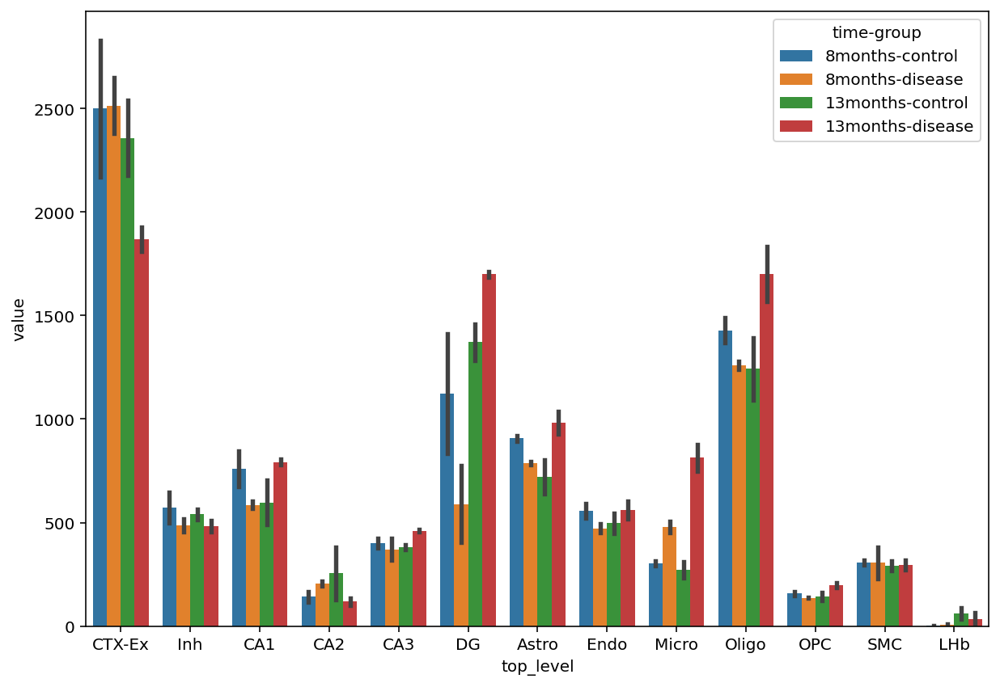

In [22]:
sns.reset_orig()
fig, ax = plt.subplots(figsize=(10, 7))
sns.barplot(x='top_level', y='value', hue='time-group', data=top_count_sample_melt, palette='tab10', ax=ax)
plt.savefig(os.path.join(fig_path, 'cluster_freq_top_level_time_group.pdf'))
plt.show()

In [14]:
type_group_order = []
for current_type in adata.obs['top_level'].cat.categories:
    for current_group in adata.obs['group'].cat.categories:
        type_group_order.append(current_type + '-' + current_group)
        # print(current_type + '-' + current_group)

top_count_sample_melt['type-group'] = top_count_sample_melt['type-group'].cat.reorder_categories(type_group_order)

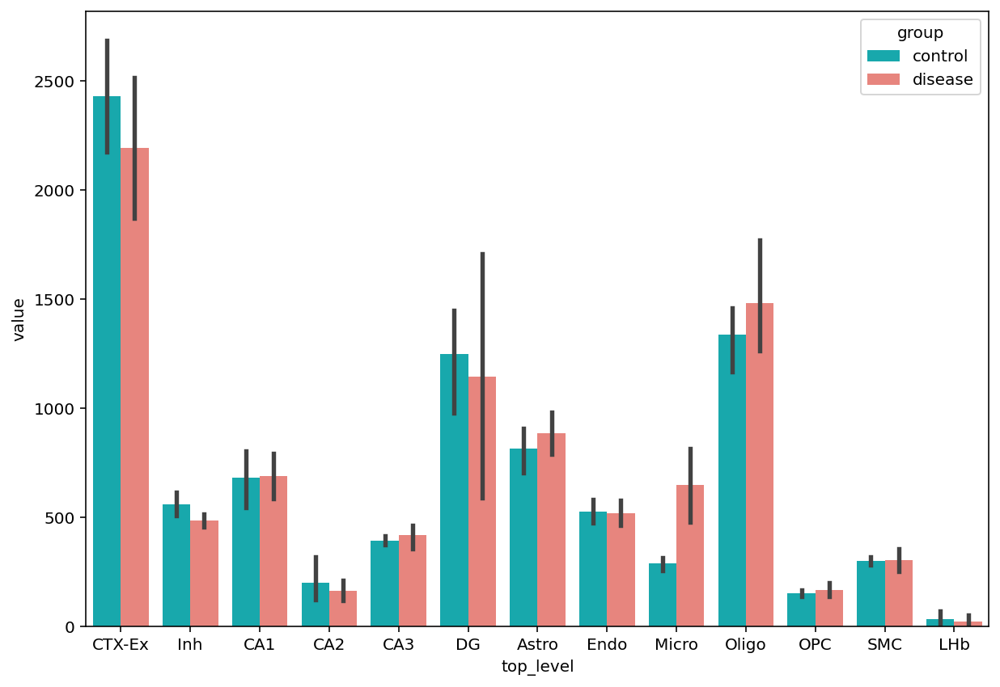

In [21]:
# plot barplot

sns.reset_orig()
cf_pl = sns.color_palette(['#00bfc4', '#f8766d'])
fig, ax = plt.subplots(figsize=(10, 7))
sns.barplot(x='top_level', y='value', hue='group', data=top_count_sample_melt, palette=cf_pl, ax=ax)

pairs = [((current_type, 'disease'), (current_type, 'control')) for current_type in adata.obs['top_level'].cat.categories]

annot = Annotator(ax, pairs, plot='barplot', data=top_count_sample_melt, x='top_level', y='value', hue='group')
annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2)
annot.apply_test(alternative='two-sided').annotate()

plt.savefig(os.path.join(fig_path, 'cluster_freq_top_level_group.pdf'))

plt.show()

#### top-level umap colored by rep

In [14]:
# Load new data
adata = sc.read_h5ad(os.path.join(out_path, '2022-04-06-Hu-AD-stardist-scaled.h5ad'))
adata

AnnData object with n_obs × n_vars = 72165 × 2766
    obs: 'orig_index', 'sample', 'area', 'x', 'y', 'tau', 'group', 'time', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'top_level', 'cell_type', 'seg_label', 'region', 'region_merged', 'time-group', 'replicate', 'type-replicate'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'max_counts', 'detected', 'highly_variable', 'n_cells', 'mean', 'std'
    uns: 'ADmouse_11346_morph', 'ADmouse_11351_morph', 'ADmouse_9494_morph', 'ADmouse_9498_morph', 'ADmouse_9707_morph', 'ADmouse_9723_2_morph', 'ADmouse_9723_morph', 'ADmouse_9735_morph', 'cell_type_hex_dict', 'cell_type_order', 'cell_type_rgb_dict', 'top_level_hex_dict', 'top_level_order', 'top_level_rgb_dict'
    layers: 'corrected', 'norm', 'raw', 'scaled'

In [15]:
# load umap embedding
current_umap_embedding = np.loadtxt(os.path.join(fig_path, f'embedding_top_level_umap.csv'), delimiter=',')
adata.obsm['X_umap'] = current_umap_embedding

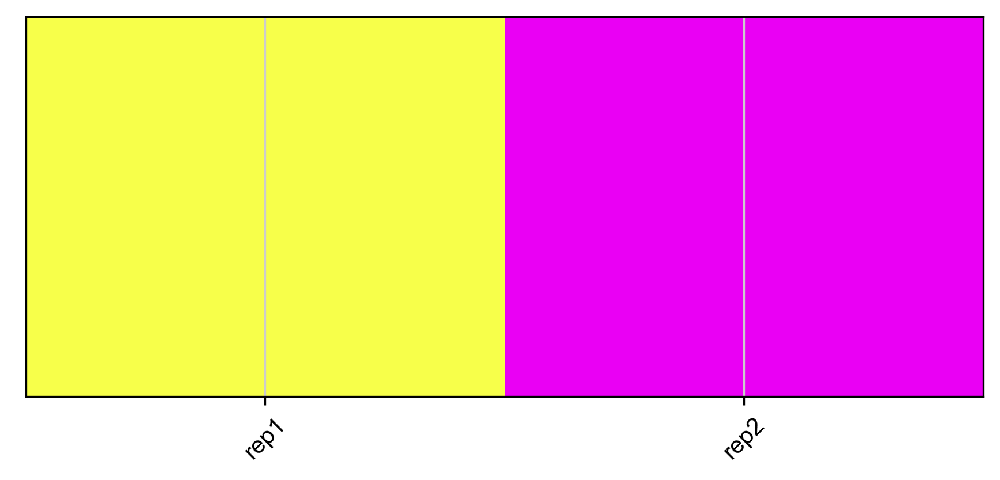

In [17]:
# color map for different replicates 

rep_colors = ['#f7ff4a', '#ea00f4']
rep_cpl = sns.color_palette(rep_colors)
sns.palplot(rep_cpl, size=3)
plt.xticks(range(len(rep_colors)), ['rep1', 'rep2'], size=10, rotation=45)
plt.tight_layout()
plt.show()

13months-control


Trying to set attribute `._uns` of view, copying.


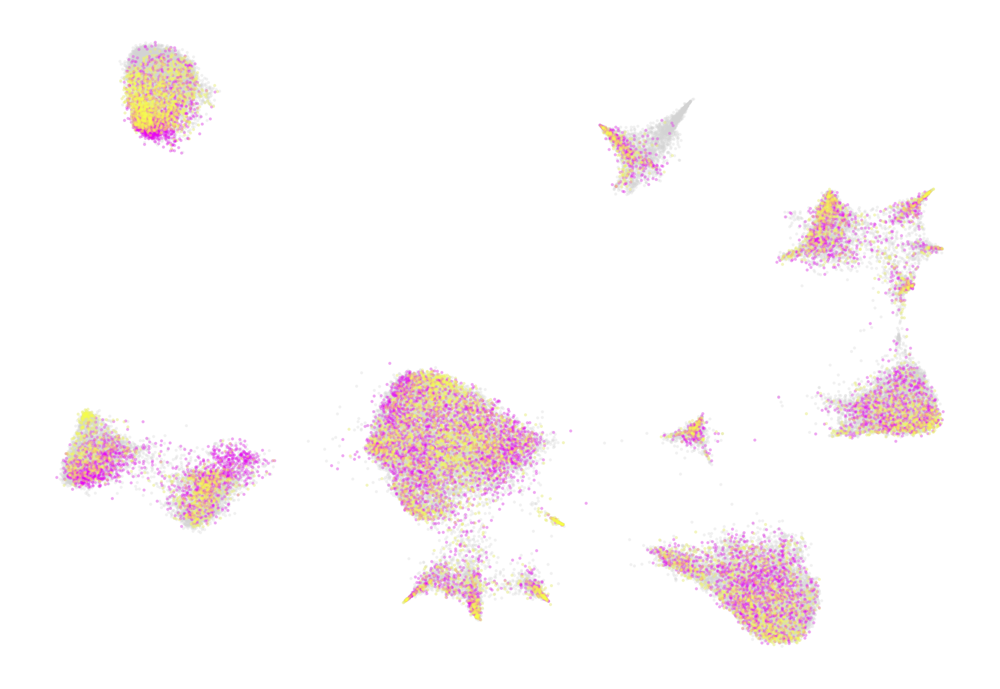

13months-disease


Trying to set attribute `._uns` of view, copying.


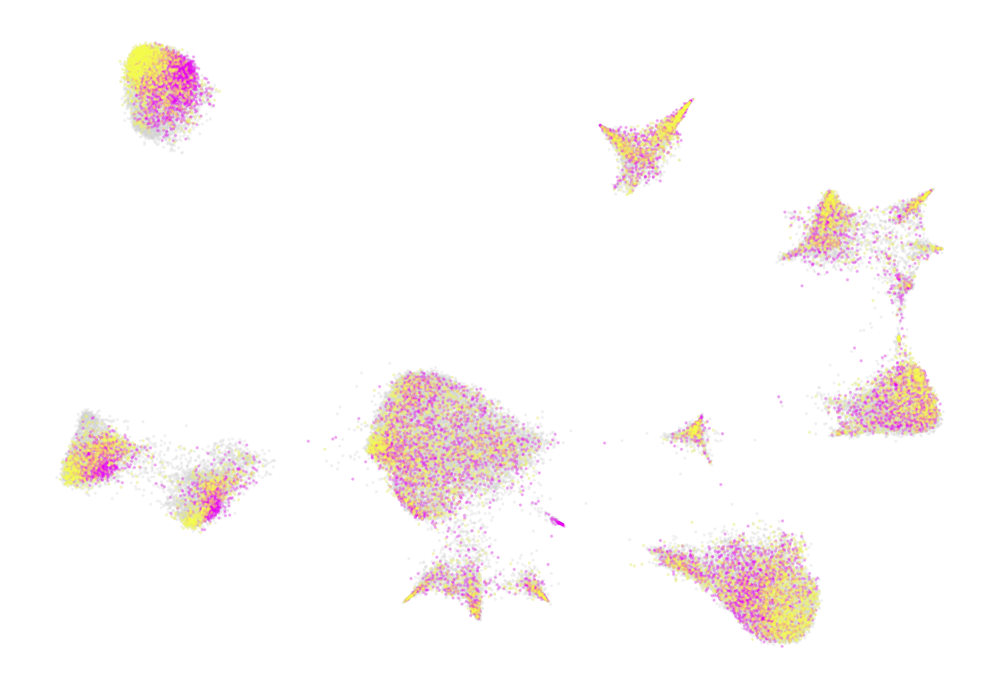

8months-control


Trying to set attribute `._uns` of view, copying.


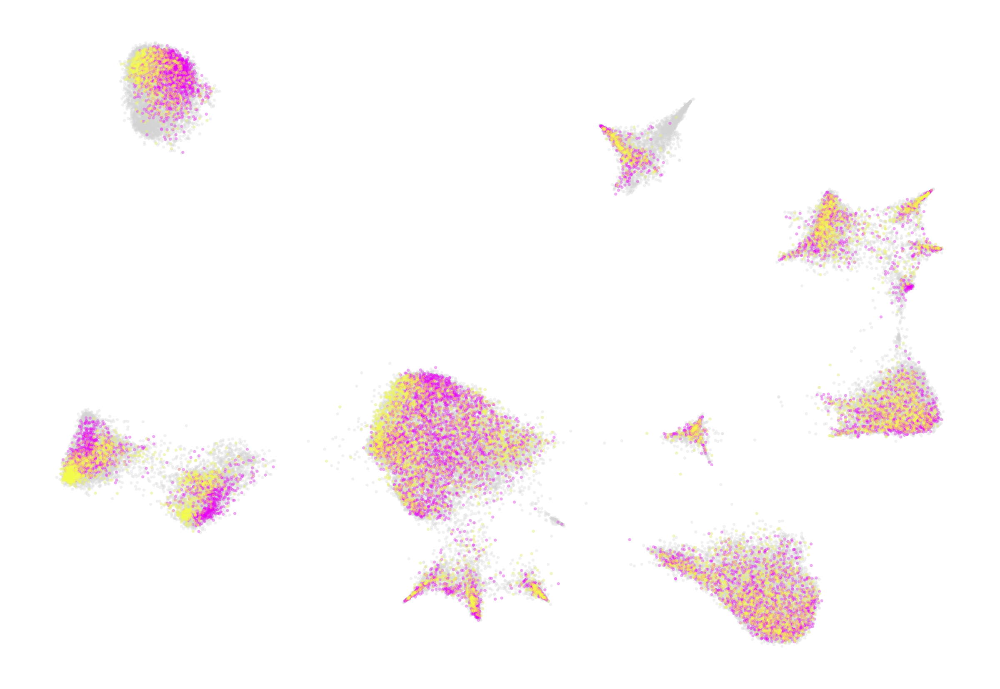

8months-disease


Trying to set attribute `._uns` of view, copying.


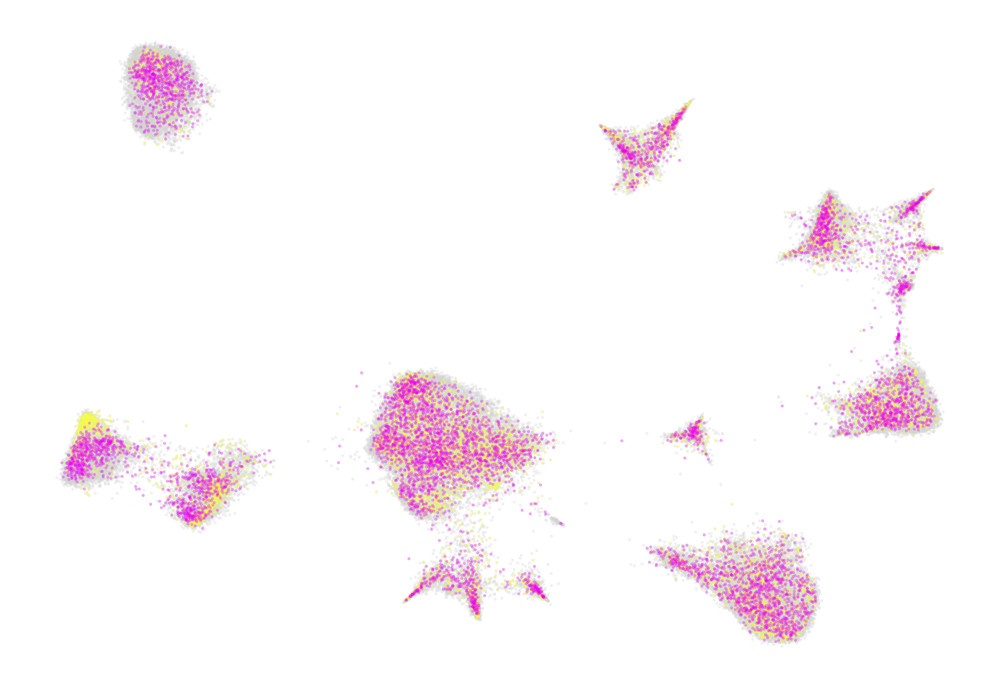

In [34]:
# Plot time-group UMAP
scale_factor = 900000
alpha = .3
for group in sorted(adata.obs['time-group'].unique()):
    print(group)
    fig, ax = plt.subplots(figsize=(10,7))
    sc.pl.umap(adata, show=False, size=(scale_factor / adata.n_obs), color=None, alpha=alpha, ax=ax, title='')
    sc.pl.umap(adata[adata.obs["time-group"] == group], color='replicate', frameon=False, ax=ax, size=(scale_factor / adata.n_obs), legend_loc=None, alpha=alpha,
               title='', palette=rep_cpl, save=f'_{group}_rep')

#### astro color by rep

In [9]:
sdata = adata[adata.obs['top_level'] == 'Astro', ]
sdata

View of AnnData object with n_obs × n_vars = 6789 × 2766
    obs: 'orig_index', 'sample', 'area', 'x', 'y', 'tau', 'group', 'time', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'top_level', 'cell_type', 'seg_label', 'region', 'region_merged', 'time-group', 'replicate', 'type-replicate'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'max_counts', 'detected', 'highly_variable', 'n_cells', 'mean', 'std'
    uns: 'ADmouse_11346_morph', 'ADmouse_11351_morph', 'ADmouse_9494_morph', 'ADmouse_9498_morph', 'ADmouse_9707_morph', 'ADmouse_9723_2_morph', 'ADmouse_9723_morph', 'ADmouse_9735_morph', 'cell_type_hex_dict', 'cell_type_order', 'cell_type_rgb_dict', 'top_level_hex_dict', 'top_level_order', 'top_level_rgb_dict'
    layers: 'corrected', 'norm', 'raw', 'scaled'

In [13]:
# load diffmap embedding
current_diffmap_embedding = np.loadtxt(os.path.join(fig_path, f'embedding_Astro_diffmap.csv'), delimiter=',')
sdata.obsm['X_diffmap'] = current_diffmap_embedding

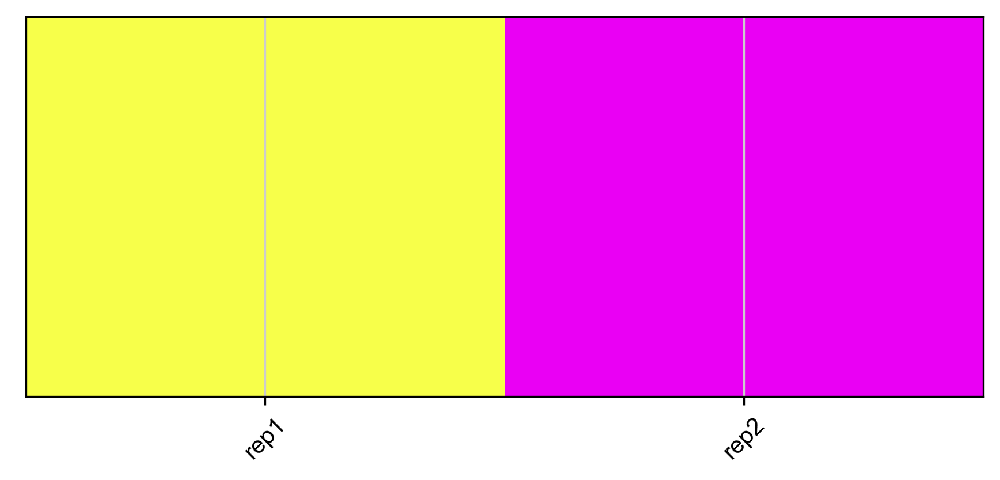

In [14]:
# color map for different replicates 

rep_colors = ['#f7ff4a', '#ea00f4']
rep_cpl = sns.color_palette(rep_colors)
sns.palplot(rep_cpl, size=3)
plt.xticks(range(len(rep_colors)), ['rep1', 'rep2'], size=10, rotation=45)
plt.tight_layout()
plt.show()

In [19]:
sc.settings.figdir = os.path.join(fig_path, 'Astro')
sc.set_figure_params(format='tif', dpi=150)

Trying to set attribute `._uns` of view, copying.


13months-control


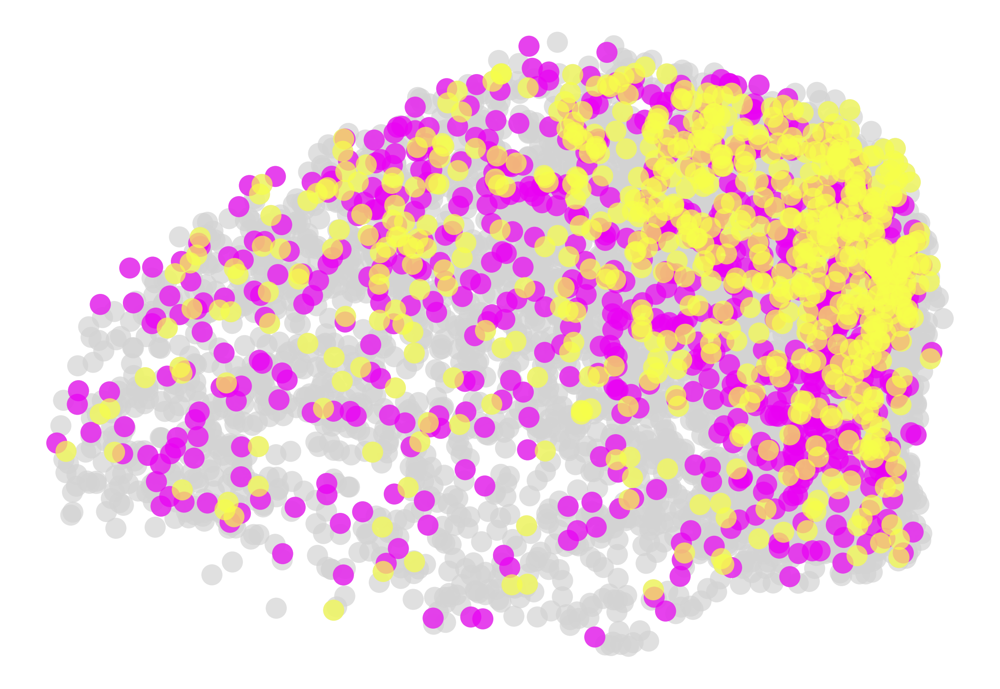

Trying to set attribute `._uns` of view, copying.


13months-disease


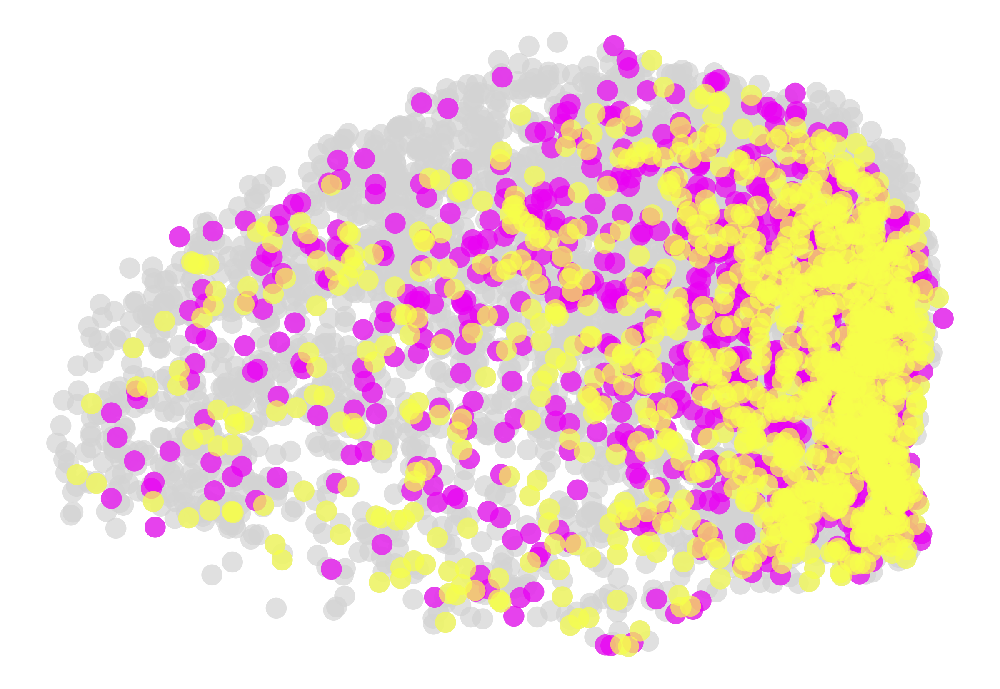

Trying to set attribute `._uns` of view, copying.


8months-control


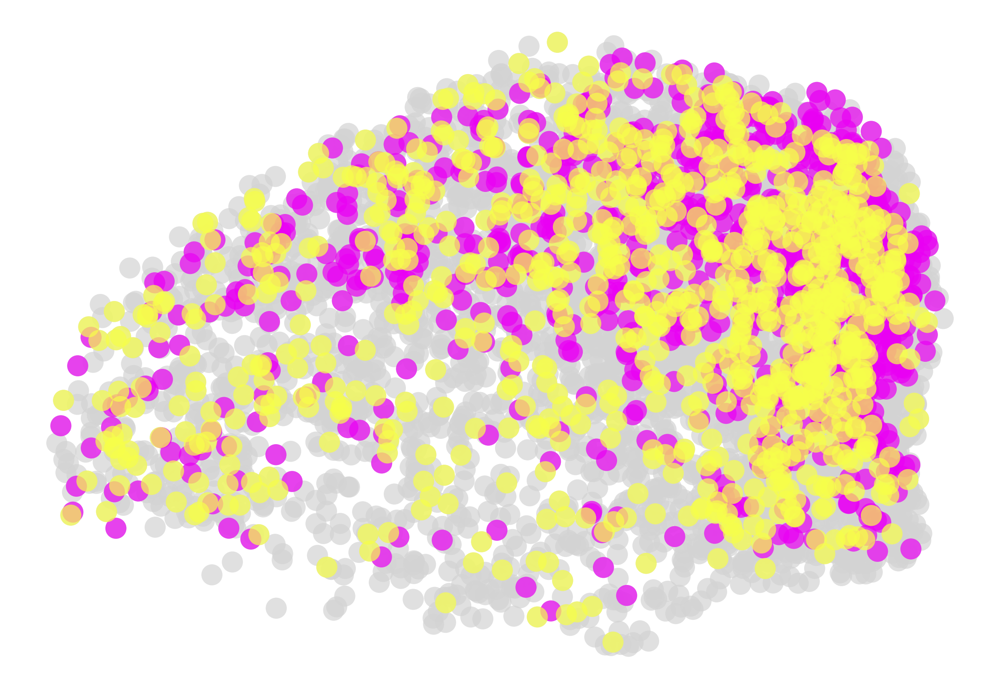

Trying to set attribute `._uns` of view, copying.


8months-disease


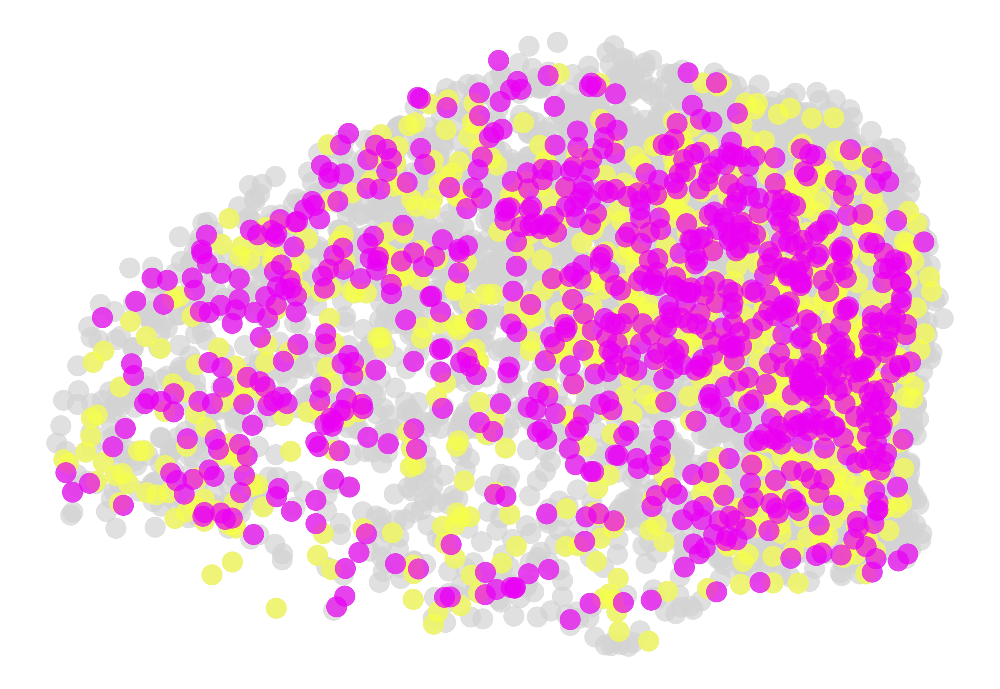

Trying to set attribute `._uns` of view, copying.


13months-control


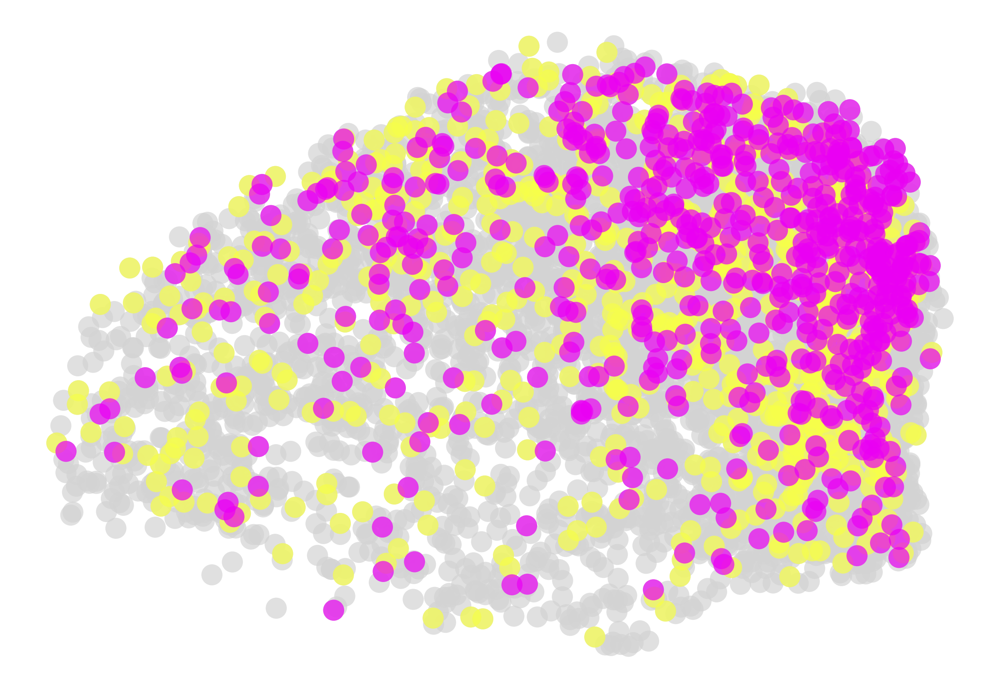

Trying to set attribute `._uns` of view, copying.


13months-disease


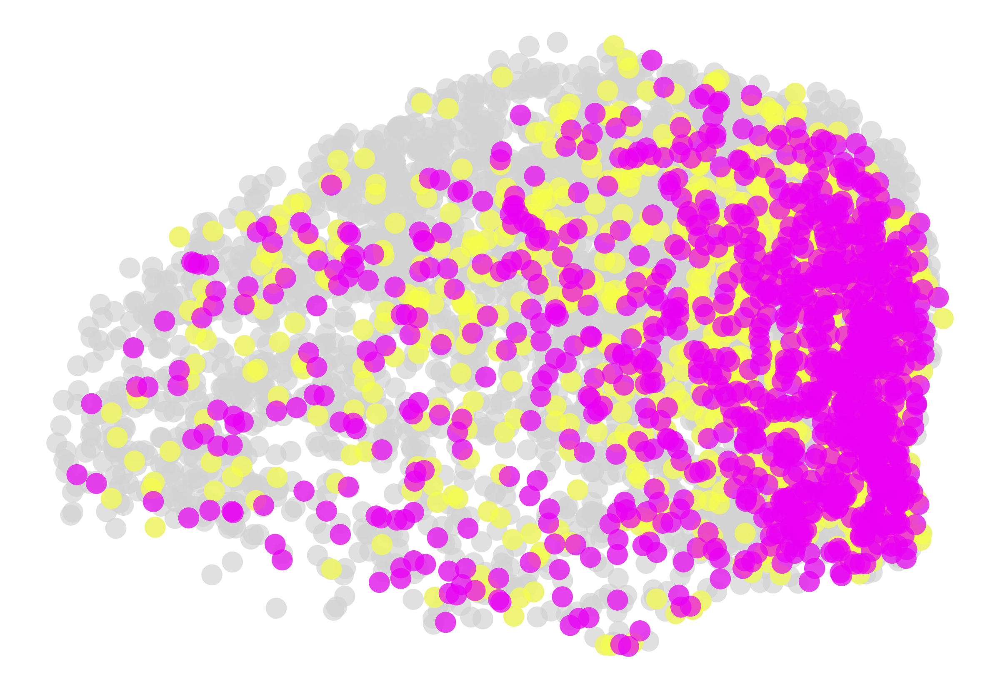

Trying to set attribute `._uns` of view, copying.


8months-control


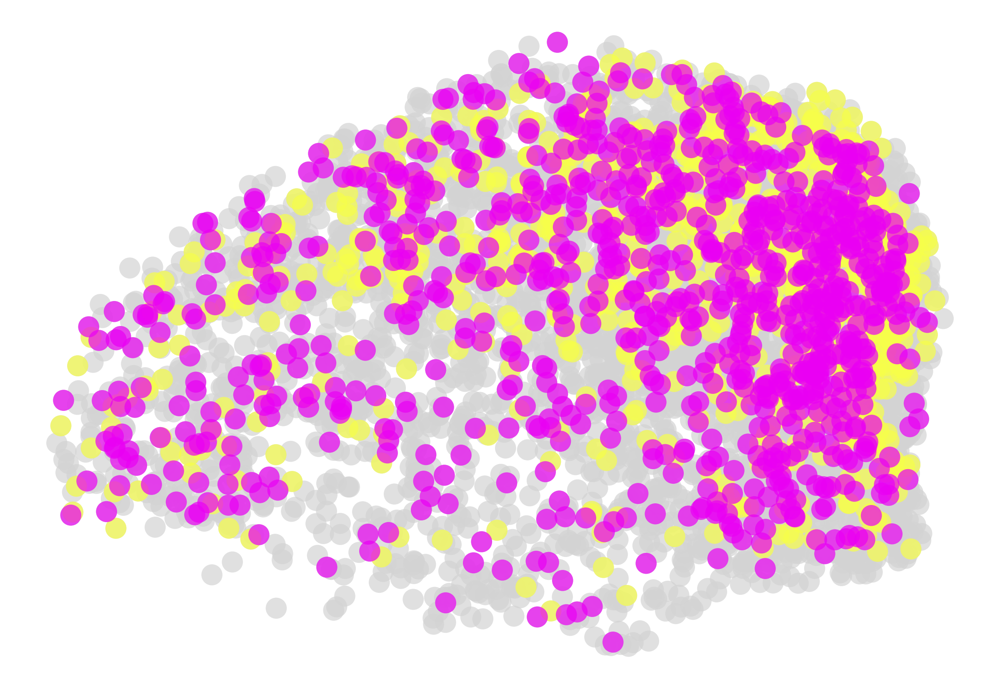

Trying to set attribute `._uns` of view, copying.


8months-disease


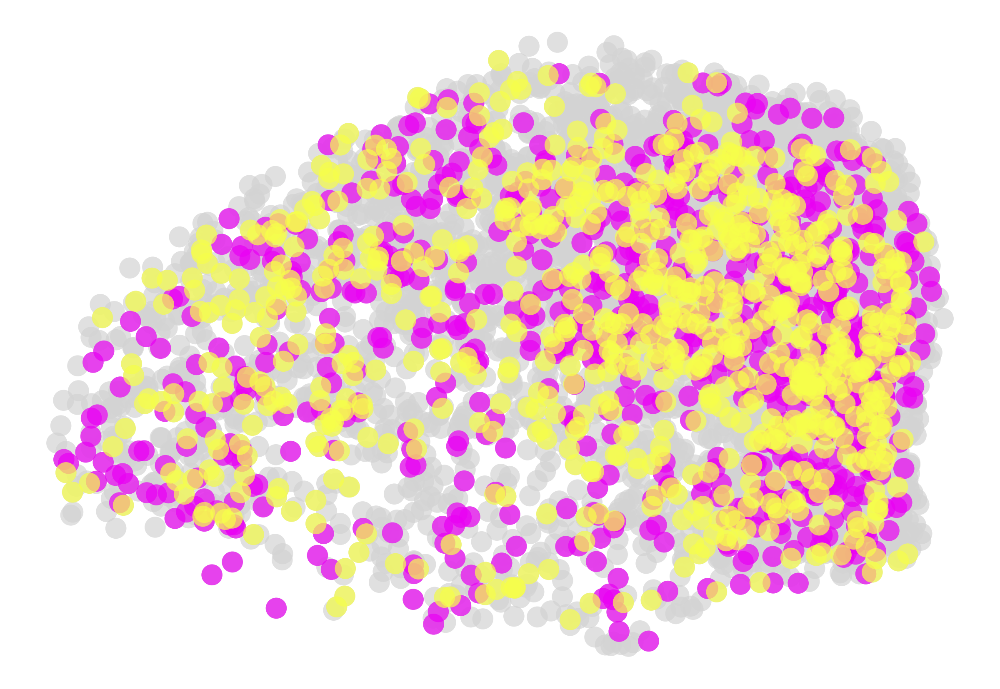

In [22]:
# Plot time-group UMAP
scale_factor = 4000000
alpha = .7
for sample in sorted(sdata.obs['time-group'].unique()):
    print(sample)
    fig, ax = plt.subplots(figsize=(10,7))
    sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='', palette=sns.color_palette(['#fafafa']))
    sc.pl.diffmap(sdata[sdata.obs["time-group"] == sample], color='replicate', frameon=False, ax=ax, size=(scale_factor / sdata.n_obs), legend_loc=None, alpha=alpha,
               title='', palette=rep_cpl, save=f'_{sample}_rep1')
    
sdata.obs['replicate'] = sdata.obs['replicate'].cat.reorder_categories(['replicate_2', 'replicate_1'])

for sample in sorted(sdata.obs['time-group'].unique()):
    print(sample)
    fig, ax = plt.subplots(figsize=(10,7))
    sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='', palette=sns.color_palette(['#fafafa']))
    sc.pl.diffmap(sdata[sdata.obs["time-group"] == sample], color='replicate', frameon=False, ax=ax, size=(scale_factor / sdata.n_obs), legend_loc=None, alpha=alpha,
               title='', palette=rep_cpl, save=f'_{sample}_rep2')

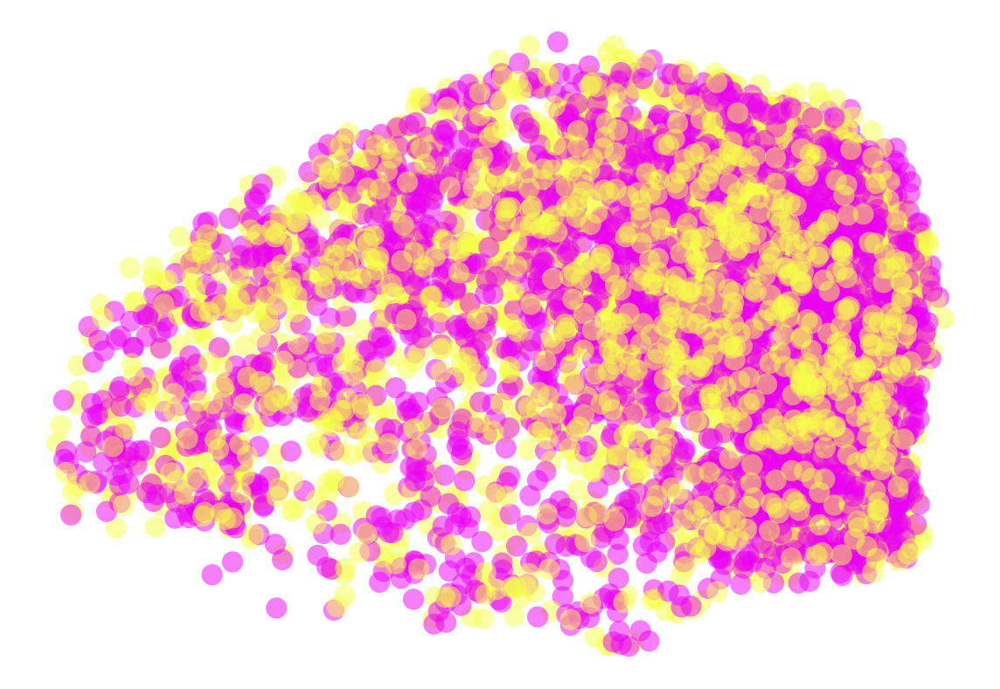

In [78]:
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.diffmap(sdata, color='replicate', frameon=False, ax=ax,
              size=(scale_factor / sdata.n_obs), legend_loc=None, alpha=.5,
           title='', palette=rep_cpl, save=f'_all_rep')
    

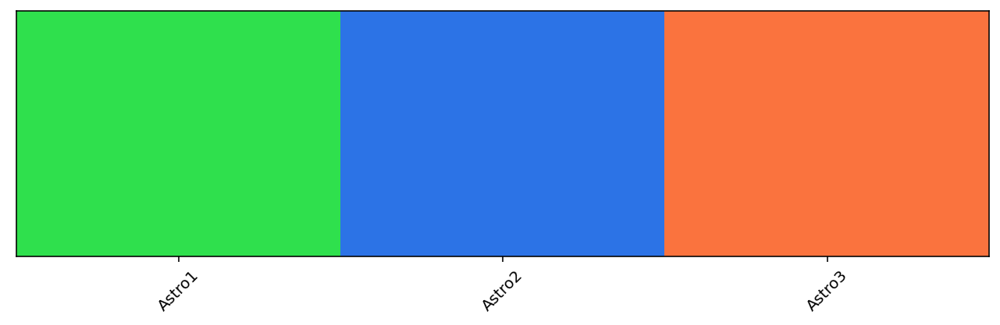

In [25]:
# Check color legend
current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in sdata.obs['cell_type'].unique()]
sub_cpl = []
for i in current_cell_type_order:
    sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

sub_cpl = sns.color_palette(sub_cpl)
sub_cmap = ListedColormap(sub_cpl.as_hex())
sns.palplot(sub_cpl, size=3)
plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'./figures/color_legend_top.png')
plt.show()

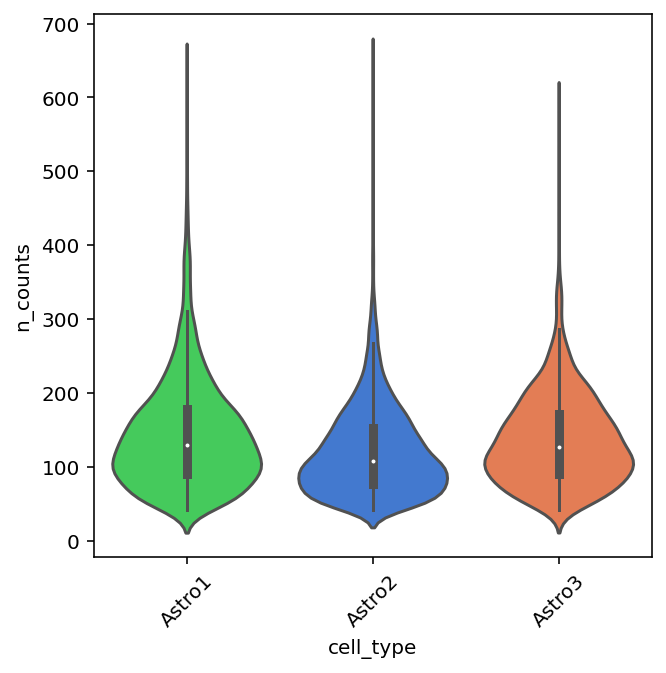

In [50]:
# violin plot

fig, ax = plt.subplots(figsize=(5, 5))
ax = sns.violinplot(x="cell_type", y="n_counts", data=sdata.obs, palette=sub_cpl,
                     inner="box", scale='width', width=.8)
plt.xticks(rotation=45)

# annot = Annotator(ax, [('Astro1', 'Astro2'), ('Astro1', 'Astro3')], plot='violinplot', data=sdata.obs, x='cell_type', y='n_counts')
# annot.configure(test='t-test_ind', comparisons_correction="Bonferroni", text_format='star', loc='inside', verbose=2)
# annot.apply_test(alternative='two-sided').annotate()

plt.savefig(os.path.join(fig_path, 'Astro', 'violin_n_counts.pdf'))
plt.show()

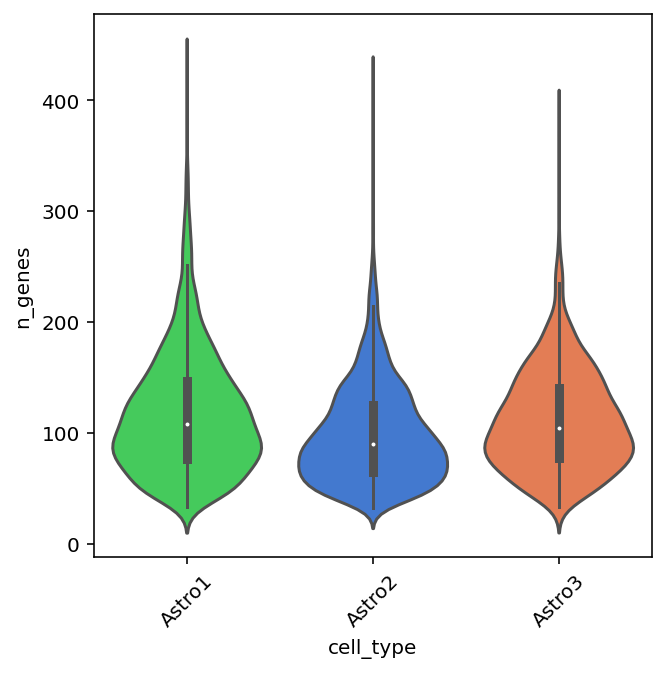

In [51]:
# violin plot

fig, ax = plt.subplots(figsize=(5, 5))
ax = sns.violinplot(x="cell_type", y="n_genes", data=sdata.obs, palette=sub_cpl,
                     inner="box", scale='width', width=.8)
plt.xticks(rotation=45)

# annot = Annotator(ax, [('Astro1', 'Astro2'), ('Astro1', 'Astro3')], plot='violinplot', data=sdata.obs, x='cell_type', y='n_genes')
# annot.configure(test='t-test_ind', comparisons_correction="Bonferroni", text_format='star', loc='inside', verbose=2)
# annot.apply_test(alternative='two-sided').annotate()

plt.savefig(os.path.join(fig_path, 'Astro', 'violin_n_genes.pdf'))
plt.show()

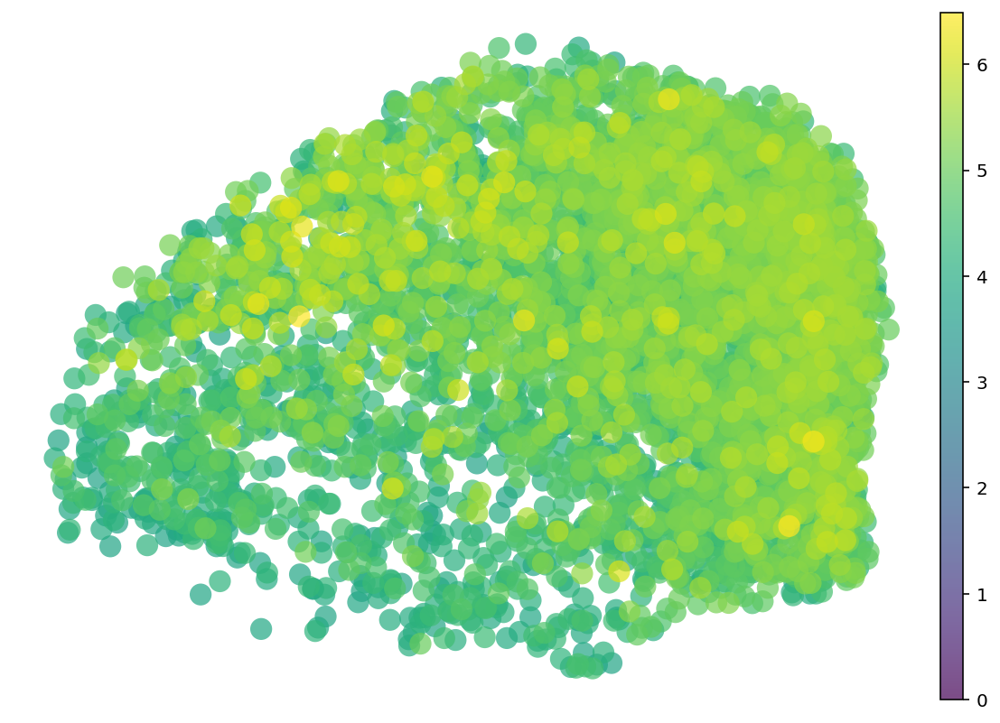

In [65]:
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.diffmap(sdata, color='log1p_total_counts', frameon=False, ax=ax, vmin=0,
              size=(scale_factor / sdata.n_obs), legend_loc=None, alpha=alpha,
           title='', save=f'_log1p_total_counts')
    

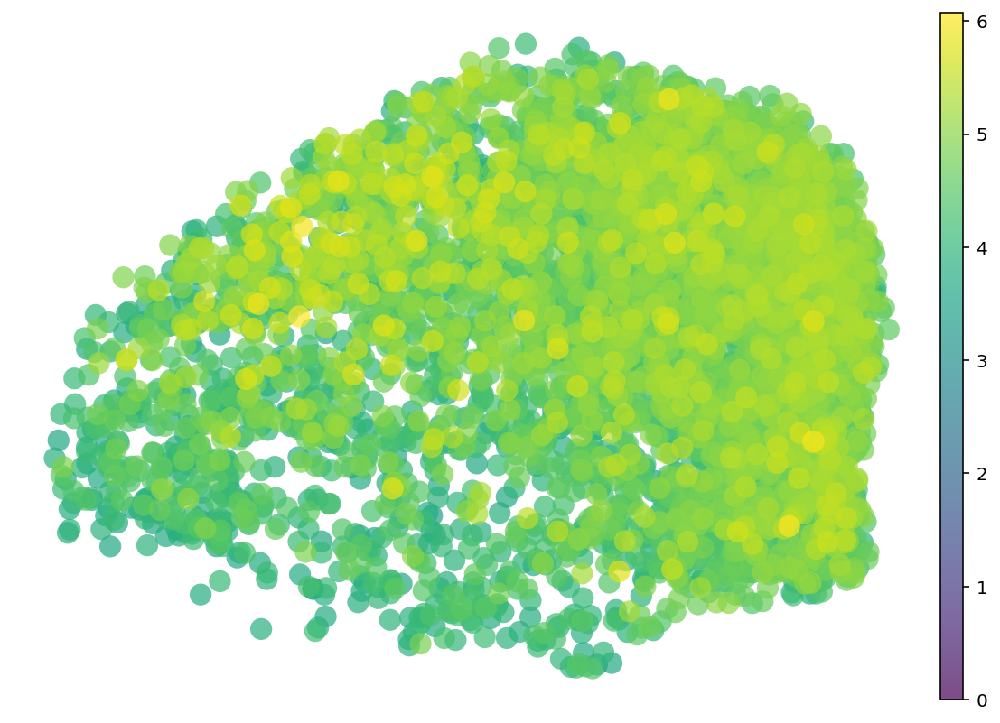

In [66]:
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.diffmap(sdata, color='log1p_n_genes_by_counts', frameon=False, ax=ax, vmin=0,
              size=(scale_factor / sdata.n_obs), legend_loc=None, alpha=alpha,
           title='', save=f'_log1p_n_genes_by_counts')
    

In [76]:
sdata.layers['norm'].max()

3.5153327

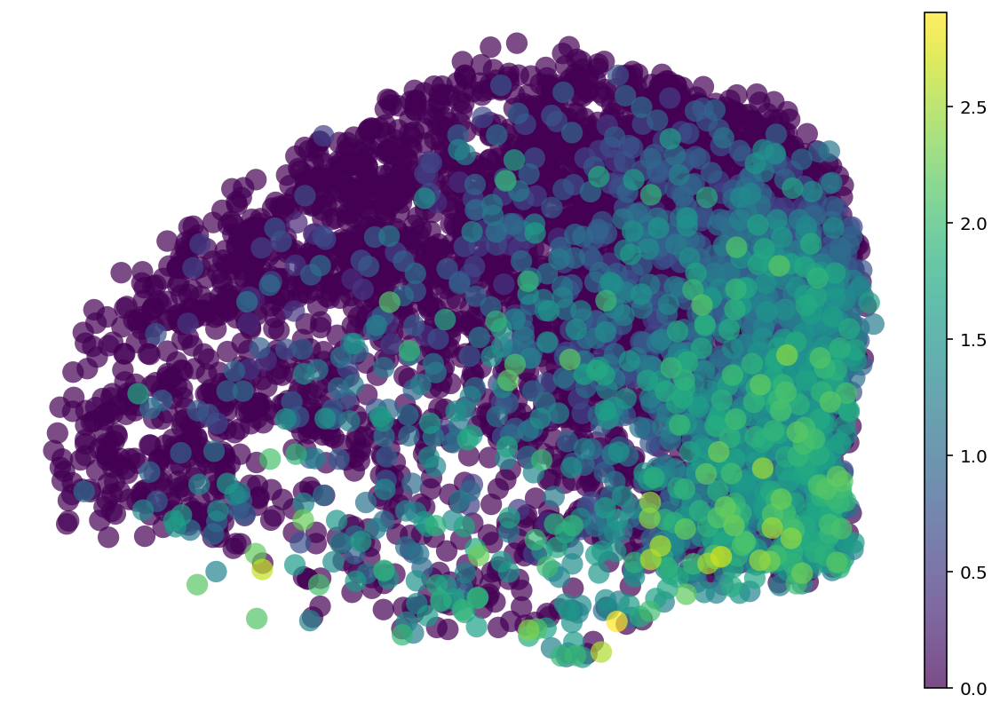

In [67]:
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.diffmap(sdata, color='Gfap', frameon=False, ax=ax, vmin=0,
              size=(scale_factor / sdata.n_obs), legend_loc=None, alpha=alpha,
           title='')# , save=f'_log1p_n_genes_by_counts')
    

#### R2-4

In [9]:
# sub level 
sub_id = 'Micro'
curr_cells = adata.obs['top_level'] == sub_id
sdata = adata[curr_cells, :]
sdata

View of AnnData object with n_obs × n_vars = 3732 × 2766
    obs: 'orig_index', 'sample', 'area', 'x', 'y', 'tau', 'group', 'time', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'top_level', 'cell_type', 'seg_label', 'region', 'region_merged', 'time-group', 'replicate', 'type-replicate'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'max_counts', 'detected', 'highly_variable', 'n_cells', 'mean', 'std'
    uns: 'ADmouse_11346_morph', 'ADmouse_11351_morph', 'ADmouse_9494_morph', 'ADmouse_9498_morph', 'ADmouse_9707_morph', 'ADmouse_9723_2_morph', 'ADmouse_9723_morph', 'ADmouse_9735_morph', 'cell_type_hex_dict', 'cell_type_order', 'cell_type_rgb_dict', 'top_level_hex_dict', 'top_level_order', 'top_level_rgb_dict'
    layers: 'corrected', 'norm', 'raw', 'scaled'

In [10]:
current_umap_embedding = np.loadtxt(os.path.join(fig_path, f'embedding_{sub_id}_umap.csv'), delimiter=',')
current_diffmap_embedding = np.loadtxt(os.path.join(fig_path, f'embedding_{sub_id}_diffmap.csv'), delimiter=',')

sdata.obsm['X_umap'] = current_umap_embedding
sdata.obsm["X_diffmap"] = current_diffmap_embedding

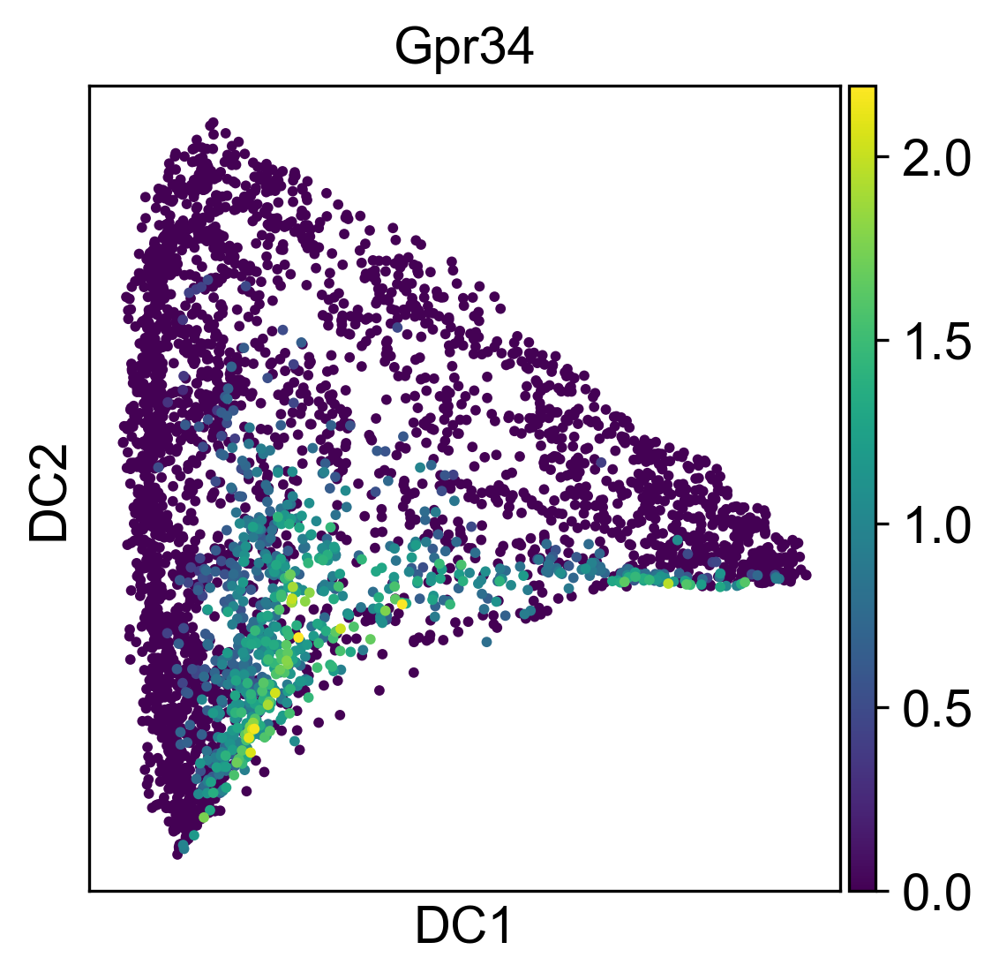

In [11]:
sc.pl.diffmap(sdata, color='Gpr34')

In [ ]:
# Check color legend
current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in sdata.obs['cell_type'].unique()]
sub_cpl = []
for i in current_cell_type_order:
    sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

sub_cpl = sns.color_palette(sub_cpl)
sub_cmap = ListedColormap(sub_cpl.as_hex())
sns.palplot(sub_cpl, size=3)
plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'./figures/color_legend_top.png')
plt.show()

In [ ]:
sc.settings.figdir = fig_path
sc.set_figure_params(format='tif', dpi=150)

In [ ]:
# Plot UMAP with cluster labels w/ new color
scale_factor = 4000000
alpha = .3
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.diffmap(sdata, color='cell_type', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha,
           legend_loc=False, palette=sub_cpl, save=f'_all_{sub_id}')

fig, ax = plt.subplots(figsize=(10,7))
sc.pl.umap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.umap(sdata, color='cell_type', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha,
           legend_loc=False, palette=sub_cpl, save=f'_all_{sub_id}')


In [16]:
# Subset (Oligo & OPC)
curr_cells = (adata.obs['top_level'] == 'Oligo') | (adata.obs['top_level'] == 'OPC')
sdata = adata[curr_cells, :]
sdata

View of AnnData object with n_obs × n_vars = 12534 × 2766
    obs: 'orig_index', 'sample', 'area', 'x', 'y', 'tau', 'group', 'time', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'top_level', 'cell_type', 'seg_label', 'region', 'region_merged', 'time-group', 'replicate', 'type-replicate'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'max_counts', 'detected', 'highly_variable', 'n_cells', 'mean', 'std'
    uns: 'ADmouse_11346_morph', 'ADmouse_11351_morph', 'ADmouse_9494_morph', 'ADmouse_9498_morph', 'ADmouse_9707_morph', 'ADmouse_9723_2_morph', 'ADmouse_9723_morph', 'ADmouse_9735_morph', 'cell_type_hex_dict', 'cell_type_order', 'cell_type_rgb_dict', 'top_level_hex_dict', 'top_level_order', 'top_level_rgb_dict'
    layers: 'corrected', 'norm', 'raw', 'scaled'

In [17]:
current_umap_embedding = np.loadtxt(os.path.join(fig_path, f'embedding_Oligo_OPC_umap.csv'), delimiter=',')
current_diffmap_embedding = np.loadtxt(os.path.join(fig_path, f'embedding_Oligo_OPC_diffmap.csv'), delimiter=',')

sdata.obsm['X_umap'] = current_umap_embedding
sdata.obsm["X_diffmap"] = current_diffmap_embedding

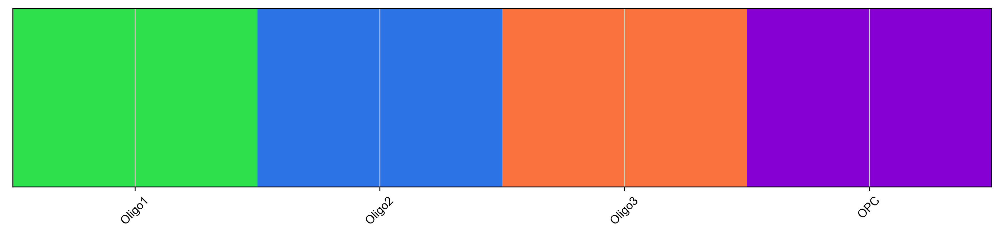

In [18]:
# Check color legend
current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in sdata.obs['cell_type'].unique()]
sub_cpl = []
for i in current_cell_type_order:
    sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

sub_cpl = sns.color_palette(sub_cpl)
sub_cmap = ListedColormap(sub_cpl.as_hex())
sns.palplot(sub_cpl, size=3)
plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'./figures/color_legend_top.png')
plt.show()

In [23]:
sc.settings.figdir = os.path.join(fig_path, 'Oligo_OPC')
sc.set_figure_params(format='tif', dpi=150)

In [ ]:
# Plot UMAP with cluster labels w/ new color
scale_factor = 4000000
alpha = .3
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.diffmap(sdata, color='cell_type', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha,
           legend_loc=False, palette=sub_cpl, save=f'_all_Oligo_OPC')

fig, ax = plt.subplots(figsize=(10,7))
sc.pl.umap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.umap(sdata, color='cell_type', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha,
           legend_loc=False, palette=sub_cpl, save=f'_all_Oligo_OPC')


Pcdh15


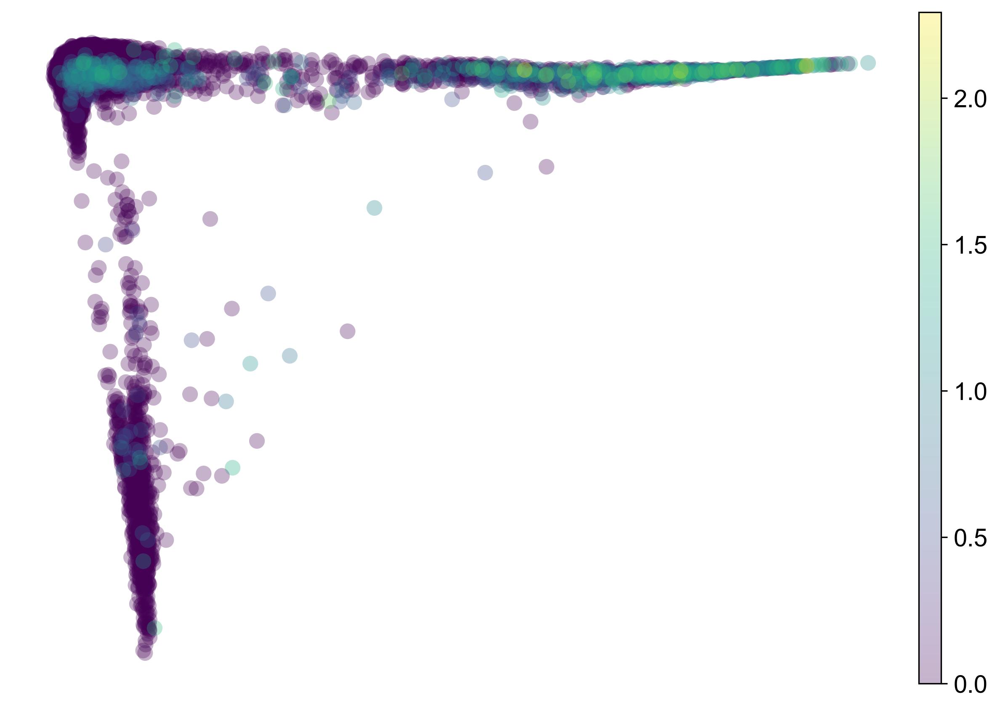

Pdgfra


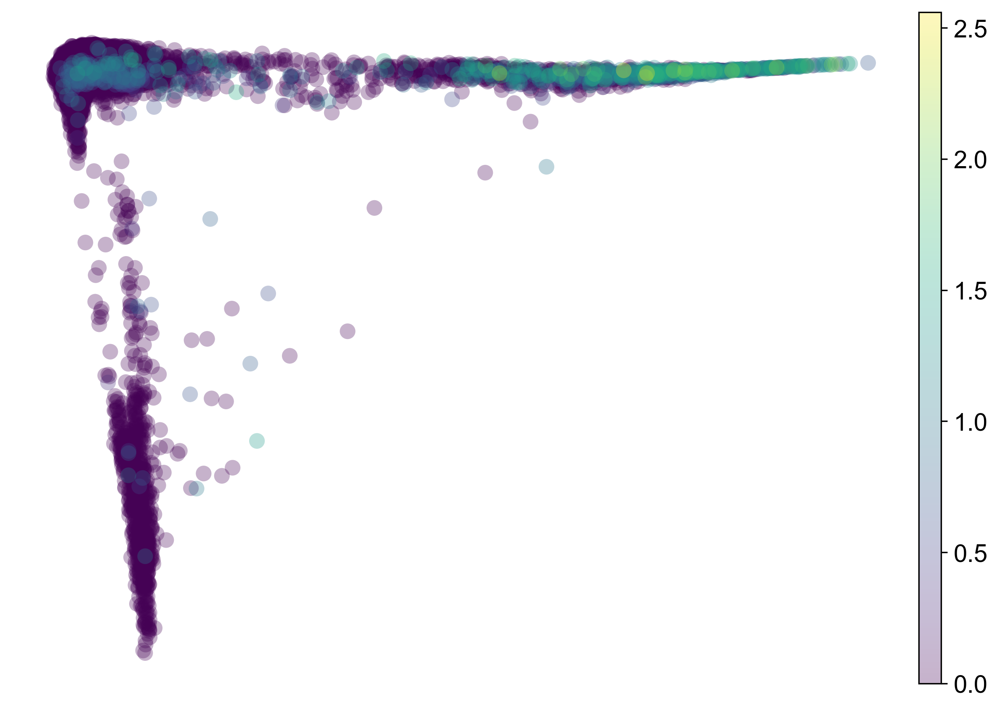

Mbp


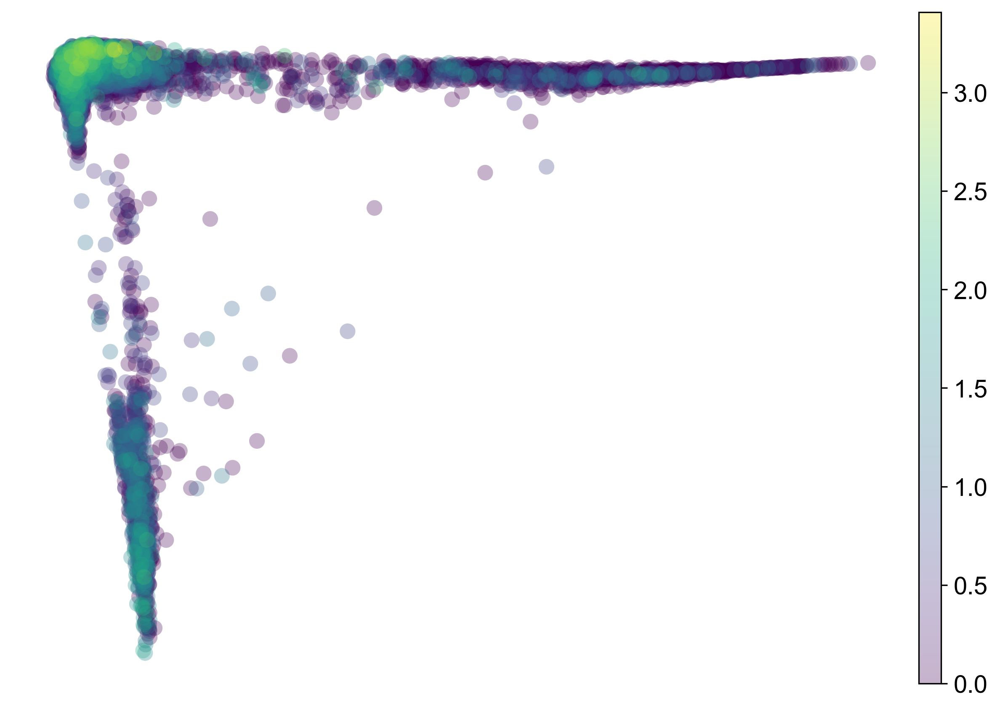

Klk6


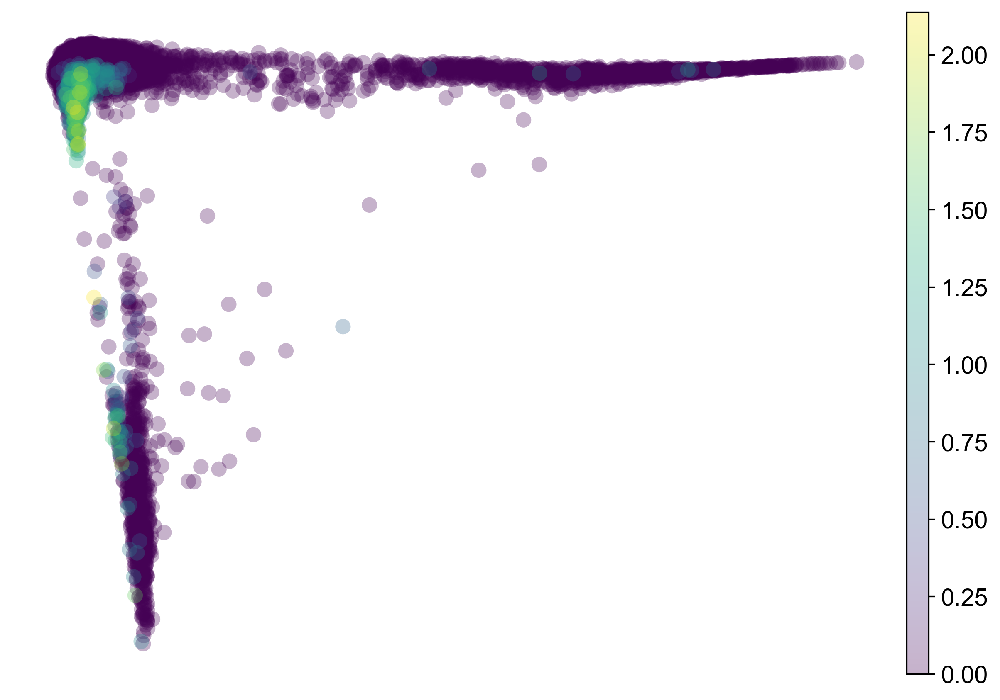

Plp1


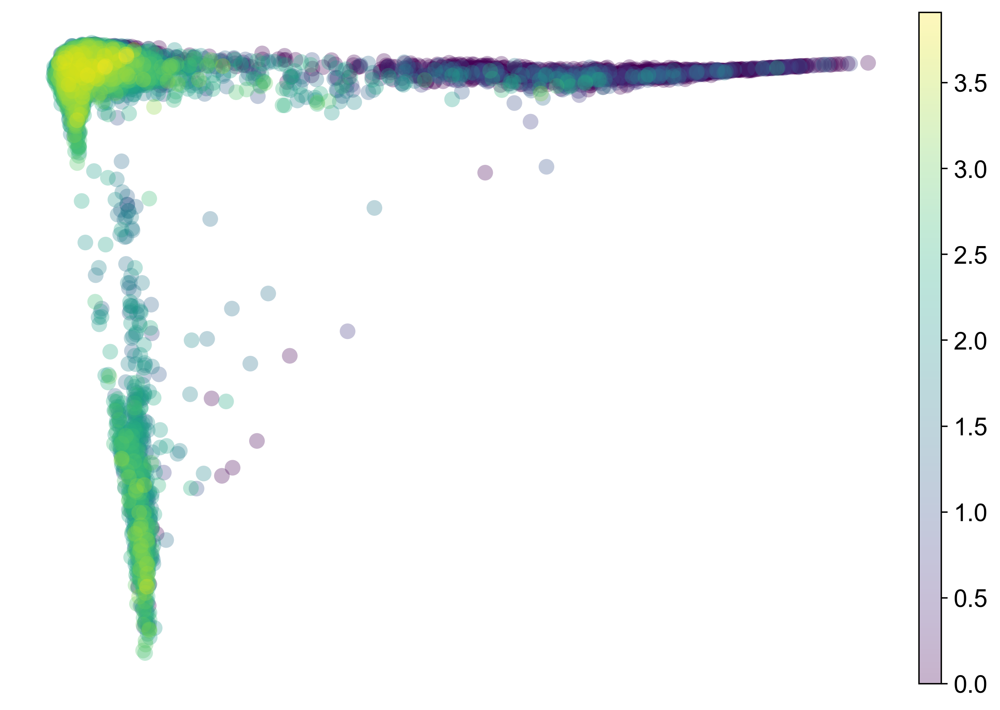

Mobp


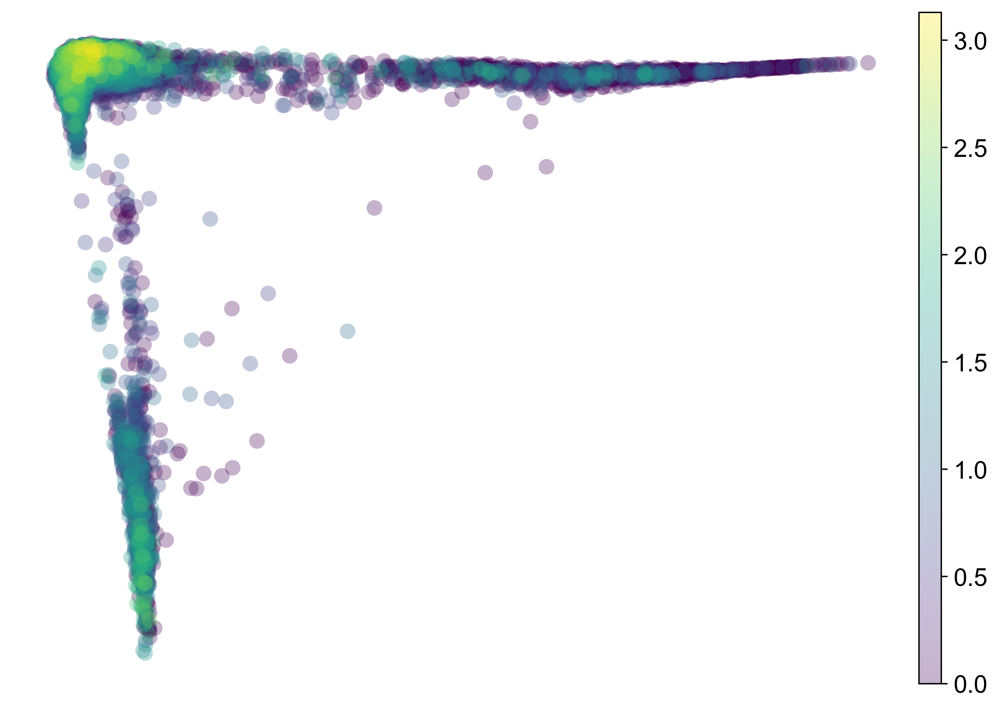

In [24]:
# Plot time-group UMAP
scale_factor = 4000000
alpha = .3
plot_genes = ['Pcdh15', 'Pdgfra', 'Mbp', 'Klk6', 'Plp1', 'Mobp']
for gene in plot_genes:
    print(gene)
    fig, ax = plt.subplots(figsize=(10,7))
    sc.pl.diffmap(sdata, color=gene, frameon=False, ax=ax, size=(scale_factor / sdata.n_obs), legend_loc=None, alpha=alpha,
               title='', cmap='viridis', save=f'_{gene}')

#### R2-5

In [ ]:
# Load new data
adata = sc.read_h5ad(os.path.join(out_path, '2022-04-06-Hu-AD-stardist-scaled.h5ad'))
adata

In [ ]:
# Embedding parameters
emb_dict = {
    'Micro': {'n_neighbors': 30, 'n_pcs': 3, 'min_dist': .1, 'cluster_resolution': .1},
    'Astro': {'n_neighbors': 30, 'n_pcs': 4, 'min_dist': .1, 'cluster_resolution': .4},
}

In [ ]:
# Subset
sub_id = 'Astro'
curr_cells = adata.obs['top_level'] == sub_id
sdata = adata[curr_cells, :]
sdata

In [ ]:
obs = pd.read_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/figures/Astro/astro-obs.csv', index_col=0)
sdata.obs = obs.copy()
sdata.obs.index = sdata.obs.index.astype(str)

In [ ]:
sub_level_fig_path = os.path.join(fig_path, sub_id)
if not os.path.exists(sub_level_fig_path):
    os.mkdir(sub_level_fig_path)

In [ ]:
sc.settings.figdir = sub_level_fig_path
sc.set_figure_params(format='tif', dpi=150)

In [ ]:
sns.reset_orig()

In [ ]:
# Run PCA
sc.tl.pca(sdata, svd_solver='arpack', use_highly_variable=True)

# Plot explained variance 
sc.pl.pca_variance_ratio(sdata, log=False)

# Plot PCA
sc.pl.pca(sdata, color='sample')

In [ ]:
%%time
# Computing the neighborhood graph
n_neighbors = emb_dict[sub_id]['n_neighbors']
n_pcs = emb_dict[sub_id]['n_pcs']
min_dist = emb_dict[sub_id]['min_dist']

sc.pp.neighbors(sdata, n_neighbors=n_neighbors, n_pcs=n_pcs)

# Run UMAP
sc.tl.umap(sdata, min_dist=min_dist)
sc.tl.diffmap(sdata, n_comps=n_pcs)

In [ ]:
%%time
# Run leiden cluster
cluster_resolution = emb_dict[sub_id]['cluster_resolution']
# sc.tl.leiden(sdata, resolution = cluster_resolution)

# Plot UMAP with cluster labels 
sc.pl.umap(sdata, color='leiden')
sc.pl.diffmap(sdata, color='leiden')
n_clusters = sdata.obs['leiden'].unique().shape[0]

In [ ]:
# Check color legend
current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in sdata.obs['cell_type'].unique()]
sub_cpl = []
for i in current_cell_type_order:
    sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

sub_cpl = sns.color_palette(sub_cpl)
sub_cmap = ListedColormap(sub_cpl.as_hex())
sns.palplot(sub_cpl, size=3)
plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'./figures/color_legend_top.png')
plt.show()

In [ ]:
import plotly.express as px
current_df = sdata.obs.copy()
current_df['index'] = current_df.index

current_df['umap_1'] = sdata.obsm['X_umap'][:, 0]
current_df['umap_2'] = sdata.obsm['X_umap'][:, 1]

current_df['dc_1'] = sdata.obsm['X_diffmap'][:, 1]
current_df['dc_2'] = sdata.obsm['X_diffmap'][:, 2]

fig = px.scatter(current_df, x="dc_1", y="dc_2", color='cell_type', hover_data=['cell_type', 'index'])
fig.update_layout(
    autosize=False,
    width=800,
    height=800,)
fig.show()

In [ ]:
current_umap_embedding = np.loadtxt(os.path.join(fig_path, f'embedding_{sub_id}_umap.csv'), delimiter=',')
current_diffmap_embedding = np.loadtxt(os.path.join(fig_path, f'embedding_{sub_id}_diffmap.csv'), delimiter=',')

sdata.obsm['X_umap'] = current_umap_embedding
sdata.obsm["X_diffmap"] = current_diffmap_embedding

Micro root: 50286

Astro root: 58437

In [ ]:
sdata.obs['leiden'] = sdata.obs['leiden'].astype('category')

In [ ]:
sdata.uns['iroot'] = np.flatnonzero(current_df['index'] == '58437')[0]
sc.tl.dpt(sdata, n_branchings=0, n_dcs=n_pcs)
sc.pl.diffmap(sdata, color='time-group')
sc.pl.diffmap(sdata, color='dpt_pseudotime')

In [ ]:
sdata.obs['time-group'] = sdata.obs['time-group'].cat.reorder_categories(['8months-control', '8months-disease', '13months-control', '13months-disease'])
sc.pl.diffmap(sdata, color='time-group')

In [ ]:
# Plot UMAP with cluster labels w/ new color
scale_factor = 5000000
alpha = .2
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.diffmap(sdata, color='time-group', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha,
           legend_loc=False, save=f'_time-group')
plt.show()

fig, ax = plt.subplots(figsize=(11,7))

sns.scatterplot(x='dc_1', y='dc_2', data=current_df.iloc[[sdata.uns['iroot']]], color='r', marker='*', s=500, edgecolor='k', ax=ax, zorder=2)
sc.pl.diffmap(sdata, color='dpt_pseudotime', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha, 
           legend_loc=False, save=f'_dpt')

plt.show()

fig, ax = plt.subplots(figsize=(10,7))

sc.pl.diffmap(sdata, color='cell_type', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha, palette=sub_cpl,
           legend_loc=False, save=f'_type')

plt.show()

In [ ]:
# Plot UMAP with cluster labels w/ new color
scale_factor = 5000000
alpha = .2
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.umap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.umap(sdata, color='time-group', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha,
           legend_loc=False, save=f'_time-group')
plt.show()

fig, ax = plt.subplots(figsize=(10,7))
sc.pl.umap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.umap(sdata, color='leiden', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha,
           legend_loc=False, save=f'_leiden')
plt.show()

fig, ax = plt.subplots(figsize=(10,7))
sc.pl.umap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.umap(sdata, color='cell_type', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha,
           legend_loc=False, palette=sub_cpl, save=f'_cell_type')
plt.show()

In [ ]:
# Subset (Oligo & OPC)
curr_cells = (adata.obs['top_level'] == 'Oligo') | (adata.obs['top_level'] == 'OPC')
sdata = adata[curr_cells, :]
sdata

In [ ]:
sub_level_fig_path = os.path.join(fig_path, 'Oligo_OPC')
if not os.path.exists(sub_level_fig_path):
    os.mkdir(sub_level_fig_path)

In [ ]:
sc.settings.figdir = sub_level_fig_path
sc.set_figure_params(format='tif', dpi=150)

In [ ]:
# Run PCA
sc.tl.pca(sdata, svd_solver='arpack', use_highly_variable=True)

# Plot explained variance 
sc.pl.pca_variance_ratio(sdata, log=False)

# Plot PCA
sc.pl.pca(sdata, color='sample')

In [ ]:
%%time
# Computing the neighborhood graph
n_neighbors = 30
n_pcs = 5
min_dist = 0.1

sc.pp.neighbors(sdata, n_neighbors=n_neighbors, n_pcs=n_pcs)

# Run UMAP
sc.tl.umap(sdata, min_dist=min_dist)
sc.tl.diffmap(sdata, n_comps=n_pcs)

In [ ]:
%%time
# Run leiden cluster
cluster_resolution = 0.3
sc.tl.leiden(sdata, resolution = cluster_resolution)

# Plot UMAP with cluster labels 
sc.pl.umap(sdata, color='leiden')
sc.pl.diffmap(sdata, color='leiden')
n_clusters = sdata.obs['leiden'].unique().shape[0]

In [ ]:
import plotly.express as px
current_df = sdata.obs.copy()
current_df['index'] = current_df.index

current_df['umap_1'] = sdata.obsm['X_umap'][:, 0]
current_df['umap_2'] = sdata.obsm['X_umap'][:, 1]

current_df['dc_1'] = sdata.obsm['X_diffmap'][:, 1]
current_df['dc_2'] = sdata.obsm['X_diffmap'][:, 2]

fig = px.scatter(current_df, x="dc_1", y="dc_2", color='cell_type', hover_data=['cell_type', 'index'])
fig.update_layout(
    autosize=False,
    width=800,
    height=800,)
fig.show()

In [ ]:
current_umap_embedding = np.loadtxt(os.path.join(fig_path, f'embedding_Oligo_OPC_umap.csv'), delimiter=',')
current_diffmap_embedding = np.loadtxt(os.path.join(fig_path, f'embedding_Oligo_OPC_diffmap.csv'), delimiter=',')

sdata.obsm['X_umap'] = current_umap_embedding
sdata.obsm["X_diffmap"] = current_diffmap_embedding

Micro root: 50286

Astro root: 58437

Oligo root: 24082

In [ ]:
sdata.uns['iroot'] = np.flatnonzero(current_df['index'] == '24082')[0]
sc.tl.dpt(sdata, n_branchings=0, n_dcs=n_pcs)

sdata.obs['time-group'] = sdata.obs['time-group'].cat.reorder_categories(['8months-control', '8months-disease', '13months-control', '13months-disease'])
sc.pl.diffmap(sdata, color='time-group')
sc.pl.diffmap(sdata, color='dpt_pseudotime')

In [ ]:
# Check color legend
current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in sdata.obs['cell_type'].unique()]
sub_cpl = []
for i in current_cell_type_order:
    sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

sub_cpl = sns.color_palette(sub_cpl)
sub_cmap = ListedColormap(sub_cpl.as_hex())
sns.palplot(sub_cpl, size=3)
plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'./figures/color_legend_top.png')
plt.show()

In [ ]:
# Plot UMAP with cluster labels w/ new color
scale_factor = 15000000
alpha = .2
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.diffmap(sdata, color='time-group', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha,
           legend_loc=False, save=f'_time-group')
plt.show()

fig, ax = plt.subplots(figsize=(11,7))

sns.scatterplot(x='dc_1', y='dc_2', data=current_df.iloc[[sdata.uns['iroot']]], color='r', marker='*', s=1000, edgecolor='k', ax=ax, zorder=2)
sc.pl.diffmap(sdata, color='dpt_pseudotime', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha, 
           legend_loc=False, save=f'_dpt')

plt.show()

fig, ax = plt.subplots(figsize=(10,7))

sc.pl.diffmap(sdata, color='cell_type', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha, palette=sub_cpl,
           legend_loc=False, save=f'_type')

plt.show()


In [ ]:
# Plot UMAP with cluster labels w/ new color
scale_factor = 5000000
alpha = .2
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.umap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.umap(sdata, color='time-group', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha,
           legend_loc=False, save=f'_time-group')
plt.show()

fig, ax = plt.subplots(figsize=(10,7))
sc.pl.umap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.umap(sdata, color='leiden', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha,
           legend_loc=False, save=f'_leiden')
plt.show()

fig, ax = plt.subplots(figsize=(10,7))
sc.pl.umap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.umap(sdata, color='cell_type', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha,
           legend_loc=False, palette=sub_cpl, save=f'_cell_type')
plt.show()

#### R2-6

In [ ]:
# sub level cluster freq
sub_id = 'Inh'
curr_cells = adata.obs['top_level'] == sub_id
sdata = adata[curr_cells, :]
sdata

In [ ]:
sub_count_sample = pd.DataFrame(index=sdata.obs['cell_type'].cat.categories.to_list(), columns=sdata.obs['sample'].cat.categories.to_list())

for sample in sdata.obs['sample'].cat.categories:
    print(sample)
    current_obs = sdata.obs.loc[sdata.obs['sample'] == sample, :]
    current_count = current_obs['cell_type'].value_counts()
    sub_count_sample.loc[:, sample] = current_count
sub_count_sample

In [ ]:
sub_count_sample['cell_type'] = sub_count_sample.index.values
sub_count_sample_melt = pd.melt(sub_count_sample, id_vars=['cell_type'], value_vars=adata.obs['sample'].cat.categories.to_list())
sub_count_sample_melt.columns = ['cell_type', 'sample', 'value']
sub_count_sample_melt['time-group'] = sub_count_sample_melt['sample'].values
time_group_dict = {
    'ADmouse_9723': '8months-disease', 'ADmouse_9735': '8months-control', 'ADmouse_9494': '13months-disease', 'ADmouse_9498': '13months-control', 
    'ADmouse_9723_2': '8months-disease', 'ADmouse_9707': '8months-control', 'ADmouse_11346': '13months-disease', 'ADmouse_11351': '13months-control', 
                  }
sub_count_sample_melt['time-group'] = sub_count_sample_melt['time-group'].map(time_group_dict)
sub_count_sample_melt[['time', 'group']] = sub_count_sample_melt['time-group'].str.split('-', 1, expand=True)
sub_count_sample_melt['group'] = sub_count_sample_melt['group'].astype('category')
sub_count_sample_melt['type-group'] = sub_count_sample_melt['cell_type'].astype(str) + '-' + sub_count_sample_melt['group'].astype(str)
sub_count_sample_melt['type-group'] = sub_count_sample_melt['type-group'].astype('category')
# sub_count_sample_melt

In [ ]:
sub_count_sample_melt['cell_type'] = sub_count_sample_melt['cell_type'].astype('category')
sub_count_sample_melt['code'] = sub_count_sample_melt['cell_type'].cat.codes
sub_count_sample_melt.loc[sub_count_sample_melt['group'] == 'disease', 'code'] = sub_count_sample_melt.loc[sub_count_sample_melt['group'] == 'disease', 'code'] + 0.2
sub_count_sample_melt.loc[sub_count_sample_melt['group'] == 'control', 'code'] = sub_count_sample_melt.loc[sub_count_sample_melt['group'] == 'control', 'code'] - 0.2

In [ ]:
# plot barplot

sns.reset_orig()
cf_pl = sns.color_palette(['#00bfc4', '#f8766d'])
fig, ax = plt.subplots(figsize=(10, 7))

sns.barplot(x='cell_type', y='value', hue='group', data=sub_count_sample_melt, palette=cf_pl, ax=ax)
sns.scatterplot(x="code", y="value", hue='group', data=sub_count_sample_melt, s=70, facecolors='white', edgecolor='black', ax=ax, legend=False, zorder=2)

pairs = [((current_type, 'disease'), (current_type, 'control')) for current_type in sdata.obs['cell_type'].cat.categories]

annot = Annotator(ax, pairs, plot='barplot', data=sub_count_sample_melt, x='cell_type', y='value', hue='group')
annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2)
annot.apply_test(alternative='two-sided').annotate()

plt.savefig(os.path.join(fig_path, f'cluster_freq_{sub_id}_group.pdf'))

plt.show()

only plot one time point

In [ ]:
# create df
sub_count_sample_melt_8 = sub_count_sample_melt.loc[sub_count_sample_melt['time'] == '8months', :]
sub_count_sample_melt_13 = sub_count_sample_melt.loc[sub_count_sample_melt['time'] == '13months', :]

sns.reset_orig()
cf_pl = sns.color_palette(['#00bfc4', '#f8766d'])

# plot 8mo
fig, ax = plt.subplots(figsize=(10, 7))

sns.barplot(x='cell_type', y='value', hue='group', data=sub_count_sample_melt_8, palette=cf_pl, ax=ax)
sns.scatterplot(x="code", y="value", hue='group', data=sub_count_sample_melt_8, s=70, facecolors='white', edgecolor='black', ax=ax, legend=False, zorder=2)

pairs = [((current_type, 'disease'), (current_type, 'control')) for current_type in sdata.obs['cell_type'].cat.categories]

annot = Annotator(ax, pairs, plot='barplot', data=sub_count_sample_melt, x='cell_type', y='value', hue='group')
annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2)
annot.apply_test(alternative='two-sided').annotate()

# plt.savefig(os.path.join(fig_path, f'cluster_freq_{sub_id}_group.pdf'))

plt.show()

# plot 13mo
fig, ax = plt.subplots(figsize=(10, 7))

sns.barplot(x='cell_type', y='value', hue='group', data=sub_count_sample_melt_13, palette=cf_pl, ax=ax)
sns.scatterplot(x="code", y="value", hue='group', data=sub_count_sample_melt_13, s=70, facecolors='white', edgecolor='black', ax=ax, legend=False, zorder=2)

pairs = [((current_type, 'disease'), (current_type, 'control')) for current_type in sdata.obs['cell_type'].cat.categories]

annot = Annotator(ax, pairs, plot='barplot', data=sub_count_sample_melt, x='cell_type', y='value', hue='group')
annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2)
annot.apply_test(alternative='two-sided').annotate()

# plt.savefig(os.path.join(fig_path, f'cluster_freq_{sub_id}_group.pdf'))

plt.show()

#### R2-9

In [74]:
adata_64 = sc.read_h5ad('Z:/Data/Analyzed/2021-03-20-mAD-64-genes-reads-assignment/output/2021-04-22-starmap-mAD-64-genes-raw.h5ad')
adata_64

AnnData object with n_obs × n_vars = 36625 × 64
    obs: 'orig_index', 'sample', 'area', 'tau', 'gfap', 'x', 'y', 'batch', 'time', 'group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'predicted_top_level', 'predicted_top_level_score', 'predicted_cell_type', 'predicted_cell_type_score', 'predicted_cell_type_label', 'predicted_cell_type_label_score', 'leiden', 'top_level'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'max_counts', 'n_cells', 'mean', 'std'
    uns: 'AD_mouse9721_morph', 'AD_mouse9781_morph', 'AD_mouse9919_morph', 'AD_mouse9930_morph', 'top_hex_dict_64', 'top_level_order_64', 'top_rgb_dict_64'

In [75]:
adata_2766 = sc.read_h5ad(os.path.join(out_path, '2022-02-26-Hu-AD-stardist-filtered-3mad.h5ad'))
adata_2766

AnnData object with n_obs × n_vars = 72310 × 2766
    obs: 'orig_index', 'sample', 'area', 'x', 'y', 'tau', 'group', 'time', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'max_counts', 'detected', 'highly_variable', 'n_cells'
    uns: 'dendrogram_sample'
    obsm: 'X_pca'
    layers: 'raw'

In [76]:
# subset 2766 obs
adata_2766 = adata_2766[adata.obs.index, :]

# Add raw layer
adata_64.layers['raw'] = adata_64.X.copy()
adata_2766.layers['raw'] = adata_2766.X.copy()

# Add log layer
adata_64.layers['log_raw'] = np.log1p(adata_64.layers['raw'])
sc.pp.normalize_total(adata_64, layer='log_raw')

adata_2766.layers['log_raw'] = np.log1p(adata_2766.layers['raw'])
sc.pp.normalize_total(adata_2766, layer='log_raw')

# subset 2766 gene
adata_2766 = adata_2766[:, adata_64.var.index]

In [ ]:

vec_1 = adata_2766.layers['raw'].mean(axis=0)
vec_1 = np.log1p(vec_1)

vec_2 = adata_64.layers['raw'].mean(axis=0)
vec_2 = np.log1p(vec_2)

fig, ax = plt.subplots(figsize=(5,5))
plt.title(
    'R=%f' % np.corrcoef(vec_1, vec_2)[0, 1])  # Pearson product-moment correlation coefficients
sns.scatterplot(x=vec_1, y=vec_2, s=5)
plt.xlabel('2766')
plt.ylabel('64')
plt.tight_layout()
plt.savefig(os.path.join(fig_path, f'correlation_2766_64_raw.pdf'))
plt.show()

(0.700770513152469, 1.1423361460110766e-10)


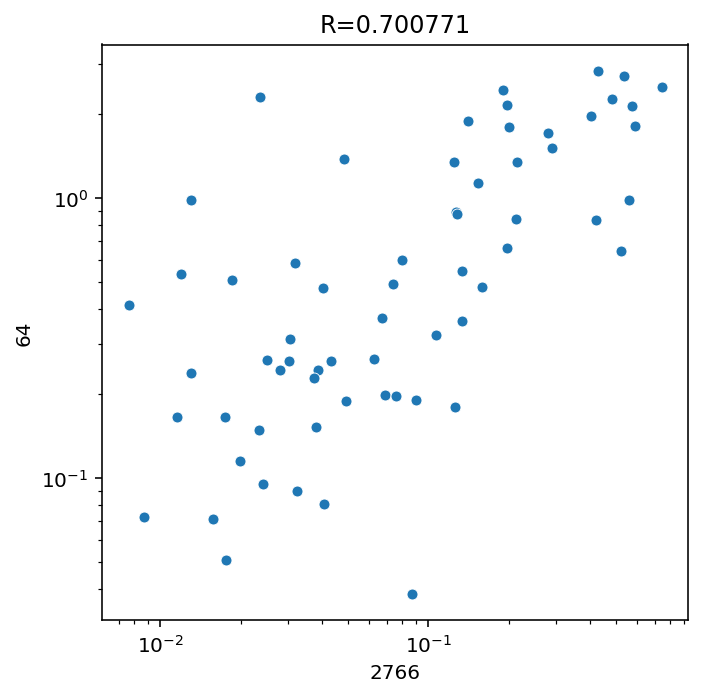

In [79]:

vec_1 = adata_2766.layers['log_raw'].mean(axis=0)
# vec_1 = np.log1p(vec_1)

vec_2 = adata_64.layers['log_raw'].mean(axis=0)
# vec_2 = np.log1p(vec_2)

from scipy import stats
stats_res = stats.pearsonr(vec_1, vec_2)
print(stats_res)
    
sns.reset_orig()
fig, ax = plt.subplots(figsize=(5,5))
ax.set(xscale="log", yscale="log")
plt.title(
    'R=%f' % np.corrcoef(vec_1, vec_2)[0, 1])  # Pearson product-moment correlation coefficients
sns.scatterplot(x=vec_1, y=vec_2, s=30)
plt.xlabel('2766')
plt.ylabel('64')
plt.tight_layout()
plt.savefig(os.path.join(fig_path, f'correlation_2766_64_norm.pdf'))
plt.show()

In [ ]:
adata_64.obs['top_level_2'] = adata_64.obs['top_level'].values
top_level_64_dict = {
    'Ex': 'CTX-Ex', 
    'Inhi': 'Inh',  
}

adata_64.obs['top_level_2'] = adata_64.obs['top_level_2'].replace(top_level_64_dict)
adata_64.obs['sample'] = adata_64.obs['sample'].replace({'AD_mouse9781': 'ADmouse_9781', 'AD_mouse9721': 'ADmouse_9721', 'AD_mouse9930': 'ADmouse_9930', 'AD_mouse9919': 'ADmouse_9919'})


In [ ]:
top_count_sample = pd.DataFrame(index=adata.obs['top_level'].cat.categories.to_list(), columns=adata.obs['sample'].cat.categories.to_list())

for sample in adata.obs['sample'].cat.categories:
    print(sample)
    current_obs = adata.obs.loc[adata.obs['sample'] == sample, :]
    current_count = current_obs['top_level'].value_counts()
    top_count_sample.loc[:, sample] = current_count

top_count_sample_64 = pd.DataFrame(index=adata_64.obs['top_level_2'].cat.categories.to_list(), columns=adata_64.obs['sample'].cat.categories.to_list())

for sample in adata_64.obs['sample'].cat.categories:
    print(sample)
    current_obs = adata_64.obs.loc[adata_64.obs['sample'] == sample, :]
    current_count = current_obs['top_level_2'].value_counts()
    top_count_sample_64.loc[:, sample] = current_count

top_count_sample = pd.concat([top_count_sample, top_count_sample_64], axis=1)
top_count_sample = top_count_sample.loc[~top_count_sample.index.isin(['LHb', 'Mix']), :]
top_count_sample['top_level'] = top_count_sample.index.values
top_count_sample_melt = pd.melt(top_count_sample, id_vars=['top_level'], value_vars=top_count_sample.columns.values)
top_count_sample_melt.columns = ['top_level', 'sample', 'value']
# top_count_sample_melt

In [ ]:
top_count_sample_melt['group'] = top_count_sample_melt['sample'].values
time_group_dict = {
    'ADmouse_9723': '2766', 'ADmouse_9735': '2766', 'ADmouse_9494': '2766', 'ADmouse_9498': '2766', 
    'ADmouse_9723_2': '2766', 'ADmouse_9707': '2766', 'ADmouse_11346': '2766', 'ADmouse_11351': '2766', 
    'ADmouse_9781': '64', 'ADmouse_9721': '64', 'ADmouse_9930': '64', 'ADmouse_9919': '64',}
top_count_sample_melt['group'] = top_count_sample_melt['group'].map(time_group_dict)
top_count_sample_melt['group'] = top_count_sample_melt['group'].astype('category')
top_count_sample_melt

In [ ]:
# plot barplot

sns.reset_orig()
cf_pl = sns.color_palette(['#f2eb24', '#2495f2'])
fig, ax = plt.subplots(figsize=(10, 7))
sns.barplot(x='top_level', y='value', hue='group', data=top_count_sample_melt, palette=cf_pl, ax=ax)

pairs = [((current_type, '2766'), (current_type, '64')) for current_type in top_count_sample.index]

annot = Annotator(ax, pairs, plot='barplot', data=top_count_sample_melt, x='top_level', y='value', hue='group')
annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2)
annot.apply_test(alternative='two-sided').annotate()

plt.savefig(os.path.join(fig_path, 'cluster_freq_top_level_2766_64.pdf'))

plt.show()

In [ ]:
adata_64.obs['gfap-positive'] = adata_64.obs['gfap'] >= 50
adata_64.obs['gfap-positive'] = adata_64.obs['gfap-positive'].replace({True:'Gfap+', False:'Gfap-'})
adata_64.obs['gfap-positive'] = adata_64.obs['gfap-positive'].astype('category')
adata_64.var.index = adata_64.var.index.str.capitalize()

In [ ]:
sc.set_figure_params(format='pdf', dpi=150)
genes = ['Gfap', 'Aldoc', 'Aqp4', 'Apoe', 'Vim']
sc.pl.matrixplot(adata_64, genes, 'gfap-positive', dendrogram=False, cmap='Reds', swap_axes=True, save='64_gfap',)

In [ ]:
adata_64.obs['gfap_norm'] = adata_64.obs['gfap'].values
min_v = adata_64.obs['gfap'].min()
max_v = adata_64.obs['gfap'].max()
adata_64.obs['gfap_norm'] = (adata_64.obs['gfap_norm'] - min_v) / max_v

adata_64.obs['astro_comparison'] = adata_64.obs['top_level'].values
adata_64.obs['astro_comparison'] = adata_64.obs['astro_comparison'].astype(object)
adata_64.obs.loc[adata_64.obs['top_level'] != 'Astro', 'astro_comparison'] = 'Others'
adata_64.obs['astro_comparison'] = adata_64.obs['astro_comparison'].astype('category')
adata_64.obs['astro_comparison'] = adata_64.obs['astro_comparison'].cat.reorder_categories(['Astro', 'Others'])

In [ ]:
# matrix plot
sc.pl.matrixplot(adata_64, 'gfap', 'top_level', dendrogram=False, cmap='Reds', swap_axes=True,)

In [ ]:
# violin plot

fig, ax = plt.subplots(figsize=(5, 5))
ax = sns.violinplot(x="astro_comparison", y="gfap_norm", data=adata_64.obs, palette=top_cpl,
                     inner="box", scale='width', width=.8)
plt.xticks(rotation=45)

# pairs = [((current_type, '2766'), (current_type, '64')) for current_type in top_count_sample.index]

annot = Annotator(ax, [('Astro', 'Others')], plot='violinplot', data=adata_64.obs, x='astro_comparison', y='gfap_norm')
annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2)
annot.apply_test(alternative='two-sided').annotate()

plt.savefig(os.path.join(fig_path, 'violin_gfap_astro_vs_others.pdf'))
plt.show()

#### R3-1

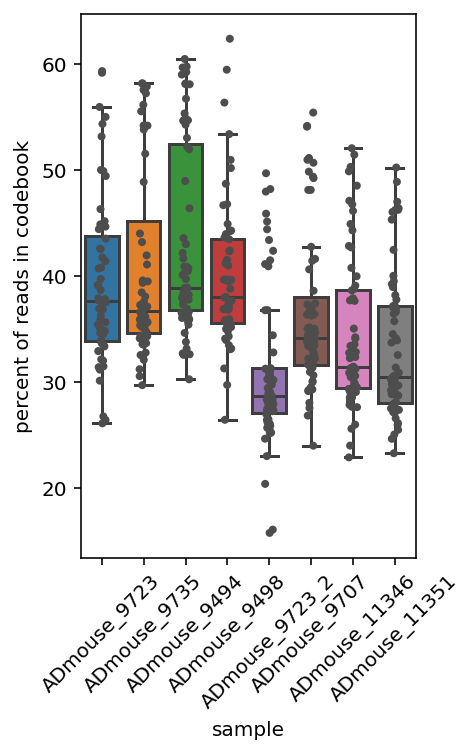

In [30]:
plotting_column = 'percent of reads in codebook'
spf_meta_file = 'Z:/Data/Analyzed/2022-01-03-Hu-AD/output/spot-finding-meta/Supplementary Table 2.xlsx'

spf_df = pd.DataFrame()
for sample in adata.obs['sample'].cat.categories:
    # print(sample)
    current_meta = pd.read_excel(spf_meta_file, sheet_name=sample)
    current_meta['sample'] = sample
    current_meta = current_meta.loc[:, [plotting_column, 'sample']]
    spf_df = pd.concat([spf_df, current_meta])

fig, ax = plt.subplots(figsize=(3,5))
sns.boxplot(x='sample', y=plotting_column, data=spf_df, fliersize=0, ax=ax)
sns.stripplot(x="sample", y=plotting_column, data=spf_df,
              size=4, color=".3", linewidth=0)
plt.xticks(rotation=45)
# plt.savefig(os.path.join(fig_path, 'spot-finding-meta-1.pdf'))
plt.show()

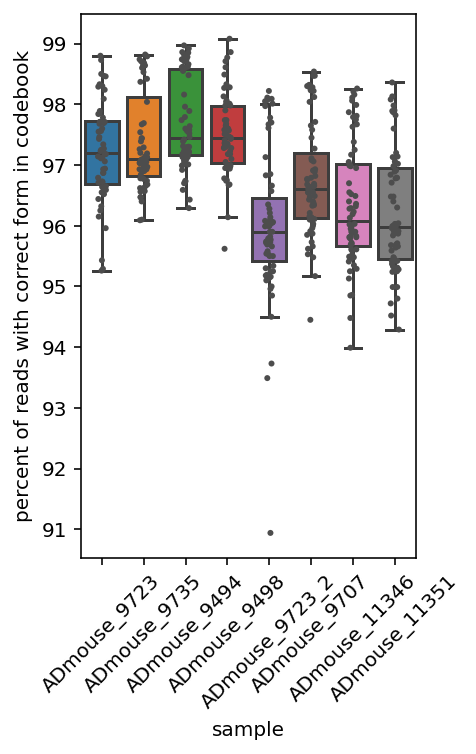

In [33]:
plotting_column = 'percent of reads with correct form in codebook'
spf_meta_file = 'Z:/Data/Analyzed/2022-01-03-Hu-AD/output/spot-finding-meta/Supplementary Table 2.xlsx'

spf_df = pd.DataFrame()
for sample in adata.obs['sample'].cat.categories:
    # print(sample)
    current_meta = pd.read_excel(spf_meta_file, sheet_name=sample)
    current_meta['sample'] = sample
    current_meta = current_meta.loc[:, [plotting_column, 'sample']]
    spf_df = pd.concat([spf_df, current_meta])

fig, ax = plt.subplots(figsize=(3,5))
sns.boxplot(x='sample', y=plotting_column, data=spf_df, fliersize=0, ax=ax)
sns.stripplot(x="sample", y=plotting_column, data=spf_df,
              size=3, color=".3", linewidth=0)
# ax.set(ylim=(0, 100))
plt.xticks(rotation=45)
# plt.savefig(os.path.join(fig_path, 'spot-finding-meta-2.pdf'))
plt.show()

In [40]:
import numpy as np, scipy.stats as st

pct_values = spf_df[plotting_column].values
st.t.interval(0.95, len(pct_values)-1, loc=np.mean(pct_values), scale=st.sem(pct_values))

(96.77216457120247, 96.96874264529237)

In [43]:
st.sem(pct_values)

0.0500229861199011

In [42]:
np.mean(pct_values)

96.87045360824742

meta NOT subset; don't know how to subset; dropped


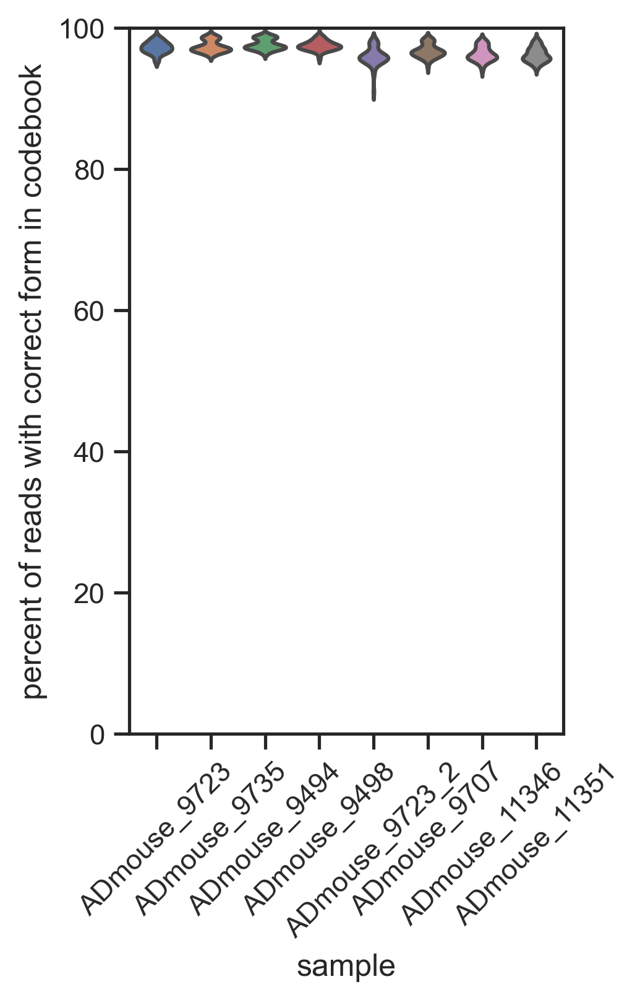

In [44]:
plotting_column = 'percent of reads with correct form in codebook'
spf_meta_file = 'Z:/Data/Analyzed/2022-01-03-Hu-AD/output/spot-finding-meta/Supplementary Table 2.xlsx'

spf_df = pd.DataFrame()
for sample in adata.obs['sample'].cat.categories:
    # print(sample)
    current_meta = pd.read_excel(spf_meta_file, sheet_name=sample)
    current_meta['sample'] = sample
    current_meta = current_meta.loc[:, [plotting_column, 'sample']]
    spf_df = pd.concat([spf_df, current_meta])

fig, ax = plt.subplots(figsize=(3,5))
sns.violinplot(x='sample', y=plotting_column, data=spf_df, fliersize=0, inner=None, ax=ax)
ax.set(ylim=(0, 100))
plt.xticks(rotation=45)
plt.savefig(os.path.join(fig_path, 'spot-finding-meta-3.pdf'))
plt.show()

In [9]:
# qc before filtering 
# Load data
expr_path = os.path.join(out_path, 'complete_cell_barcode_count.csv')
var_path = os.path.join(out_path, 'cell_barcode_names.csv')
obs_path = os.path.join(out_path, 'complete_meta.csv')

# Add expression data to the AnnData object 
expr_x = np.loadtxt(expr_path, delimiter=',')
var = pd.read_csv(var_path, header=None)
var = pd.DataFrame(index=var.iloc[:,2].to_list())
obs = pd.read_csv(obs_path, index_col=0)

adata = AnnData(X=expr_x, var=var, obs=obs)
adata

AnnData object with n_obs × n_vars = 76847 × 2766
    obs: 'orig_index', 'sample', 'area', 'x', 'y', 'tau'

In [ ]:
# Calculate QC metrics
sc.pp.calculate_qc_metrics(adata, percent_top=None, inplace=True)

In [ ]:
from scipy import stats
n = 3
mad = stats.median_absolute_deviation(adata.obs['log1p_total_counts'], scale=1)
lower_bd = adata.obs['log1p_total_counts'].median() - n*mad
upper_bd = adata.obs['log1p_total_counts'].median() + n*mad

print(lower_bd)
print(upper_bd)
print(np.expm1(lower_bd))
print(np.expm1(upper_bd))

In [ ]:
sns.reset_orig()
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(20, 5))

sns.histplot(adata.obs['total_counts'], bins=100, ax=axs[0])
median_counts = adata.obs['total_counts'].median()
axs[0].axvline(median_counts, c='r')
axs[0].set_title(f'Median: {median_counts}')

sns.histplot(adata.obs['n_genes_by_counts'], bins=100, ax=axs[1])
median_genes = adata.obs['n_genes_by_counts'].median()
axs[1].axvline(median_genes, c='r')
axs[1].set_title(f'Median: {median_genes}')

sns.histplot(adata.obs['log1p_total_counts'], bins=100, ax=axs[2])
axs[2].axvline(lower_bd, c='r')
axs[2].axvline(upper_bd, c='r')
axs[2].set_title(f'LB: {lower_bd}, UB: {upper_bd}')

plt.savefig(os.path.join(fig_path, 'qc_histogram_3col.pdf'))
plt.show()

In [ ]:
adata.obs

In [ ]:
sns.reset_orig()
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(20, 5))

sns.histplot(adata.obs['log1p_total_counts'], bins=100, ax=axs[0])
median_counts = adata.obs['log1p_total_counts'].median()
axs[0].axvline(median_counts, c='r')
axs[0].set_title(f'Median: {median_counts}')

sns.histplot(adata.obs['log1p_n_genes_by_counts'], bins=100, ax=axs[1])
median_genes = adata.obs['log1p_n_genes_by_counts'].median()
axs[1].axvline(median_genes, c='r')
axs[1].set_title(f'Median: {median_genes}')

sns.histplot(adata.obs['log1p_total_counts'], bins=100, ax=axs[2])
axs[2].axvline(lower_bd, c='r')
axs[2].axvline(upper_bd, c='r')
axs[2].set_title(f'LB: {lower_bd}, UB: {upper_bd}')

plt.savefig(os.path.join(fig_path, 'qc_histogram_3col_log.pdf'))
plt.show()

In [ ]:
sns.reset_orig()
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(13, 5))

sns.histplot(adata.obs['total_counts'], bins=50, ax=axs[0])
median_counts = adata.obs['total_counts'].median()
axs[0].axvline(median_counts, c='r')
axs[0].set_title(f'Median: {median_counts}')

sns.histplot(adata.obs['n_genes_by_counts'], bins=50, ax=axs[1])
median_genes = adata.obs['n_genes_by_counts'].median()
axs[1].axvline(median_genes, c='r')
axs[1].set_title(f'Median: {median_genes}')

plt.savefig(os.path.join(fig_path, 'qc_histogram_2col.pdf'))
plt.show()

In [ ]:
sns.reset_orig()
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(13, 5))

sns.histplot(adata.obs['log1p_total_counts'], bins=100, ax=axs[0])
median_counts = adata.obs['log1p_total_counts'].median()
axs[0].axvline(median_counts, c='r')
axs[0].set_title(f'Median: {median_counts}')

sns.histplot(adata.obs['log1p_n_genes_by_counts'], bins=100, ax=axs[1])
median_genes = adata.obs['log1p_n_genes_by_counts'].median()
axs[1].axvline(median_genes, c='r')
axs[1].set_title(f'Median: {median_genes}')

plt.savefig(os.path.join(fig_path, 'qc_histogram_2col_log.pdf'))
plt.show()

#### R3-2

In [ ]:
ave_df = pd.DataFrame()
for sample in adata.obs['sample'].cat.categories:
    # print(sample)
    sdata = adata[adata.obs['sample'] == sample, ]
    current_vec = sdata.raw.X.mean(axis=0)
    ave_df[sample] = current_vec
    
cor_df = ave_df.corr()

sns.clustermap(cor_df, cmap='bwr', z_score=0, annot=True, vmin=-2, vmax=2)

In [ ]:
ave_df = pd.DataFrame()
for sample in adata.obs['sample'].cat.categories:
    # print(sample)
    sdata = adata[adata.obs['sample'] == sample, ]
    current_vec = sdata.layers['corrected'].mean(axis=0)
    ave_df[sample] = current_vec
    
cor_df = ave_df.corr()

sns.clustermap(cor_df, cmap='bwr', annot=False, vmin=-1, vmax=1)

In [ ]:
ave_df = pd.DataFrame()
for sample in adata.obs['sample'].cat.categories:
    # print(sample)
    sdata = adata[adata.obs['sample'] == sample, ]
    current_vec = sdata.layers['corrected'].mean(axis=0)
    # current_vec = sdata.layers['raw'].mean(axis=0)
    #current_vec = sdata.raw.X.mean(axis=0)
    ave_df[sample] = current_vec
    
cor_df = ave_df.corr()
cor_df

sns.heatmap(cor_df.iloc[:4, 4:], cmap='bwr')

In [ ]:
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42

pair_list = [('ADmouse_9723', 'ADmouse_9723_2'), ('ADmouse_9735', 'ADmouse_9707'), 
             ('ADmouse_9494', 'ADmouse_11346'), ('ADmouse_9498', 'ADmouse_11351')]

label_list = [('TauPS2APP 8 mo. rep 1', 'TauPS2APP 8 mo. rep 2'), ('Control 8 mo. rep 1', 'Control 8 mo. rep 2'), 
             ('TauPS2APP 13 mo. rep 1', 'TauPS2APP 13 mo. rep 2'), ('Control 13 mo. rep 1', 'Control 13 mo. rep 2')]

ave_df = pd.DataFrame()
for i in range(len(pair_list)):
    sample1, sample2 = pair_list[i]
    label1, label2 = label_list[i]
    
    sdata = adata[adata.obs['sample'] == sample1, ]
    vec_1 = sdata.layers['raw'].mean(axis=0)
    vec_1 = np.log1p(vec_1)
    # vec_1 = sdata.raw.X.mean(axis=0)

    sdata = adata[adata.obs['sample'] == sample2, ]
    vec_2 = sdata.layers['raw'].mean(axis=0)
    vec_2 = np.log1p(vec_2)
    # vec_2 = sdata.raw.X.mean(axis=0)
    
    from scipy import stats
    stats_res = stats.pearsonr(vec_1, vec_2)
    print(stats_res)
    
    fig, ax = plt.subplots(figsize=(5,5))
    ax.set(xscale="log", yscale="log")
    plt.title(
        'R=%f' % np.corrcoef(vec_1, vec_2)[0, 1])  # Pearson product-moment correlation coefficients
    sns.scatterplot(x=vec_1, y=vec_2, s=5)
    plt.xlabel(label1)
    plt.ylabel(label2)
    plt.tight_layout()
    plt.savefig(os.path.join(fig_path, f'correlation_{label1}_log.pdf'))
    plt.show()

In [ ]:
adata.obs['sample-region'] = adata.obs['sample'].astype(str) + '-' + adata.obs['region_merged'].astype(str)
adata.obs['sample-region'] = adata.obs['sample-region'].astype('category')

ave_df = pd.DataFrame()
for sample in adata.obs['sample-region'].cat.categories:
    # print(sample)
    sdata = adata[adata.obs['sample-region'] == sample, ]
    current_vec = sdata.layers['corrected'].mean(axis=0)
    ave_df[sample] = current_vec
    
cor_df = ave_df.corr()

fig, ax = plt.subplots(figsize=(10,10))
sns.clustermap(cor_df, cmap='bwr', annot=False, vmin=-1, vmax=1)
# sns.heatmap(cor_df, cmap='bwr', annot=False, vmin=-1, vmax=1)
plt.savefig(os.path.join(fig_path, f'correlation_region.pdf'))
plt.show()

#### DAA

In [ ]:
# load hippo gene expression data
daa_ref_expr = pd.read_table('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/5xFAD-sNucSeq-master/geo/GSE143758_Admouse_Hippocampus_7m_AllNuclei_UMIcounts.txt',
                             delimiter='\t', header=0, index_col=0)
daa_ref_expr.head()

In [ ]:
# load habib cell annotation
daa_ref_obs = pd.read_table('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/5xFAD-sNucSeq-master/Time_Course_DATA/ADmouse.ASC.7m.Clusters.txt',
                             delimiter='\t', header=0, index_col=0)
daa_ref_obs.columns = ['cluster']
daa_ref_obs

In [ ]:
# create astro expr 
daa_ref_expr_subset = daa_ref_expr.loc[:, daa_ref_obs.index[daa_ref_obs.index.isin(daa_ref_expr.columns)]]
daa_ref_expr_subset = daa_ref_expr_subset.T
daa_ref_expr_subset.to_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/daa-expr.csv')

In [ ]:
# load astro expr 
daa_ref_expr_subset = pd.read_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/daa-expr.csv', index_col=0)
daa_ref_expr_subset

In [ ]:
# create adata for astro
adata_daa = AnnData(daa_ref_expr_subset.values, obs=daa_ref_obs.loc[daa_ref_obs.index.isin(daa_ref_expr_subset.index), :], var=pd.DataFrame(index=daa_ref_expr_subset.columns))
adata_daa

##### use all shared genes / markers

In [ ]:
# marker_genes = ['Luzp2', 'Slc7a10', 'Mfge8', 'Gfap', 'Id3', 'Aqp4', 'Myoc', 'Id1', 'Ctsb', 'Vim', 'Osmr', 'Serpina3n', 'Gsn', 'Ggta1']
shared_genes = list(set(adata.var.loc[adata.var['detected'], :].index) & set(adata_daa.var.index))
# shared_genes = list(set(adata.var.loc[adata.var['detected'], :].index) & set(marker_genes))
sdata = adata[adata.obs['top_level'] == 'Astro', shared_genes]
sdata_daa = adata_daa[:, shared_genes]

In [ ]:
sdata_daa
# save a copy of subset adata
sdata_daa.write_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/daa-shared-genes.h5ad')
sdata_daa_df = pd.DataFrame(sdata_daa.X, index=sdata_daa.obs.index, columns=sdata_daa.var.index)
sdata_daa_df.to_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/daa-shared-genes.csv')
sdata_daa.obs.to_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/daa-shared-genes-obs.csv')

sdata.write_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-shared-genes.h5ad')

In [ ]:
# starmap df 
sdata_df = pd.DataFrame(sdata.layers['scaled'], index=sdata.obs.index, columns=sdata.var.index)
sdata_df['cell_type'] = sdata.obs['cell_type']
sdata_df = sdata_df.groupby(by=["cell_type"]).mean()
sdata_df

In [ ]:
# habib df
sdata_daa_df = pd.DataFrame(sdata_daa.X, index=sdata_daa.obs.index, columns=sdata_daa.var.index)
sdata_daa_df['cluster'] = sdata_daa.obs['cluster']
sdata_daa_df = sdata_daa_df.groupby(by=["cluster"]).mean()
sdata_daa_df

In [ ]:
col_order = ['Astro1', 'Astro2', 'Astro3', '1', '2', '3', '4', '5', '6']
complete_coor_matrdatex = pd.DataFrame(np.corrcoef(sdata_df, sdata_daa_df), index=col_order, columns=col_order)
fig, ax = plt.subplots(figsize=(10,10))
sns.heatmap(complete_coor_matrdatex, annot=True)

In [ ]:
col_order_1 = ['Astro1', 'Astro2', 'Astro3']
col_order_2 = ['1', '2', '3', '4', '5', '6']
subset_coor_matrdatex = pd.DataFrame(np.corrcoef(sdata_df, sdata_daa_df)[:3, 3:], index=col_order_1, columns=col_order_2)
fig, ax = plt.subplots(figsize=(10,10))
sns.heatmap(subset_coor_matrdatex, annot=True)

In [ ]:
from scipy import stats
rho, pval = stats.spearmanr(sdata_df.T, sdata_daa_df.T)
rho

In [ ]:
col_order = ['Astro1', 'Astro2', 'Astro3', '1', '2', '3', '4', '5', '6']
complete_coor_matrdatex = pd.DataFrame(rho, index=col_order, columns=col_order)
fig, ax = plt.subplots(figsize=(10,10))
sns.heatmap(complete_coor_matrdatex, annot=True)

In [ ]:
col_order_1 = ['Astro1', 'Astro2', 'Astro3']
col_order_2 = ['1', '2', '3', '4', '5', '6']
subset_coor_matrdatex = pd.DataFrame(rho[:3, 3:], index=col_order_1, columns=col_order_2)
fig, ax = plt.subplots(figsize=(10,10))
sns.heatmap(subset_coor_matrdatex, annot=True)

##### harmony integration

In [ ]:
import anndata as an

sdata_daa = sc.read_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/daa-shared-genes.h5ad')
sdata = sc.read_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-shared-genes.h5ad')

sdata.X = sdata.layers['raw'].copy()
cdata = an.concat([sdata, sdata_daa], join="outer")
cdata.obs['harmony'] = 6789*['STARmap'] + 7341*['scRNA-Seq']
cdata.obs['label'] = 'NA'
cdata.obs.loc[cdata.obs['harmony'] == 'STARmap', 'label'] = cdata.obs.loc[cdata.obs['harmony'] == 'STARmap', 'cell_type'].values
cdata.obs.loc[cdata.obs['harmony'] == 'scRNA-Seq', 'label'] = cdata.obs.loc[cdata.obs['harmony'] == 'scRNA-Seq', 'cluster'].values
del cdata.layers
cdata

In [ ]:
# pp for habib data
sc.pp.normalize_total(cdata)
sc.pp.log1p(cdata)
sc.pp.scale(cdata)
sc.tl.pca(cdata)
sc.pl.pca(cdata, color='harmony')
sc.pl.pca_variance_ratio(cdata, log=False)

In [ ]:
g = sns.jointplot(x=cdata.obsm['X_pca'][:, 0], y=cdata.obsm['X_pca'][:, 1], hue=cdata.obs['harmony'],
                 s=1)
g.set_axis_labels('PC1', 'PC2')
plt.show()

In [ ]:
import scanpy.external as sce

sce.pp.harmony_integrate(cdata, 'harmony')

In [ ]:
g = sns.jointplot(x=cdata.obsm['X_pca_harmony'][:, 0], y=cdata.obsm['X_pca_harmony'][:, 1], hue=cdata.obs['harmony'],
                 s=1)
g.set_axis_labels('PC1', 'PC2')
plt.show()

##### scanorama integration

In [ ]:
sce.pp.scanorama_integrate(cdata, 'harmony')

In [ ]:
g = sns.jointplot(x=cdata.obsm['X_scanorama'][:, 0], y=cdata.obsm['X_scanorama'][:, 1], hue=cdata.obs['harmony'],
                 s=1)
g.set_axis_labels('PC1', 'PC2')
plt.show()

In [ ]:
sdata_daa = sc.read_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/daa-shared-genes.h5ad')
sdata = sc.read_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-shared-genes.h5ad')
sdata_daa.obs['cluster'] = sdata_daa.obs['cluster'].astype('category')

In [ ]:
# pp for habib data
sc.pp.normalize_total(sdata_daa)
sc.pp.log1p(sdata_daa)
sc.pp.scale(sdata_daa)
sc.tl.pca(sdata_daa)
sc.pl.pca(sdata_daa, color='cluster')
sc.pl.pca_variance_ratio(sdata_daa, log=False)

In [ ]:
# umap/diffmap for habib data
n_pcs = 18
sc.pp.neighbors(sdata_daa, n_neighbors=30, n_pcs=n_pcs)
sc.tl.umap(sdata_daa)
sc.tl.diffmap(sdata_daa, n_comps=n_pcs)
sc.pl.umap(sdata_daa, color='cluster')
sc.pl.diffmap(sdata_daa, color='cluster')

In [ ]:
# umap/diffmap for starmap data
n_pcs = 4
sc.tl.pca(sdata)
sc.pp.neighbors(sdata, n_neighbors=30, n_pcs=n_pcs)
sc.tl.umap(sdata)
sc.tl.diffmap(sdata, n_comps=n_pcs)
sc.pl.umap(sdata, color='cell_type')
sc.pl.diffmap(sdata, color='cell_type')

##### ingest

In [ ]:
sc.tl.ingest(sdata, sdata_daa, obs='cluster', embedding_method='pca')
sc.pl.umap(sdata, color=['cell_type', 'cluster'], wspace=0.5)

In [ ]:
sc.pl.diffmap(sdata, color=['cell_type', 'cluster'], wspace=0.5)

In [ ]:
fig, axs = plt.subplots(figsize=(20,5), ncols=3, nrows=1)
a = pd.crosstab(sdata.obs.cell_type, sdata.obs.cluster)
b = pd.crosstab(sdata.obs.loc[sdata.obs['time'] == '8months', 'cell_type'], 
           sdata.obs.loc[sdata.obs['time'] == '8months', 'cluster'])
c = pd.crosstab(sdata.obs.loc[sdata.obs['time'] == '13months', 'cell_type'], 
           sdata.obs.loc[sdata.obs['time'] == '13months', 'cluster'])
sns.heatmap(a, annot=True, fmt='d', ax=axs[0])
axs[0].set_title('all')
sns.heatmap(b, annot=True, fmt='d', ax=axs[1])
axs[1].set_title('8 months')
sns.heatmap(c, annot=True, fmt='d', ax=axs[2])
axs[2].set_title('13 months')

In [ ]:
sdata.obs['cluster'] = sdata.obs['cluster'].astype(str)
sdata.obs['cluster'] = sdata.obs['cluster'].astype('category')

In [ ]:
sc.tl.embedding_density(sdata, groupby='cluster')
sc.pl.embedding_density(sdata, groupby='cluster', basis='diffmap')

In [ ]:
sub_cpl = sns.color_palette('tab10', 6)
sns.palplot(sub_cpl, size=3)
plt.xticks(range(6), range(1, 7), size=10, rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
# Plot time-group UMAP
scale_factor = 5000000
alpha = .5
for i, cluster in enumerate(sorted(sdata.obs['cluster'].unique())):
    
    fig, ax = plt.subplots(figsize=(10,7))
    sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='', palette=sns.color_palette(['#fafafa']))
    sc.pl.diffmap(sdata[sdata.obs["cluster"] == cluster], color='cluster', frameon=False, ax=ax, size=(scale_factor / sdata.n_obs), legend_loc=None, alpha=alpha,
               title='', palette=sns.color_palette([sub_cpl[i]]), save=f'_habib_{cluster}')

In [ ]:
# Plot time-group UMAP
scale_factor = 5000000
alpha = .5
for sample in sorted(sdata.obs['time-group'].unique()):
    print(sample)
    fig, ax = plt.subplots(figsize=(10,7))
    sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='', palette=sns.color_palette(['#fafafa']))
    sc.pl.diffmap(sdata[sdata.obs["time-group"] == sample], color='cluster', frameon=False, ax=ax, size=(scale_factor / sdata.n_obs), legend_loc=None, alpha=alpha,
               title='', palette=sub_cpl, save=f'_habib_{sample}')

In [ ]:
# Plot UMAP with cluster labels w/ new color
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.diffmap(sdata, color='cluster', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs), alpha=alpha,
           legend_loc=False, palette=sub_cpl, save=f'_habib_all')

In [ ]:
for i in range(4, 20):
    sc.tl.pca(sdata_daa)
    sc.pp.neighbors(sdata_daa, n_neighbors=30, n_pcs=i)
    sc.tl.umap(sdata_daa)
    sc.tl.ingest(sdata, sdata_daa, obs='cluster', embedding_method='pca')
    df = pd.crosstab(sdata.obs.cell_type, sdata.obs.cluster)
    print(i, df.loc['Astro3', 4])

##### BBKNN

In [ ]:
cdata = sdata.concatenate(sdata_daa, batch_categories=['STARmap', 'scRNA-Seq'], join='outer')
cdata

In [ ]:
cdata.obs['cluster'] = cdata.obs['cluster'].astype(str)
cdata.obs['cluster'] = cdata.obs['cluster'].astype('category')

In [ ]:
sc.pl.umap(cdata, color=['batch', 'cluster'])

In [ ]:
sc.tl.pca(cdata)
sc.pl.pca(cdata, color='batch')

In [ ]:
sc.external.pp.bbknn(cdata, batch_key='batch')

In [ ]:
sc.tl.umap(cdata)
sc.pl.umap(cdata, color=['batch', 'cluster'], wspace=0.5)

In [ ]:
sdata.obs['cell_type'].value_counts()

#### human data

In [ ]:
import anndata as ad
expr_temp = ad.read_mtx('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/snRNAseqPFC_BA10/filtered_count_matrix.mtx')

human_var_temp = pd.read_table('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/snRNAseqPFC_BA10/filtered_gene_row_names.txt',
                             delimiter='\t', header=None)
human_var = pd.DataFrame(index=human_var_temp.loc[:, 0].values)

human_obs = pd.read_table('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/snRNAseqPFC_BA10/filtered_column_metadata.txt',
                             delimiter='\t', header=0)
human_obs.index = human_obs['TAG'].values

hdata = AnnData(expr_temp.X.T, obs=human_obs, var=human_var)
hdata

In [ ]:
hdata.write_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/human-complete.h5ad')

In [ ]:
# load gprofiler gene list 
gprofiler_df = pd.read_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/gprofiler-conversion.csv', header=0)
gprofiler_df = gprofiler_df.drop_duplicates('initial_alias')
gprofiler_df

In [ ]:
# load syngo gene list 
syngo_df = pd.read_excel('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/syngo-conversion.xlsx', header=0)
syngo_df

In [ ]:
# Load new data
adata = sc.read_h5ad(os.path.join(out_path, '2022-04-06-Hu-AD-stardist-scaled.h5ad'))
adata.var['mouse_symbol'] = adata.var.index.values
del adata.uns
adata

In [ ]:
adata.var.index = adata.var.index.str.upper()
syngo_df.index = syngo_df['query']
new_var = pd.concat([test, test2], axis=1)
adata.var = new_var.copy()
adata = adata[:, ~adata.var['symbol'].isna()]
adata.var.index = adata.var['symbol']
adata = adata[:, ~adata.var.index.duplicated()]
adata.var.index.name = None
adata

In [ ]:
adata.write_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/starmap-human-genes.h5ad')
# adata.var.to_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/starmap-var.csv')

In [ ]:
# Subset
sub_id = 'Astro'
curr_cells = adata.obs['top_level'] == sub_id
sdata = adata[curr_cells, :]
sdata

In [ ]:
sdata.write_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/starmap-astro-human-genes.h5ad')

In [ ]:
adata.write_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/starmap-human-genes-clean.h5ad')

In [ ]:
import scipy as sp

In [ ]:
sdata = sc.read_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/h5ad/starmap-astro-human-genes.h5ad')
sdata.var.to_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/h5ad/starmap-human-genes-astro-var.csv')
sdata.var = pd.DataFrame(index=sdata.var.index)
sdata.X = sp.sparse.csr_matrix(sdata.X)
sdata.write_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/h5ad/starmap-human-genes-astro.h5ad')

In [ ]:
adata = sc.read_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/h5ad/starmap-human-genes.h5ad')
adata.var.to_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/h5ad/starmap-human-genes-var.csv')
adata.var = pd.DataFrame(index=adata.var.index)
adata.write_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/h5ad/starmap-human-genes-clean.h5ad')

In [ ]:
# save as dfs 
adata = sc.read_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/h5ad/starmap-human-genes.h5ad')

output_path = 'Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/starmap-human-genes/'
np.savetxt(os.path.join(output_path, 'expr_raw.csv'), adata.layers['raw'], delimiter=",")
# np.savetxt(os.path.join(output_path, 'expr_norm.csv'), adata.layers['norm'], delimiter=",")
# np.savetxt(os.path.join(output_path, 'expr_scaled.csv'), adata.layers['scaled'], delimiter=",")
# np.savetxt(os.path.join(output_path, 'expr_corrected.csv'), adata.layers['corrected'], delimiter=",")
# adata.var.to_csv(os.path.join(output_path, 'var.csv'))
# adata.obs.to_csv(os.path.join(output_path, 'obs.csv'))

In [ ]:
# save as dfs (astro, micro, oligo)
adata = sc.read_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/h5ad/starmap-human-genes.h5ad')

for sub_id in ['Astro', 'Micro', 'Oligo']:
    
    curr_cells = adata.obs['top_level'] == sub_id
    sdata = adata[curr_cells, :]

    output_path = f'Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/starmap-human-genes-{sub_id.lower()}/'
    if not os.path.exists(output_path):
        os.mkdir(output_path)

    np.savetxt(os.path.join(output_path, 'expr_corrected.csv'), sdata.layers['corrected'], delimiter=",")
    sdata.var.to_csv(os.path.join(output_path, 'var.csv'))
    sdata.obs.to_csv(os.path.join(output_path, 'obs.csv'))

In [ ]:
# save as dfs (astro, micro, oligo)
adata = sc.read_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/h5ad/starmap-human-genes.h5ad')

for sub_id in ['Astro', 'Micro', 'Oligo']:
    
    curr_cells = adata.obs['top_level'] == sub_id
    sdata = adata[curr_cells, :]

    output_path = f'Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/starmap-human-genes-{sub_id.lower()}/'
    if not os.path.exists(output_path):
        os.mkdir(output_path)

    np.savetxt(os.path.join(output_path, 'expr_corrected.csv'), sdata.layers['corrected'], delimiter=",")
    sdata.var.to_csv(os.path.join(output_path, 'var.csv'))
    sdata.obs.to_csv(os.path.join(output_path, 'obs.csv'))

In [ ]:
# save as dfs (cortex)
adata = sc.read_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/h5ad/starmap-human-genes.h5ad')
    
curr_cells = adata.obs['region'] == 'Cortex'
sdata = adata[curr_cells, :]

output_path = f'Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/starmap-human-genes-cortex/'
if not os.path.exists(output_path):
    os.mkdir(output_path)

np.savetxt(os.path.join(output_path, 'expr_corrected.csv'), sdata.layers['corrected'], delimiter=",")
sdata.var.to_csv(os.path.join(output_path, 'var.csv'))
sdata.obs.to_csv(os.path.join(output_path, 'obs.csv'))

In [ ]:
# save as dfs (cortex)
adata = sc.read_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/h5ad/starmap-human-genes.h5ad')
    
curr_cells = adata.obs['top_level'].isin(['CA1', 'CA2', 'CA3', 'DG'])
sdata = adata[~curr_cells, :]

output_path = f'Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/starmap-human-genes-nohipoex/'
if not os.path.exists(output_path):
    os.mkdir(output_path)

np.savetxt(os.path.join(output_path, 'expr_corrected.csv'), sdata.layers['corrected'], delimiter=",")
sdata.var.to_csv(os.path.join(output_path, 'var.csv'))
sdata.obs.to_csv(os.path.join(output_path, 'obs.csv'))

In [ ]:
# save as dfs (human)
hdata = sc.read_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/h5ad/human-complete.h5ad')

output_path = 'Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/human-complete/'
np.savetxt(os.path.join(output_path, 'expr_raw.csv'), hdata.X, delimiter=",")
hdata.var.to_csv(os.path.join(output_path, 'var.csv'))
hdata.obs.to_csv(os.path.join(output_path, 'obs.csv'))

In [ ]:
# save as dfs (starmap daa)
hdata = sc.read_h5ad('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-habib/starmap-shared-genes.h5ad')

output_path = 'Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-habib/'
np.savetxt(os.path.join(output_path, 'expr_corrected.csv'), hdata.layers['corrected'], delimiter=",")
hdata.var.to_csv(os.path.join(output_path, 'var.csv'))
hdata.obs.to_csv(os.path.join(output_path, 'obs.csv'))

In [ ]:
adata.var['detected'].value_counts()

#### human integration 

In [ ]:
# Load new data
adata = sc.read_h5ad(os.path.join(out_path, '2022-04-06-Hu-AD-stardist-scaled.h5ad'))
adata

In [ ]:
# load prediction label (all cells)
cca_top_df = pd.read_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/starmap-human-genes/predicted_human_top_level.csv')
cca_sub_df = pd.read_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/starmap-human-genes/predicted_human_sub_level.csv')

# # load prediction label (nohipoex)
# cca_top_df = pd.read_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/starmap-human-genes-nohipoex/predicted_human_top_level.csv')
# cca_sub_df = pd.read_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/starmap-human-genes-nohipoex/predicted_human_sub_level.csv')

# load umap 
current_umap_embedding = np.loadtxt(os.path.join(fig_path, f'embedding_top_level_umap.csv'), delimiter=',')
adata.obsm['X_umap'] = current_umap_embedding

In [ ]:
# curr_cells = adata.obs['top_level'].isin(['CA1', 'CA2', 'CA3', 'DG'])
# adata = adata[~curr_cells, :]

adata.obs['predicted_top_level'] = cca_top_df['predicted.id'].values
adata.obs['predicted_top_level_score'] = cca_top_df['prediction.score.max'].values
adata.obs['predicted_sub_level'] = cca_sub_df['predicted.id'].values
adata.obs['predicted_sub_level_score'] = cca_sub_df['prediction.score.max'].values

In [ ]:
fig, axs = plt.subplots(figsize=(15, 4), ncols=2, nrows=1)
sns.histplot(adata.obs['predicted_top_level_score'], ax=axs[0], bins=50)
axs[0].axvline(0.5, c='r')
sns.violinplot(x='predicted_top_level', y='predicted_top_level_score', data=adata.obs, inner=None, ax=axs[1])
plt.show()

In [ ]:
fig, ax = plt.subplots(figsize=(10,10), ncols=1, nrows=1)
a = pd.crosstab(adata.obs.top_level, adata.obs.predicted_top_level)
sns.heatmap(a, annot=True, fmt='d', ax=ax)

In [ ]:
from sklearn.preprocessing import StandardScaler
std_scaler = StandardScaler()
# df_scaled = std_scaler.fit_transform(b.to_numpy())
# df_scaled = pd.DataFrame(df_scaled, columns=b.columns, index=b.index)

df_scaled = std_scaler.fit_transform(b.T.to_numpy())
df_scaled = pd.DataFrame(df_scaled, columns=b.index, index=b.columns)

fig, ax = plt.subplots(figsize=(10,10), ncols=1, nrows=1)
sns.heatmap(df_scaled, annot=False, fmt='.2f', ax=ax, cmap='bwr', vmin=-2, vmax=2)
plt.savefig(os.path.join(fig_path, 'heatmap-starmap-human-frequency-scaled.pdf'))

In [ ]:
adata

In [ ]:
fig, ax = plt.subplots(figsize=(10,10), ncols=1, nrows=1)
thres = 0.5
a = pd.crosstab(adata.obs.loc[adata.obs['predicted_top_level_score'] >= thres, 'top_level'], adata.obs.loc[adata.obs['predicted_top_level_score'] >= thres, 'predicted_top_level'])
b = a.div(a.sum(axis=1), axis=0)
b = b.loc[:, ['Ex', 'In', 'Ast', 'End', 'Mic', 'Oli', 'Opc', 'Per']]
sns.heatmap(b, annot=False, fmt='.2f', ax=ax, cmap='viridis', linewidths=0)
# plt.savefig(os.path.join(fig_path, 'heatmap-starmap-human-nohippoex-frequency.pdf'))

In [ ]:
adata.obs['predicted_top_level'] = adata.obs['predicted_top_level'].astype('category')
adata.obs['predicted_top_level'] = adata.obs['predicted_top_level'].cat.reorder_categories(['Ex', 'In', 'Ast', 'End', 'Mic', 'Oli', 'Opc', 'Per'])

In [ ]:
# plot umap
sc.pl.umap(adata, color=['top_level', 'predicted_top_level', 'predicted_top_level_score'])

In [ ]:
# Check color legend
top_cpl = []
for i in adata.obs['top_level'].cat.categories:
    top_cpl.append(adata.uns['top_level_rgb_dict'][i])

top_cpl = sns.color_palette(top_cpl)
top_cmap = ListedColormap(top_cpl.as_hex())
sns.palplot(top_cpl, size=3)
plt.xticks(range(len(adata.uns['top_level_order'])), adata.uns['top_level_order'], size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'{fig_path}/color_legend_top.tif')
plt.show()

In [ ]:
human_cpl = sns.color_palette(['#b0d896', '#4cab56', '#a5cfdd', '#fcd1d7', '#fc9c9c', '#ec3445', '#fdbb78', '#e39a6d'])
sns.palplot(human_cpl, size=3)

In [ ]:
# Plot UMAP with cluster labels w/ new color
scale_factor = 900000
alpha = .7

fig, ax = plt.subplots(figsize=(10,7))
sc.pl.umap(adata, show=False, size=(scale_factor / adata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.umap(adata, color='top_level', frameon=False, ax=ax, title='', size=(scale_factor / adata.n_obs),
           legend_loc=False, palette=top_cpl, save='_all')

fig, ax = plt.subplots(figsize=(10,7))
sc.pl.umap(adata, show=False, size=(scale_factor / adata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.umap(adata, color='predicted_top_level', frameon=False, ax=ax, title='', size=(scale_factor / adata.n_obs),
           legend_loc=False, palette=human_cpl, save='_human_integration')

fig, ax = plt.subplots(figsize=(10,7))
sc.pl.umap(adata, show=False, size=(scale_factor / adata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.umap(adata, color='predicted_top_level_score', frameon=False, ax=ax, title='', size=(scale_factor / adata.n_obs),
           legend_loc=False, save='_human_integration_score')

In [ ]:
fig, ax = plt.subplots()
sns.histplot(adata.obs['predicted_sub_level_score'], bins=50, ax=ax)
ax.axvline(0.5, c='r')
plt.show()

fig, ax = plt.subplots(figsize=(15, 4), ncols=1, nrows=1)
sns.violinplot(x='predicted_sub_level', y='predicted_sub_level_score', data=adata.obs.sort_values('predicted_sub_level'), inner=None, ax=ax)
plt.xticks(rotation=45, ha='right')
plt.show()

In [ ]:
fig, ax = plt.subplots(figsize=(40,40), ncols=1, nrows=1)
a = pd.crosstab(adata.obs.cell_type, adata.obs.predicted_sub_level)
sns.heatmap(a, annot=True, fmt='d', ax=ax, cbar=False)

In [ ]:
fig, ax = plt.subplots(figsize=(40,40), ncols=1, nrows=1)
a = pd.crosstab(adata.obs.loc[adata.obs['predicted_sub_level_score'] >= 0.5, 'cell_type'], adata.obs.loc[adata.obs['predicted_sub_level_score'] >= 0.5, 'predicted_sub_level'])
b = a.div(a.sum(axis=1), axis=0)
# b = b.loc[:, ['Ex', 'In', 'Ast', 'End', 'Mic', 'Oli', 'Opc', 'Per']]
sns.heatmap(b, annot=True, fmt='.2f', ax=ax, )

In [ ]:
c = b.loc[['Astro1', 'Astro2', 'Astro3'], ['Ast0', 'Ast1']]
# c = b.loc[['Micro1', 'Micro2', 'Micro3'], ['Mic0', 'Mic1']]
# c = b.loc[['Oligo1', 'Oligo2', 'Oligo3'], ['Oli0', 'Oli1']]
sns.heatmap(c, annot=True, fmt='.2f')
plt.show()

In [ ]:
adata.obs['top_level'].value_counts()

In [ ]:
adata.obs['cell_type'].value_counts()

#### human integration astro

In [ ]:
# Load new data
adata = sc.read_h5ad(os.path.join(out_path, '2022-04-06-Hu-AD-stardist-scaled.h5ad'))
sdata = adata[adata.obs['top_level'] == 'Astro', ]
sdata

In [ ]:
# load prediction label
cca_top_df = pd.read_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-mathys/starmap-human-genes-astro/predicted_human_ref_subcluster.csv')

# load umap 
current_embedding = np.loadtxt(os.path.join(fig_path, f'embedding_Astro_diffmap.csv'), delimiter=',')
sdata.obsm['X_diffmap'] = current_embedding

In [ ]:

sdata.obs['predicted_cluster'] = cca_top_df['predicted.id'].values
sdata.obs['predicted_cluster_score'] = cca_top_df['prediction.score.max'].values

In [ ]:
fig, axs = plt.subplots(figsize=(15, 4), ncols=2, nrows=1)
sns.histplot(sdata.obs['predicted_cluster_score'], ax=axs[0], bins=50)
axs[0].axvline(0.5, c='r')
sns.violinplot(x='predicted_cluster', y='predicted_cluster_score', data=sdata.obs, inner=None, ax=axs[1])
plt.show()

In [ ]:
fig, ax = plt.subplots(figsize=(10,10), ncols=1, nrows=1)
a = pd.crosstab(sdata.obs.cell_type, sdata.obs.predicted_cluster)
sns.heatmap(a, annot=True, fmt='d', ax=ax)

In [ ]:
fig, ax = plt.subplots(figsize=(10,10), ncols=1, nrows=1)
a = pd.crosstab(sdata.obs.cell_type, sdata.obs.predicted_cluster)
b = a.div(a.sum(axis=1), axis=0)
sns.heatmap(b, annot=True, fmt='.2f', ax=ax, cmap='bwr')

In [ ]:
fig, ax = plt.subplots(figsize=(10,10), ncols=1, nrows=1)
thres = 0.5
a = pd.crosstab(sdata.obs.loc[sdata.obs['predicted_cluster_score'] >= thres, 'cell_type'], sdata.obs.loc[sdata.obs['predicted_cluster_score'] >= thres, 'predicted_cluster'])
b = a.div(a.sum(axis=1), axis=0)
sns.heatmap(b, annot=True, fmt='.2f', ax=ax, cmap='viridis')

In [ ]:
from sklearn.preprocessing import StandardScaler
std_scaler = StandardScaler()
# df_scaled = std_scaler.fit_transform(b.to_numpy())
# df_scaled = pd.DataFrame(df_scaled, columns=b.columns, index=b.index)

df_scaled = std_scaler.fit_transform(b.T.to_numpy())
df_scaled = pd.DataFrame(df_scaled, columns=b.index, index=b.columns)

fig, ax = plt.subplots(figsize=(10,10), ncols=1, nrows=1)
sns.heatmap(df_scaled, annot=True, fmt='.2f', ax=ax, cmap='bwr', vmin=-2, vmax=2)
plt.savefig(os.path.join(fig_path, 'heatmap-starmap-human-astro-frequency.pdf'))

In [ ]:
sdata.obs['predicted_cluster'] = sdata.obs['predicted_cluster'].astype('category')

In [ ]:

sc.pl.diffmap(sdata, color=['cell_type', 'predicted_cluster', 'predicted_cluster_score'])

In [ ]:
# Check color legend
current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in sdata.obs['cell_type'].unique()]
sub_cpl = []
for i in current_cell_type_order:
    sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

sub_cpl = sns.color_palette(sub_cpl)
sub_cmap = ListedColormap(sub_cpl.as_hex())
sns.palplot(sub_cpl, size=3)
plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'./figures/color_legend_top.png')
plt.show()

In [ ]:
# Plot UMAP with cluster labels w/ new color
scale_factor = 900000
alpha = .7

fig, ax = plt.subplots(figsize=(10,7))
sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.diffmap(sdata, color='cell_type', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs),
           legend_loc=False, palette=sub_cpl, save='_astro')

fig, ax = plt.subplots(figsize=(10,7))
sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.diffmap(sdata, color='predicted_cluster', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs),
           legend_loc=False, palette='tab10', save='_human_integration_astro')

fig, ax = plt.subplots(figsize=(10,7))
sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.diffmap(sdata, color='predicted_cluster_score', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs),
           legend_loc=False, save='_human_integration_score_astro')

In [ ]:
# Plot UMAP
scale_factor = 900000
for i, cluster in enumerate(sorted(sdata.obs['predicted_cluster'].unique())):
    
    fig, ax = plt.subplots(figsize=(10,7))
    sc.pl.diffmap(sdata, show=False, color=None, alpha=1, size=(scale_factor / sdata.n_obs), ax=ax, title='', palette=sns.color_palette(['#fafafa']))
    sc.pl.diffmap(sdata[sdata.obs["predicted_cluster"] == cluster], color='predicted_cluster', frameon=False, ax=ax, legend_loc=None, size=(scale_factor / sdata.n_obs),
               title='', palette=sns.color_palette([sdata.uns['predicted_cluster_colors'][i]]), save=f'_human_integration_astro_{cluster}')

In [ ]:
# Plot UMAP
scale_factor = 900000
for i, cluster in enumerate(sorted(sdata.obs['cell_type'].unique())):
    
    fig, ax = plt.subplots(figsize=(10,7))
    sc.pl.diffmap(sdata, show=False, color=None, alpha=1, size=(scale_factor / sdata.n_obs), ax=ax, title='', palette=sns.color_palette(['#fafafa']))
    sc.pl.diffmap(sdata[sdata.obs["cell_type"] == cluster], color='cell_type', frameon=False, ax=ax, legend_loc=None, size=(scale_factor / sdata.n_obs),
               title='', palette=sns.color_palette([sdata.uns['cell_type_colors'][i]]), save=f'_human_integration_astro_{cluster}')

In [ ]:
sub_count_sample = pd.DataFrame(index=sdata.obs['predicted_cluster'].cat.categories.to_list(), columns=sdata.obs['sample'].cat.categories.to_list())

for sample in sdata.obs['sample'].cat.categories:
    print(sample)
    current_obs = sdata.obs.loc[sdata.obs['sample'] == sample, :]
    current_count = current_obs['predicted_cluster'].value_counts()
    sub_count_sample.loc[:, sample] = current_count
sub_count_sample

In [ ]:
sub_count_sample['predicted_cluster'] = sub_count_sample.index.values
sub_count_sample_melt = pd.melt(sub_count_sample, id_vars=['predicted_cluster'], value_vars=adata.obs['sample'].cat.categories.to_list())
sub_count_sample_melt.columns = ['predicted_cluster', 'sample', 'value']
sub_count_sample_melt['time-group'] = sub_count_sample_melt['sample'].values
time_group_dict = {
    'ADmouse_9723': '8months-disease', 'ADmouse_9735': '8months-control', 'ADmouse_9494': '13months-disease', 'ADmouse_9498': '13months-control', 
    'ADmouse_9723_2': '8months-disease', 'ADmouse_9707': '8months-control', 'ADmouse_11346': '13months-disease', 'ADmouse_11351': '13months-control', 
                  }
sub_count_sample_melt['time-group'] = sub_count_sample_melt['time-group'].map(time_group_dict)
sub_count_sample_melt[['time', 'group']] = sub_count_sample_melt['time-group'].str.split('-', 1, expand=True)
sub_count_sample_melt['group'] = sub_count_sample_melt['group'].astype('category')
sub_count_sample_melt['type-group'] = sub_count_sample_melt['predicted_cluster'].astype(str) + '-' + sub_count_sample_melt['group'].astype(str)
sub_count_sample_melt['type-group'] = sub_count_sample_melt['type-group'].astype('category')
# sub_count_sample_melt

In [ ]:
sub_count_sample_melt['predicted_cluster'] = sub_count_sample_melt['predicted_cluster'].astype('category')
sub_count_sample_melt['code'] = sub_count_sample_melt['predicted_cluster'].cat.codes
sub_count_sample_melt.loc[sub_count_sample_melt['group'] == 'disease', 'code'] = sub_count_sample_melt.loc[sub_count_sample_melt['group'] == 'disease', 'code'] + 0.2
sub_count_sample_melt.loc[sub_count_sample_melt['group'] == 'control', 'code'] = sub_count_sample_melt.loc[sub_count_sample_melt['group'] == 'control', 'code'] - 0.2

In [ ]:
# plot barplot

sns.reset_orig()
cf_pl = sns.color_palette(['#00bfc4', '#f8766d'])
fig, ax = plt.subplots(figsize=(10, 7))

sns.barplot(x='predicted_cluster', y='value', hue='group', data=sub_count_sample_melt, palette=cf_pl, ax=ax)
sns.scatterplot(x="code", y="value", hue='group', data=sub_count_sample_melt, s=70, facecolors='white', edgecolor='black', ax=ax, legend=False, zorder=2)

pairs = [((current_type, 'disease'), (current_type, 'control')) for current_type in sdata.obs['predicted_cluster'].cat.categories]

annot = Annotator(ax, pairs, plot='barplot', data=sub_count_sample_melt, x='predicted_cluster', y='value', hue='group')
annot.configure(test='Wilcoxon', text_format='star', loc='inside', verbose=2)
annot.apply_test(alternative='two-sided').annotate()

# plt.savefig(os.path.join(fig_path, f'cluster_freq_{sub_id}_group.pdf'))

plt.show()

only plot one time point

In [ ]:
# create df
sub_count_sample_melt_8 = sub_count_sample_melt.loc[sub_count_sample_melt['time'] == '8months', :]
sub_count_sample_melt_13 = sub_count_sample_melt.loc[sub_count_sample_melt['time'] == '13months', :]

sns.reset_orig()
cf_pl = sns.color_palette(['#00bfc4', '#f8766d'])

# plot 8mo
fig, ax = plt.subplots(figsize=(10, 7))

sns.barplot(x='predicted_cluster', y='value', hue='group', data=sub_count_sample_melt_8, palette=cf_pl, ax=ax)
sns.scatterplot(x="code", y="value", hue='group', data=sub_count_sample_melt_8, s=70, facecolors='white', edgecolor='black', ax=ax, legend=False, zorder=2)

pairs = [((current_type, 'disease'), (current_type, 'control')) for current_type in sdata.obs['predicted_cluster'].cat.categories]

annot = Annotator(ax, pairs, plot='barplot', data=sub_count_sample_melt, x='predicted_cluster', y='value', hue='group')
annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2)
annot.apply_test(alternative='two-sided').annotate()

plt.savefig(os.path.join(fig_path, f'cluster_freq_astro_human_8mo.pdf'))

plt.show()

# plot 13mo
fig, ax = plt.subplots(figsize=(10, 7))

sns.barplot(x='predicted_cluster', y='value', hue='group', data=sub_count_sample_melt_13, palette=cf_pl, ax=ax)
sns.scatterplot(x="code", y="value", hue='group', data=sub_count_sample_melt_13, s=70, facecolors='white', edgecolor='black', ax=ax, legend=False, zorder=2)

pairs = [((current_type, 'disease'), (current_type, 'control')) for current_type in sdata.obs['predicted_cluster'].cat.categories]

annot = Annotator(ax, pairs, plot='barplot', data=sub_count_sample_melt, x='predicted_cluster', y='value', hue='group')
annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2)
annot.apply_test(alternative='two-sided').annotate()

plt.savefig(os.path.join(fig_path, f'cluster_freq_astro_human_13mo.pdf'))

plt.show()

#### habib integration astro

In [ ]:
# Load new data
adata = sc.read_h5ad(os.path.join(out_path, '2022-04-06-Hu-AD-stardist-scaled.h5ad'))
sdata = adata[adata.obs['top_level'] == 'Astro', ]
sdata

In [ ]:
# load prediction label
cca_top_df = pd.read_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-habib/predicted_habib_cluster.csv')

# load umap 
current_embedding = np.loadtxt(os.path.join(fig_path, f'embedding_Astro_diffmap.csv'), delimiter=',')
sdata.obsm['X_diffmap'] = current_embedding

In [ ]:

sdata.obs['predicted_cluster'] = cca_top_df['predicted.id'].values
sdata.obs['predicted_cluster_score'] = cca_top_df['prediction.score.max'].values

In [ ]:
fig, axs = plt.subplots(figsize=(15, 4), ncols=2, nrows=1)
sns.histplot(sdata.obs['predicted_cluster_score'], ax=axs[0], bins=50)
axs[0].axvline(0.5, c='r')
sns.violinplot(x='predicted_cluster', y='predicted_cluster_score', data=sdata.obs, inner=None, ax=axs[1])
plt.show()

In [ ]:
fig, ax = plt.subplots(figsize=(10,10), ncols=1, nrows=1)
a = pd.crosstab(sdata.obs.cell_type, sdata.obs.predicted_cluster)
sns.heatmap(a, annot=True, fmt='d', ax=ax)

In [ ]:
fig, ax = plt.subplots(figsize=(10,10), ncols=1, nrows=1)
a = pd.crosstab(sdata.obs.cell_type, sdata.obs.predicted_cluster)
b = a.div(a.sum(axis=1), axis=0)
sns.heatmap(b, annot=True, fmt='.2f', ax=ax, cmap='bwr')

In [ ]:
fig, ax = plt.subplots(figsize=(10,10), ncols=1, nrows=1)
thres = 0.5
a = pd.crosstab(sdata.obs.loc[sdata.obs['predicted_cluster_score'] >= thres, 'cell_type'], sdata.obs.loc[sdata.obs['predicted_cluster_score'] >= thres, 'predicted_cluster'])
b = a.div(a.sum(axis=1), axis=0)
sns.heatmap(b, annot=True, fmt='.2f', ax=ax, cmap='bwr')

In [ ]:
from sklearn.preprocessing import StandardScaler
std_scaler = StandardScaler()
# df_scaled = std_scaler.fit_transform(b.to_numpy())
# df_scaled = pd.DataFrame(df_scaled, columns=b.columns, index=b.index)

df_scaled = std_scaler.fit_transform(b.T.to_numpy())
df_scaled = pd.DataFrame(df_scaled, columns=b.index, index=b.columns)

fig, ax = plt.subplots(figsize=(10,10), ncols=1, nrows=1)
sns.heatmap(df_scaled, annot=True, fmt='.2f', ax=ax, cmap='bwr', vmin=-2, vmax=2)
plt.savefig(os.path.join(fig_path, 'heatmap-starmap-habib-astro-frequency.pdf'))

In [ ]:
sdata.obs['predicted_cluster'] = sdata.obs['predicted_cluster'].astype('category')

In [ ]:

sc.pl.diffmap(sdata, color=['cell_type', 'predicted_cluster', 'predicted_cluster_score'])

In [ ]:
# Plot UMAP with cluster labels w/ new color
scale_factor = 900000
alpha = .7

fig, ax = plt.subplots(figsize=(10,7))
sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.diffmap(sdata, color='predicted_cluster', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs),
           legend_loc=False, palette='tab10', save='_habib_integration_astro')

fig, ax = plt.subplots(figsize=(10,7))
sc.pl.diffmap(sdata, show=False, size=(scale_factor / sdata.n_obs), color=None, alpha=alpha, ax=ax, title='')
sc.pl.diffmap(sdata, color='predicted_cluster_score', frameon=False, ax=ax, title='', size=(scale_factor / sdata.n_obs),
           legend_loc=False, save='_habib_integration_score_astro')

In [ ]:
# Plot UMAP
scale_factor = 900000
for i, cluster in enumerate(sorted(sdata.obs['predicted_cluster'].unique())):
    
    fig, ax = plt.subplots(figsize=(10,7))
    sc.pl.diffmap(sdata, show=False, color=None, alpha=1, size=(scale_factor / sdata.n_obs), ax=ax, title='', palette=sns.color_palette(['#fafafa']))
    sc.pl.diffmap(sdata[sdata.obs["predicted_cluster"] == cluster], color='predicted_cluster', frameon=False, ax=ax, legend_loc=None, size=(scale_factor / sdata.n_obs),
               title='', palette=sns.color_palette([sdata.uns['predicted_cluster_colors'][i]]), save=f'_habib_integration_astro_{cluster}')

In [ ]:
sub_count_sample = pd.DataFrame(index=sdata.obs['predicted_cluster'].cat.categories.to_list(), columns=sdata.obs['sample'].cat.categories.to_list())

for sample in sdata.obs['sample'].cat.categories:
    print(sample)
    current_obs = sdata.obs.loc[sdata.obs['sample'] == sample, :]
    current_count = current_obs['predicted_cluster'].value_counts()
    sub_count_sample.loc[:, sample] = current_count
sub_count_sample

In [ ]:
sub_count_sample['predicted_cluster'] = sub_count_sample.index.values
sub_count_sample_melt = pd.melt(sub_count_sample, id_vars=['predicted_cluster'], value_vars=adata.obs['sample'].cat.categories.to_list())
sub_count_sample_melt.columns = ['predicted_cluster', 'sample', 'value']
sub_count_sample_melt['time-group'] = sub_count_sample_melt['sample'].values
time_group_dict = {
    'ADmouse_9723': '8months-disease', 'ADmouse_9735': '8months-control', 'ADmouse_9494': '13months-disease', 'ADmouse_9498': '13months-control', 
    'ADmouse_9723_2': '8months-disease', 'ADmouse_9707': '8months-control', 'ADmouse_11346': '13months-disease', 'ADmouse_11351': '13months-control', 
                  }
sub_count_sample_melt['time-group'] = sub_count_sample_melt['time-group'].map(time_group_dict)
sub_count_sample_melt[['time', 'group']] = sub_count_sample_melt['time-group'].str.split('-', 1, expand=True)
sub_count_sample_melt['group'] = sub_count_sample_melt['group'].astype('category')
sub_count_sample_melt['type-group'] = sub_count_sample_melt['predicted_cluster'].astype(str) + '-' + sub_count_sample_melt['group'].astype(str)
sub_count_sample_melt['type-group'] = sub_count_sample_melt['type-group'].astype('category')
# sub_count_sample_melt

In [ ]:
sub_count_sample_melt['predicted_cluster'] = sub_count_sample_melt['predicted_cluster'].astype('category')
sub_count_sample_melt['code'] = sub_count_sample_melt['predicted_cluster'].cat.codes
sub_count_sample_melt.loc[sub_count_sample_melt['group'] == 'disease', 'code'] = sub_count_sample_melt.loc[sub_count_sample_melt['group'] == 'disease', 'code'] + 0.2
sub_count_sample_melt.loc[sub_count_sample_melt['group'] == 'control', 'code'] = sub_count_sample_melt.loc[sub_count_sample_melt['group'] == 'control', 'code'] - 0.2

In [ ]:
# plot barplot

sns.reset_orig()
cf_pl = sns.color_palette(['#00bfc4', '#f8766d'])
fig, ax = plt.subplots(figsize=(10, 7))

sns.barplot(x='predicted_cluster', y='value', hue='group', data=sub_count_sample_melt, palette=cf_pl, ax=ax)
sns.scatterplot(x="code", y="value", hue='group', data=sub_count_sample_melt, s=70, facecolors='white', edgecolor='black', ax=ax, legend=False, zorder=2)

pairs = [((current_type, 'disease'), (current_type, 'control')) for current_type in sdata.obs['predicted_cluster'].cat.categories]

annot = Annotator(ax, pairs, plot='barplot', data=sub_count_sample_melt, x='predicted_cluster', y='value', hue='group')
annot.configure(test='Wilcoxon', text_format='star', loc='inside', verbose=2)
annot.apply_test(alternative='two-sided').annotate()

# plt.savefig(os.path.join(fig_path, f'cluster_freq_{sub_id}_group.pdf'))

plt.show()

only plot one time point

In [ ]:
# create df
sub_count_sample_melt_8 = sub_count_sample_melt.loc[sub_count_sample_melt['time'] == '8months', :]
sub_count_sample_melt_13 = sub_count_sample_melt.loc[sub_count_sample_melt['time'] == '13months', :]

sns.reset_orig()
cf_pl = sns.color_palette(['#00bfc4', '#f8766d'])

# plot 8mo
fig, ax = plt.subplots(figsize=(10, 7))

sns.barplot(x='predicted_cluster', y='value', hue='group', data=sub_count_sample_melt_8, palette=cf_pl, ax=ax)
sns.scatterplot(x="code", y="value", hue='group', data=sub_count_sample_melt_8, s=70, facecolors='white', edgecolor='black', ax=ax, legend=False, zorder=2)

pairs = [((current_type, 'disease'), (current_type, 'control')) for current_type in sdata.obs['predicted_cluster'].cat.categories]

annot = Annotator(ax, pairs, plot='barplot', data=sub_count_sample_melt, x='predicted_cluster', y='value', hue='group')
annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2)
annot.apply_test(alternative='two-sided').annotate()

plt.savefig(os.path.join(fig_path, f'cluster_freq_astro_habib_8mo.pdf'))

plt.show()

# plot 13mo
fig, ax = plt.subplots(figsize=(10, 7))

sns.barplot(x='predicted_cluster', y='value', hue='group', data=sub_count_sample_melt_13, palette=cf_pl, ax=ax)
sns.scatterplot(x="code", y="value", hue='group', data=sub_count_sample_melt_13, s=70, facecolors='white', edgecolor='black', ax=ax, legend=False, zorder=2)

pairs = [((current_type, 'disease'), (current_type, 'control')) for current_type in sdata.obs['predicted_cluster'].cat.categories]

annot = Annotator(ax, pairs, plot='barplot', data=sub_count_sample_melt, x='predicted_cluster', y='value', hue='group')
annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2)
annot.apply_test(alternative='two-sided').annotate()

plt.savefig(os.path.join(fig_path, f'cluster_freq_astro_habib_13mo.pdf'))

plt.show()

#### Create ref embedding

In [ ]:
# load astro expr 
daa_ref_expr_subset = pd.read_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/starmap-habib/daa-expr.csv', index_col=0)

# load habib cell annotation
daa_ref_obs = pd.read_table('Z:/Data/Analyzed/2022-01-03-Hu-AD/other-dataset/5xFAD-sNucSeq-master/Time_Course_DATA/ADmouse.ASC.7m.Clusters.txt',
                             delimiter='\t', header=0, index_col=0)
daa_ref_obs.columns = ['cluster']

# create adata for astro
adata_daa = AnnData(daa_ref_expr_subset.values, obs=daa_ref_obs.loc[daa_ref_obs.index.isin(daa_ref_expr_subset.index), :], var=pd.DataFrame(index=daa_ref_expr_subset.columns))
adata_daa

In [ ]:
sc.pp.normalize_total(adata_daa, target_sum=1e4)
sc.pp.log1p(adata_daa)
sc.pp.highly_variable_genes(adata_daa, min_mean=0.0125, max_mean=3, min_disp=0.5, n_top_genes=2000)
sc.pp.scale(adata_daa, max_value=10)
sc.tl.pca(adata_daa, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata_daa, log=True)

In [ ]:
sc.pp.neighbors(adata_daa, n_neighbors=50, n_pcs=15)
sc.tl.umap(adata_daa)
adata_daa.obs['cluster'] = adata_daa.obs['cluster'].astype('category')
sc.pl.umap(adata_daa, color='cluster')

#### Astro gene score

In [ ]:
# Subset
sub_id = 'Astro'
curr_cells = adata.obs['top_level'] == sub_id
sdata = adata[curr_cells, :]
sdata

In [ ]:
# Check color legend
current_cell_type_order = [i for i in adata.uns['cell_type_order'] if i in sdata.obs['cell_type'].unique()]
sub_cpl = []
for i in current_cell_type_order:
    sub_cpl.append(adata.uns['cell_type_rgb_dict'][i])

sub_cpl = sns.color_palette(sub_cpl)
sub_cmap = ListedColormap(sub_cpl.as_hex())
sns.palplot(sub_cpl, size=3)
plt.xticks(range(len(current_cell_type_order)), current_cell_type_order, size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'./figures/color_legend_top.png')
plt.show()

In [ ]:
# load gene modules 
liddelow_df = pd.read_excel('Z:/Data/Analyzed/2022-01-03-Hu-AD/gene-module/Liddelow-2017.xlsx')
lps_df = pd.read_excel('Z:/Data/Analyzed/2022-01-03-Hu-AD/gene-module/Zamanian-2012.xlsx', sheet_name='LPS')
mcao_df = pd.read_excel('Z:/Data/Analyzed/2022-01-03-Hu-AD/gene-module/Zamanian-2012.xlsx', sheet_name='MCAO')
mcao_df.head()

In [ ]:
liddelow_set = {}

for i in liddelow_df['Annotation'].unique():
    current_gene_list = liddelow_df.loc[liddelow_df['Annotation'] == i, 'Gene'].to_list()
    liddelow_set[i] = list(set(current_gene_list) & set(sdata.var.loc[sdata.var['detected'] == True, :].index.to_list()))

liddelow_set

In [ ]:
# calculate liddelow_set score
sc.tl.score_genes(sdata, liddelow_set['pan_reactive'], score_name='pan_reactive_score') 
sc.tl.score_genes(sdata, liddelow_set['A1'], score_name='A1_score') 
sc.tl.score_genes(sdata, liddelow_set['A2'], score_name='A2_score') 

In [ ]:
sns.set_style("ticks")

fig, axs = plt.subplots(figsize=(10, 3), ncols=3, nrows=1, sharey=True)

# sns.violinplot(x='cell_type', y='pan_reactive_score', data=sdata.obs, inner='box', ax=axs[0])
# sns.violinplot(x='cell_type', y='A1_score', data=sdata.obs, inner='box', ax=axs[1])
# sns.violinplot(x='cell_type', y='A2_score', data=sdata.obs, inner='box', ax=axs[2])

sns.violinplot(x='cell_type', y='pan_reactive_score', data=sdata.obs, inner=None, palette=sub_cpl, ax=axs[0])
sns.violinplot(x='cell_type', y='A1_score', data=sdata.obs, inner=None, palette=sub_cpl, ax=axs[1])
sns.violinplot(x='cell_type', y='A2_score', data=sdata.obs, inner=None, palette=sub_cpl, ax=axs[2])

# annot = Annotator(axs[0], [('Astro1', 'Astro2'), ('Astro1', 'Astro3')], plot='violinplot', data=sdata.obs, x='cell_type', y='pan_reactive_score')
# annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2, comparisons_correction="Bonferroni")
# annot.apply_test(alternative='two-sided').annotate()

# annot = Annotator(axs[1], [('Astro1', 'Astro2'), ('Astro1', 'Astro3')], plot='violinplot', data=sdata.obs, x='cell_type', y='A1_score')
# annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2, comparisons_correction="Bonferroni")
# annot.apply_test(alternative='two-sided').annotate()

# annot = Annotator(axs[2], [('Astro1', 'Astro2'), ('Astro1', 'Astro3')], plot='violinplot', data=sdata.obs, x='cell_type', y='A2_score')
# annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2, comparisons_correction="Bonferroni")
# annot.apply_test(alternative='two-sided').annotate()

sns.despine()
plt.savefig(os.path.join(fig_path, f'liddelow_astro.pdf'))
plt.show()

In [ ]:
zamanian_set = {}

current_gene_list = lps_df['Gene symbol'].to_list()
zamanian_set['LPS'] = list(set(current_gene_list) & set(sdata.var.loc[sdata.var['detected'] == True, :].index.to_list()))

current_gene_list = mcao_df['Gene symbol'].to_list()
zamanian_set['MCAO'] = list(set(current_gene_list) & set(sdata.var.loc[sdata.var['detected'] == True, :].index.to_list()))

# zamanian_set

In [ ]:
# calculate liddelow_set score
sc.tl.score_genes(sdata, zamanian_set['LPS'], score_name='LPS_score') 
sc.tl.score_genes(sdata, zamanian_set['MCAO'], score_name='MCAO_score') 

In [ ]:
sns.set_style("ticks")

fig, axs = plt.subplots(figsize=(5, 3), ncols=2, nrows=1, sharey=True)

# sns.violinplot(x='cell_type', y='pan_reactive_score', data=sdata.obs, inner='box', ax=axs[0])
# sns.violinplot(x='cell_type', y='A1_score', data=sdata.obs, inner='box', ax=axs[1])
# sns.violinplot(x='cell_type', y='A2_score', data=sdata.obs, inner='box', ax=axs[2])

sns.violinplot(x='cell_type', y='LPS_score', data=sdata.obs, inner=None, palette=sub_cpl, ax=axs[0])
sns.violinplot(x='cell_type', y='MCAO_score', data=sdata.obs, inner=None, palette=sub_cpl, ax=axs[1])

# annot = Annotator(axs[0], [('Astro1', 'Astro2'), ('Astro1', 'Astro3')], plot='violinplot', data=sdata.obs, x='cell_type', y='pan_reactive_score')
# annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2, comparisons_correction="Bonferroni")
# annot.apply_test(alternative='two-sided').annotate()

# annot = Annotator(axs[1], [('Astro1', 'Astro2'), ('Astro1', 'Astro3')], plot='violinplot', data=sdata.obs, x='cell_type', y='A1_score')
# annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2, comparisons_correction="Bonferroni")
# annot.apply_test(alternative='two-sided').annotate()

# annot = Annotator(axs[2], [('Astro1', 'Astro2'), ('Astro1', 'Astro3')], plot='violinplot', data=sdata.obs, x='cell_type', y='A2_score')
# annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2, comparisons_correction="Bonferroni")
# annot.apply_test(alternative='two-sided').annotate()

sns.despine()
plt.savefig(os.path.join(fig_path, f'zamanian_astro.pdf'))
plt.show()

In [ ]:
sns.set_style("ticks")
dc_cpl = sns.color_palette(['#f8766d', '#00bfc4'])

fig, axs = plt.subplots(figsize=(5, 3), ncols=2, nrows=1, sharey=True)

# sns.violinplot(x='cell_type', y='pan_reactive_score', data=sdata.obs, inner='box', ax=axs[0])
# sns.violinplot(x='cell_type', y='A1_score', data=sdata.obs, inner='box', ax=axs[1])
# sns.violinplot(x='cell_type', y='A2_score', data=sdata.obs, inner='box', ax=axs[2])

sns.violinplot(x='group', y='LPS_score', data=sdata.obs, inner=None, palette=dc_cpl, ax=axs[0])
sns.violinplot(x='group', y='MCAO_score', data=sdata.obs, inner=None, palette=dc_cpl, ax=axs[1])

# annot = Annotator(axs[0], [('Astro1', 'Astro2'), ('Astro1', 'Astro3')], plot='violinplot', data=sdata.obs, x='cell_type', y='pan_reactive_score')
# annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2, comparisons_correction="Bonferroni")
# annot.apply_test(alternative='two-sided').annotate()

# annot = Annotator(axs[1], [('Astro1', 'Astro2'), ('Astro1', 'Astro3')], plot='violinplot', data=sdata.obs, x='cell_type', y='A1_score')
# annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2, comparisons_correction="Bonferroni")
# annot.apply_test(alternative='two-sided').annotate()

# annot = Annotator(axs[2], [('Astro1', 'Astro2'), ('Astro1', 'Astro3')], plot='violinplot', data=sdata.obs, x='cell_type', y='A2_score')
# annot.configure(test='t-test_ind', text_format='star', loc='inside', verbose=2, comparisons_correction="Bonferroni")
# annot.apply_test(alternative='two-sided').annotate()

sns.despine()
plt.savefig(os.path.join(fig_path, f'zamanian_group.pdf'))
plt.show()

#### 64 genes

In [ ]:
adata

In [ ]:
adata_64 = sc.read_h5ad('Z:/Data/Analyzed/2021-03-20-mAD-64-genes-reads-assignment/output/2021-04-22-starmap-mAD-64-genes-scaled.h5ad')
adata_64.obs['gfap_norm'] = adata_64.obs['gfap'] / adata_64.obs['gfap'].max()
adata_64

In [ ]:
# umap 
sc.tl.pca(adata_64)
sc.pl.pca_variance_ratio(adata_64, log=False)
sc.pp.neighbors(adata_64, n_neighbors=50, n_pcs=30)
sc.tl.umap(adata_64, min_dist=0.5)
sc.pl.umap(adata_64, color='top_level')

In [ ]:
# Check color legend
top_cpl = []
for i in adata.uns['top_level_order']:
    top_cpl.append(adata.uns['top_level_hex_dict'][i])

top_cpl[-1] = '#ededed'
top_cpl = sns.color_palette(top_cpl)
top_cmap = ListedColormap(top_cpl.as_hex())
sns.palplot(top_cpl, size=3)
plt.xticks(range(len(adata.uns['top_level_order'])), adata.uns['top_level_order'], size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'{fig_path}/color_legend_top.tif')
plt.show()

In [ ]:
# output umaps 
sc.pl.umap(adata_64, color='top_level', palette=top_cpl, frameon=False, legend_loc=False, title='', save='_64')
sc.pl.umap(adata_64, color='GFAP', layer='scaled', cmap='bwr', frameon=False, legend_loc=False, title='', save='_64_gfap_expr')
sc.pl.umap(adata_64, color='gfap_norm', frameon=False, legend_loc=False, title='', save='_64_gfap_prot')

In [ ]:
# 64 df
df_64 = pd.DataFrame(adata_64.layers['scaled'], index=adata_64.obs.index, columns=adata_64.var.index)
df_64['top_level'] = adata_64.obs['top_level']
df_64 = df_64.groupby(by=["top_level"]).mean()
df_64.index = ['CTx-Ex', 'Inh', 'CA1', 'CA2', 'CA3', 'DG', 'Astro', 'Endo',
                  'Micro', 'Oligo', 'OPC', 'SMC', 'Mix']
df_64

In [ ]:
# 2766 df 
df_2766 = pd.DataFrame(adata.layers['scaled'], index=adata.obs.index, columns=adata.var.index)
df_2766['top_level'] = adata.obs['top_level']
df_2766 = df_2766.groupby(by=["top_level"]).mean()
shared_genes = adata_64.var.index.str.capitalize().to_list()
df_2766 = df_2766.loc[:, shared_genes]
df_2766

In [ ]:
col_order = df_2766.index.to_list() + df_64.index.to_list()
complete_coor_matrdatex = pd.DataFrame(np.corrcoef(df_2766, df_64), index=col_order, columns=col_order)

fig, ax = plt.subplots(figsize=(12,10))
sns.heatmap(complete_coor_matrdatex.iloc[:13, 13:], annot=False, fmt='.2f', cmap='bwr', vmin=-1, vmax=1)
plt.savefig(os.path.join(fig_path, '2766_64_correlation.pdf'))
plt.show()

#### GO score

In [ ]:
# Load new data
adata = sc.read_h5ad(os.path.join(out_path, '2022-04-06-Hu-AD-stardist-scaled.h5ad'))
adata

In [ ]:
# load gene modules 
ir_df = pd.read_table('Z:/Data/Analyzed/2022-01-03-Hu-AD/gene-module/go-summary/inflammatory response.txt', index_col=False)
na_df = pd.read_table('Z:/Data/Analyzed/2022-01-03-Hu-AD/gene-module/go-summary/positive regulation of neuron apoptotic process.txt', index_col=False)
nd_df = pd.read_table('Z:/Data/Analyzed/2022-01-03-Hu-AD/gene-module/go-summary/neuron death in response to oxidative stress.txt', index_col=False)
ir_df.head()

In [ ]:
# get list 
ir_df = ir_df.drop_duplicates('Symbol')
ir_list = ir_df['Symbol'].to_list()
ir_list_op = list(set(ir_list) & set(adata.var.loc[adata.var['detected'] == True, :].index.to_list()))
print(f"IR list: {len(ir_list_op)} / {len(ir_list)}")

na_df = na_df.drop_duplicates('Symbol')
na_list = na_df['Symbol'].to_list()
na_list_op = list(set(na_list) & set(adata.var.loc[adata.var['detected'] == True, :].index.to_list()))
print(f"NA list: {len(na_list_op)} / {len(na_list)}")

nd_df = nd_df.drop_duplicates('Symbol')
nd_list = nd_df['Symbol'].to_list()
nd_list_op = list(set(nd_list) & set(adata.var.loc[adata.var['detected'] == True, :].index.to_list()))
print(f"ND list: {len(nd_list_op)} / {len(nd_list)}")

In [ ]:
# calculate liddelow_set score
sc.tl.score_genes(adata, ir_list_op, score_name='ir_score') 
sc.tl.score_genes(adata, na_list_op, score_name='na_score') 
sc.tl.score_genes(adata, nd_list_op, score_name='nd_score') 

In [ ]:
fig, axs = plt.subplots(figsize=(8, 15), ncols=1, nrows=3,)
sns.violinplot(x='top_level', y='ir_score', data=adata.obs, ax=axs[0])
sns.violinplot(x='top_level', y='na_score', data=adata.obs, ax=axs[1])
sns.violinplot(x='top_level', y='nd_score', data=adata.obs, ax=axs[2])
plt.show()

In [ ]:
sdata = adata[adata.obs['top_level'] == 'CTX-Ex', ]
fig, axs = plt.subplots(figsize=(15, 15), ncols=2, nrows=3,)
sns.violinplot(x='cell_type', y='ir_score', data=sdata.obs, ax=axs[0, 0])
axs[0, 0].set_title('IR - cell_type')
sns.violinplot(x='cell_type', y='na_score', data=sdata.obs, ax=axs[1, 0])
axs[1, 0].set_title('NA - cell_type')
sns.violinplot(x='cell_type', y='nd_score', data=sdata.obs, ax=axs[2, 0])
axs[2, 0].set_title('ND - cell_type')
sns.violinplot(x='group', y='ir_score', data=sdata.obs, ax=axs[0, 1])
axs[0, 1].set_title('IR - group')
sns.violinplot(x='group', y='na_score', data=sdata.obs, ax=axs[1, 1])
axs[1, 1].set_title('NA - group')
sns.violinplot(x='group', y='nd_score', data=sdata.obs, ax=axs[2, 1])
axs[2, 1].set_title('ND - group')
plt.show()

In [ ]:
sdata = adata[adata.obs['top_level'] == 'Micro', ]
fig, axs = plt.subplots(figsize=(15, 15), ncols=2, nrows=3,)
sns.violinplot(x='cell_type', y='ir_score', data=sdata.obs, ax=axs[0, 0])
axs[0, 0].set_title('IR - cell_type')
sns.violinplot(x='cell_type', y='na_score', data=sdata.obs, ax=axs[1, 0])
axs[1, 0].set_title('NA - cell_type')
sns.violinplot(x='cell_type', y='nd_score', data=sdata.obs, ax=axs[2, 0])
axs[2, 0].set_title('ND - cell_type')
sns.violinplot(x='group', y='ir_score', data=sdata.obs, ax=axs[0, 1])
axs[0, 1].set_title('IR - group')
sns.violinplot(x='group', y='na_score', data=sdata.obs, ax=axs[1, 1])
axs[1, 1].set_title('NA - group')
sns.violinplot(x='group', y='nd_score', data=sdata.obs, ax=axs[2, 1])
axs[2, 1].set_title('ND - group')
plt.show()

In [ ]:
adata.obs

In [ ]:
fig, ax = plt.subplots(figsize=(20, 20))

sdata = adata[adata.obs['sample'] == 'ADmouse_9494', ]
sdata.obs['x'] = sdata.obs['x'] * 0.3
sdata.obs['y'] = sdata.obs['y'] * 0.3
plt.imshow(sdata.uns['ADmouse_9494_morph']['plaque'], cmap='gray')
sns.scatterplot(x='x', y='y', color='gray', data=sdata.obs,  edgecolor=None, legend=None)

hdata = sdata[sdata.obs['top_level'] == 'Inh', ]
sns.scatterplot(x='x', y='y', hue='na_score', data=hdata.obs, palette='rainbow', edgecolor=None, legend=None)

plt.axis('off')
plt.show()

In [ ]:
fig, ax = plt.subplots(figsize=(20, 20))

sdata = adata[adata.obs['sample'] == 'ADmouse_9494', ]
sdata.obs['x'] = sdata.obs['x'] * 0.3
sdata.obs['y'] = sdata.obs['y'] * 0.3
plt.imshow(sdata.uns['ADmouse_9494_morph']['plaque'], cmap='gray')
sns.scatterplot(x='x', y='y', color='gray', data=sdata.obs,  edgecolor=None, legend=None)

hdata = sdata[sdata.obs['top_level'] == 'Inh', ]
sns.scatterplot(x='x', y='y', hue='tau', data=hdata.obs, palette='rainbow', edgecolor=None, legend=None)

plt.axis('off')
plt.show()

In [ ]:
hdata = sdata[sdata.obs['top_level'] == 'CTX-Ex', ]
sns.scatterplot(x='tau', y='nd_score', data=hdata.obs.loc[hdata.obs['tau'] != 0, :], palette='rainbow', edgecolor=None, legend=None)

In [ ]:
sns.histplot(adata.obs['na_score'])

#### SDEG

In [25]:
# Load new data
adata = sc.read_h5ad(os.path.join(out_path, '2022-04-06-Hu-AD-stardist-scaled.h5ad'))
adata 

AnnData object with n_obs × n_vars = 72165 × 2766
    obs: 'orig_index', 'sample', 'area', 'x', 'y', 'tau', 'group', 'time', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'top_level', 'cell_type', 'seg_label', 'region', 'region_merged', 'time-group', 'replicate', 'type-replicate'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'max_counts', 'detected', 'highly_variable', 'n_cells', 'mean', 'std'
    uns: 'ADmouse_11346_morph', 'ADmouse_11351_morph', 'ADmouse_9494_morph', 'ADmouse_9498_morph', 'ADmouse_9707_morph', 'ADmouse_9723_2_morph', 'ADmouse_9723_morph', 'ADmouse_9735_morph', 'cell_type_hex_dict', 'cell_type_order', 'cell_type_rgb_dict', 'top_level_hex_dict', 'top_level_order', 'top_level_rgb_dict'
    layers: 'corrected', 'norm', 'raw', 'scaled'

In [26]:
# load gene modules 
m8_df = pd.read_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/gene-module/sdeg/May23_gene_cl_8mo.csv', index_col=0)
m13_df = pd.read_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/gene-module/sdeg/May23_gene_cl_13mo.csv', index_col=0)
m8_df.head()

,gene,cluster,max_int,p_val,logfc,p_val_adj
1,Abhd6,1,4,0.737073,0,1.0
2,Abi1,1,4,0.918919,0,1.0
3,Abi2,1,4,0.904199,0,1.0
4,Abi3bp,5,4,0.274256,0,1.0
5,Abl1,6,2,0.156590,0,1.0


In [ ]:
m8_df = m8_df.loc[m8_df['p_val'] < 0.05, ]
m13_df = m13_df.loc[m13_df['p_val'] < 0.05, ]

In [ ]:
m8_dict = {}
for cluster in sorted(m8_df['cluster'].unique()):
    current_gene_set = m8_df.loc[m8_df['cluster'] == cluster, 'gene'].to_list()
    m8_dict[cluster] = current_gene_set
    sc.tl.score_genes(adata, current_gene_set, score_name=f'8_month_cluster_{cluster}') 

m13_dict = {}
for cluster in sorted(m13_df['cluster'].unique()):
    current_gene_set = m13_df.loc[m13_df['cluster'] == cluster, 'gene'].to_list()
    m13_dict[cluster] = current_gene_set
    sc.tl.score_genes(adata, current_gene_set, score_name=f'13_month_cluster_{cluster}') 

In [ ]:
for cluster in sorted(m13_df['cluster'].unique()):

    fig, axs = plt.subplots(figsize=(10, 5), ncols=1, nrows=1)

    sdata = adata[adata.obs['time'] == '13months', ]
    sns.violinplot(x='sample', y=f'13_month_cluster_{cluster}', data=sdata.obs)
    plt.show()


In [ ]:
for cluster in sorted(m13_df['cluster'].unique()):
    if cluster == 2:
        fig, axs = plt.subplots(figsize=(40, 20), ncols=2, nrows=1)

        sdata = adata[adata.obs['sample'] == 'ADmouse_9494', ]
        sdata.obs['x'] = sdata.obs['x'] * 0.3
        sdata.obs['y'] = sdata.obs['y'] * 0.3
        axs[0].imshow(sdata.uns['ADmouse_9494_morph']['plaque'], cmap='gray')
        sns.scatterplot(x='x', y='y', hue=f'13_month_cluster_{cluster}', data=sdata.obs, palette='viridis', edgecolor=None, legend=None, ax=axs[0], alpha=.5)
        axs[0].set_title(f'ADmouse_9494_cluster_{cluster}')
        # axs[0].axis('off')

        sdata = adata[adata.obs['sample'] == 'ADmouse_11346', ]
        sdata.obs['x'] = sdata.obs['x'] * 0.3
        sdata.obs['y'] = sdata.obs['y'] * 0.3
        axs[1].imshow(sdata.uns['ADmouse_11346_morph']['plaque'], cmap='gray')
        sns.scatterplot(x='x', y='y', hue=f'13_month_cluster_{cluster}', data=sdata.obs, palette='bwr', edgecolor=None, legend=None, ax=axs[1], alpha=.5)
        axs[1].set_title(f'ADmouse_11346_cluster_{cluster}')

        axs[1].axis('off')
        plt.show()

In [ ]:
cols = [4000, 6500]
rows = [3500, 6000]

for cluster in sorted(m13_df['cluster'].unique()):
    # if cluster == 2:
    fig, axs = plt.subplots(figsize=(40, 20), ncols=2, nrows=1)

    sdata = adata[adata.obs['sample'] == 'ADmouse_9494', ]
    sdata.obs['x'] = sdata.obs['x'] * 0.3
    sdata.obs['y'] = sdata.obs['y'] * 0.3
    sdata = sdata[(sdata.obs['x'] > cols[0]) & (sdata.obs['x'] < cols[1]), ]
    sdata = sdata[(sdata.obs['y'] > rows[0]) & (sdata.obs['y'] < rows[1]), ]
    sdata.obs['x'] = sdata.obs['x'] - cols[0]
    sdata.obs['y'] = sdata.obs['y'] - rows[0]

    plaque_img = sdata.uns['ADmouse_9494_morph']['plaque'][rows[0]:rows[1], cols[0]:cols[1]]
    axs[0].imshow(plaque_img, cmap='gray')
    sns.scatterplot(x='x', y='y', hue=f'13_month_cluster_{cluster}', data=sdata.obs, palette='viridis', edgecolor=None, legend=None, ax=axs[0], alpha=.5, s=100)
    axs[0].set_title(f'ADmouse_9494_cluster_{cluster}')
    axs[0].axis('off')

    axs[1].imshow(plaque_img, cmap='gray')
    sns.scatterplot(x='x', y='y', hue=f'13_month_cluster_{cluster}', data=sdata.obs, palette='bwr', edgecolor=None, legend=None, ax=axs[1], alpha=.5, s=100)

    axs[1].axis('off')
    plt.show()

#### Pseudotime 

In [ ]:
# Load new data
adata = sc.read_h5ad(os.path.join(out_path, '2022-04-06-Hu-AD-stardist-scaled.h5ad'))
adata 

In [ ]:
sdata = adata[adata.obs['top_level'] == 'Micro', ]
sdata

In [ ]:
pstime_df = pd.read_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/gene-module/pseudotime/Mar15_Micro_psdtime.csv')
sdata.obs['pseudotime'] = pstime_df['pseudotime'].values

In [ ]:
sns.displot(x='pseudotime', hue='cell_type', data=sdata.obs, kind='kde', multip)

In [ ]:
ordered_obs = sdata.obs.copy()
ordered_obs = ordered_obs.sort_values('pseudotime')

sdata.var['counts_in_subset'] = sdata.layers['raw'].sum(axis=0)
# genes = sdata.var.sort_values('counts_in_subset', ascending=False).head(25).index
genes = ['Ctss', 'P2ry12', 'Cx3cr1', 'Gpr34', 'Ctsb', 'Cst7', 'Trem2', 'Cd9', 'Ctsd']


pst_df = pd.DataFrame(sdata[ordered_obs.index, genes].layers['norm'].T, index=genes, )
# pst_df = pst_df.div(pst_df.max(axis=1), axis=0)

from scipy import stats
bin_means, bin_edges, binnumber = stats.binned_statistic(ordered_obs['pseudotime'].values, pst_df.values, 'mean', bins=7)
bin_df = pd.DataFrame(bin_means, index=genes)
new_order = bin_df.idxmax(axis=1).sort_values().index
bin_df = bin_df.loc[new_order, :]
pst_df = pst_df.loc[new_order, :]

# sns.heatmap(pst_df, cmap='viridis',)
# sns.clustermap(pst_df, cmap='bwr', col_cluster=False, row_cluster=False, z_score=0, vmin=-1, vmax=1)
sns.clustermap(bin_df, cmap='viridis', col_cluster=False, row_cluster=False, standard_scale=0)
# sns.clustermap(bin_df, cmap='bwr', col_cluster=False, row_cluster=False, z_score=0, vmin=-1, vmax=1)

In [ ]:
ordered_obs = sdata.obs.copy()
ordered_obs = ordered_obs.sort_values('pst')

sdata.var['counts_in_subset'] = sdata.layers['raw'].sum(axis=0)
genes = sdata.var.sort_values('counts_in_subset', ascending=False).head(25).index
genes = ['Ctss', 'P2ry12', 'Cx3cr1', 'Gpr34', 'Ctsb', 'Cst7', 'Trem2', 'Cd9', 'Ctsd']


pst_df = pd.DataFrame(sdata[ordered_obs.index, genes].layers['norm'].T, index=genes, )
# pst_df = pst_df.div(pst_df.max(axis=1), axis=0)

from scipy import stats
bin_means, bin_edges, binnumber = stats.binned_statistic(ordered_obs['pst'].values, pst_df.values, 'mean', bins=100)
bin_df = pd.DataFrame(bin_means, index=genes)
new_order = bin_df.idxmax(axis=1).sort_values().index
bin_df = bin_df.loc[new_order, :]
pst_df = pst_df.loc[new_order, :]

# sns.heatmap(pst_df, cmap='viridis',)
# sns.clustermap(pst_df, cmap='viridis', col_cluster=False, row_cluster=False, standard_scale=0)
sns.clustermap(bin_df, cmap='viridis', col_cluster=False, row_cluster=False, standard_scale=0)
# sns.clustermap(bin_df, cmap='bwr', col_cluster=False, row_cluster=False, z_score=0, vmin=-1, vmax=1)

In [ ]:
a = pst_df.T
a['pseudotime'] = ordered_obs['pseudotime'].values
sns.scatterplot(x='pseudotime', y='Cd9', data=a)

In [ ]:
sns.scatterplot(x='pseudotime', y='Cd9', data=a)

In [ ]:
b = pd.read_csv('Z:/Data/Analyzed/2022-01-03-Hu-AD/figures/embedding_Micro_diffmap.csv', header=None)
sns.scatterplot(x=1, y=2, data=b)
sdata.obs['pst'] = b[1].values

In [ ]:
sns.regplot(x=sdata.obs['pst'], y=sdata[:, 'Trem2'].layers['norm'].flatten())

In [ ]:
sns.displot(x='pst', hue='cell_type', data=sdata.obs, kind='kde')

#### Astrocyte gene expression 

In [51]:
# Subset
sub_id = 'Astro'
curr_cells = adata.obs['top_level'] == sub_id
sdata = adata[curr_cells, :]
sdata

View of AnnData object with n_obs × n_vars = 6789 × 2766
    obs: 'orig_index', 'sample', 'area', 'x', 'y', 'tau', 'group', 'time', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'top_level', 'cell_type', 'seg_label', 'region', 'region_merged', 'time-group', 'replicate', 'type-replicate'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'max_counts', 'detected', 'highly_variable', 'n_cells', 'mean', 'std'
    uns: 'ADmouse_11346_morph', 'ADmouse_11351_morph', 'ADmouse_9494_morph', 'ADmouse_9498_morph', 'ADmouse_9707_morph', 'ADmouse_9723_2_morph', 'ADmouse_9723_morph', 'ADmouse_9735_morph', 'cell_type_hex_dict', 'cell_type_order', 'cell_type_rgb_dict', 'top_level_hex_dict', 'top_level_order', 'top_level_rgb_dict'
    layers: 'corrected', 'norm', 'raw', 'scaled'

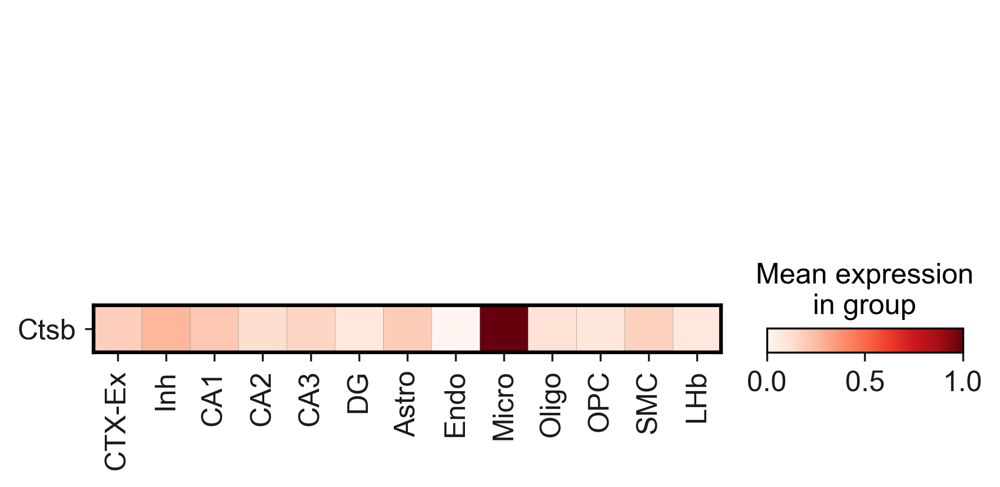

In [73]:
sc.set_figure_params(format='pdf', dpi=150)
sc.pl.matrixplot(adata, ['Ctsb'], 'top_level', dendrogram=False, cmap='Reds', swap_axes=True, layer='norm', standard_scale='var', save=f'ctsb') 